# Dominant Source Threshold Analysis

This notebook applies threshold analysis to the **dominant source relative fraction/concentration**
to test whether samples with stronger source dominance show different BC/EC regression behavior.

## Approach:
Similar to the Iron/EC ratio threshold analysis, we split data by dominance thresholds and compare:
- **Low dominance**: Samples where dominant source contributes ≤ threshold
- **High dominance**: Samples where dominant source contributes > threshold

We test this for both dominance determination methods:
1. **GF (Fraction) Method**: `dominant_gf_relative` - relative fraction from GF columns
2. **K_F (Concentration) Method**: `dominant_kf_relative` - relative concentration from K_F columns

## Analyses:
1. **Overall threshold analysis** - All samples regardless of dominant source
2. **Source-specific threshold analysis** - Separate analysis for each dominant source type

---

## Setup and Imports

In [1]:
import sys
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import warnings
warnings.filterwarnings('ignore')

# Add scripts folder to path
notebook_dir = os.path.dirname(os.path.abspath('__file__'))
scripts_path = os.path.join(notebook_dir, 'scripts')
if scripts_path not in sys.path:
    sys.path.insert(0, scripts_path)

from config import SITES, MAC_VALUE
from data_matching import (
    load_aethalometer_data,
    load_filter_data,
    add_base_filter_id,
    match_all_parameters,
    load_etad_factors_with_filter_ids,
)

# Configure matplotlib
plt.style.use('seaborn-v0_8-darkgrid')
%matplotlib inline
plt.rcParams['figure.figsize'] = (12, 8)
plt.rcParams['font.size'] = 11
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 13

# Create output directories
def setup_directories():
    dirs = {
        'plots': 'output/plots/addis_ababa/dominance_threshold_analysis',
        'data': 'output/data/addis_ababa'
    }
    for dir_path in dirs.values():
        os.makedirs(dir_path, exist_ok=True)
    return dirs

dirs = setup_directories()
print("Setup complete!")
print(f"MAC value: {MAC_VALUE} m²/g")

Setup complete!
MAC value: 10 m²/g


## Configuration

In [2]:
# Source apportionment categories
SOURCE_CATEGORIES = {
    'charcoal': {'label': 'Charcoal Burning', 'color': '#2C3E50', 'marker': 'o'},
    'wood': {'label': 'Wood Burning', 'color': '#8B4513', 'marker': 's'},
    'fossil_fuel': {'label': 'Fossil Fuel', 'color': '#7D3C98', 'marker': '^'},
    'polluted_marine': {'label': 'Polluted Marine', 'color': '#2980B9', 'marker': 'D'},
    'sea_salt': {'label': 'Sea Salt', 'color': '#1ABC9C', 'marker': 'v'},
}
SOURCE_ORDER = ['charcoal', 'wood', 'fossil_fuel', 'polluted_marine', 'sea_salt']

# Column mappings for GF (fraction) and K_F (concentration) columns
GF_COLUMNS = {
    'GF3 (Charcoal)': 'charcoal',
    'GF2 (Wood Burning)': 'wood',
    'GF5 (Fossil Fuel Combustion)': 'fossil_fuel',
    'GF4 (Polluted Marine)': 'polluted_marine',
    'GF1 (Sea Salt Mixed)': 'sea_salt',
}

KF_COLUMNS = {
    'K_F3 Charcoal (ug/m3)': 'charcoal',
    'K_F2 Wood Burning (ug/m3)': 'wood',
    'K_F5 Fossil Fuel Combustion (ug/m3)': 'fossil_fuel',
    'K_F4 Polluted Marine (ug/m3)': 'polluted_marine',
    'K_F1 Sea Salt Mixed (ug/m3)': 'sea_salt',
}

# All method pairs to analyze
METHOD_PAIRS = [
    ('ftir_ec', 'hips_fabs', 'FTIR EC (µg/m³)', 'HIPS Fabs/MAC (µg/m³)', 'hips_vs_ec'),
    ('ftir_ec', 'ir_bcc', 'FTIR EC (µg/m³)', 'Aeth IR BCc (µg/m³)', 'aeth_ir_vs_ec'),
    ('hips_fabs', 'ir_bcc', 'HIPS Fabs/MAC (µg/m³)', 'Aeth IR BCc (µg/m³)', 'aeth_ir_vs_hips'),
]

# Dominance thresholds to test (as fractions, e.g., 0.30 = 30%)
DOMINANCE_THRESHOLDS = [0.30, 0.40, 0.50, 0.60, 0.70]

print(f"Source categories: {', '.join(SOURCE_CATEGORIES.keys())}")
print(f"Method pairs to analyze: {len(METHOD_PAIRS)}")
print(f"Dominance thresholds to test: {[f'{t:.0%}' for t in DOMINANCE_THRESHOLDS]}")

Source categories: charcoal, wood, fossil_fuel, polluted_marine, sea_salt
Method pairs to analyze: 3
Dominance thresholds to test: ['30%', '40%', '50%', '60%', '70%']


## Data Loading

In [3]:
# Load factor contributions
factors_df = load_etad_factors_with_filter_ids()
print(f"Loaded factor contributions: {len(factors_df)} samples")

# Identify columns present
gf_cols_present = [col for col in GF_COLUMNS.keys() if col in factors_df.columns]
kf_cols_present = [col for col in KF_COLUMNS.keys() if col in factors_df.columns]
print(f"GF columns found: {len(gf_cols_present)}")
print(f"K_F columns found: {len(kf_cols_present)}")

ETAD factor contributions loaded: 102 records
Date range: 2023-01-03 to 2023-12-17
ETAD Filter IDs loaded: 189 filters
Date range: 2022-12-07 to 2024-09-12
Merged: 102 records (0 factor rows had no matching FilterId)
Loaded factor contributions: 102 samples
GF columns found: 5
K_F columns found: 5


In [4]:
# =============================================================================
# Calculate dominant source and relative dominance for BOTH methods
# =============================================================================

# Method 1: GF (Fraction) based
if gf_cols_present:
    factors_df['dominant_gf'] = factors_df[gf_cols_present].idxmax(axis=1)
    factors_df['dominant_source_frac'] = factors_df['dominant_gf'].map(GF_COLUMNS)
    factors_df['dominant_gf_value'] = factors_df[gf_cols_present].max(axis=1)
    gf_sum = factors_df[gf_cols_present].sum(axis=1)
    factors_df['dominant_gf_relative'] = factors_df['dominant_gf_value'] / gf_sum
    
    print("\n=== GF (Fraction) Method ===")
    print(f"Relative dominance range: {factors_df['dominant_gf_relative'].min():.1%} - {factors_df['dominant_gf_relative'].max():.1%}")
    print(f"Mean: {factors_df['dominant_gf_relative'].mean():.1%}, Median: {factors_df['dominant_gf_relative'].median():.1%}")

# Method 2: K_F (Concentration) based
if kf_cols_present:
    factors_df['dominant_kf'] = factors_df[kf_cols_present].idxmax(axis=1)
    factors_df['dominant_source_conc'] = factors_df['dominant_kf'].map(KF_COLUMNS)
    factors_df['dominant_kf_value'] = factors_df[kf_cols_present].max(axis=1)
    kf_sum = factors_df[kf_cols_present].sum(axis=1)
    factors_df['dominant_kf_relative'] = factors_df['dominant_kf_value'] / kf_sum
    
    print("\n=== K_F (Concentration) Method ===")
    print(f"Relative dominance range: {factors_df['dominant_kf_relative'].min():.1%} - {factors_df['dominant_kf_relative'].max():.1%}")
    print(f"Mean: {factors_df['dominant_kf_relative'].mean():.1%}, Median: {factors_df['dominant_kf_relative'].median():.1%}")


=== GF (Fraction) Method ===
Relative dominance range: 26.4% - 74.2%
Mean: 46.2%, Median: 45.5%

=== K_F (Concentration) Method ===
Relative dominance range: 24.0% - 87.1%
Mean: 47.8%, Median: 44.9%


In [5]:
# =============================================================================
# Load BC/EC measurements and merge
# =============================================================================
aethalometer_data = load_aethalometer_data()
filter_data = load_filter_data()
filter_data = add_base_filter_id(filter_data)

df_aeth = aethalometer_data.get('Addis_Ababa')
bc_df = match_all_parameters('Addis_Ababa', 'ETAD', df_aeth, filter_data)

# Get base_filter_id mapping
etad_filters = filter_data[filter_data['Site'] == 'ETAD'][['SampleDate', 'FilterId']].drop_duplicates()
etad_filters = etad_filters.rename(columns={'SampleDate': 'date', 'FilterId': 'base_filter_id'})
bc_df['date'] = pd.to_datetime(bc_df['date'])
etad_filters['date'] = pd.to_datetime(etad_filters['date'])
bc_with_id = pd.merge(bc_df, etad_filters, on='date', how='left')

# Merge with factor contributions
merge_cols = ['base_filter_id', 'dominant_source_frac', 'dominant_source_conc',
              'dominant_gf_value', 'dominant_kf_value', 
              'dominant_gf_relative', 'dominant_kf_relative']
merge_cols = [c for c in merge_cols if c in factors_df.columns]

df = pd.merge(bc_with_id, factors_df[merge_cols].drop_duplicates(),
              on='base_filter_id', how='inner')

print(f"\nFinal merged dataset: {len(df)} samples")
print(f"Date range: {df['date'].min().date()} to {df['date'].max().date()}")

# Check BC/EC availability
print(f"\nBC/EC availability:")
for col in ['ftir_ec', 'hips_fabs', 'ir_bcc']:
    if col in df.columns:
        n = df[col].notna().sum()
        print(f"  {col}: {n} samples")

Loaded Beijing: 590 records, 2022-02-23 to 2024-10-07
Loaded Delhi: 289 records, 2022-06-27 to 2024-07-01
Loaded JPL: 765 records, 2021-11-08 to 2024-08-14
Loaded Addis_Ababa: 515 records, 2022-12-06 to 2024-09-22

Total sites loaded: 4
Filter dataset loaded: 44493 measurements
Sites: ['CHTS' 'ETAD' 'INDH' 'USPA']
Date range: 2013-06-28 to 2024-12-08

Final merged dataset: 102 samples
Date range: 2023-01-03 to 2023-12-17

BC/EC availability:
  ftir_ec: 102 samples
  hips_fabs: 102 samples
  ir_bcc: 97 samples


---

# Threshold Analysis Functions

These functions mirror the Iron/EC threshold analysis approach.

In [6]:
def analyze_dominance_threshold_visual(df, x_col, y_col, dominance_col, threshold, 
                                        xlabel, ylabel, title_suffix="", save_path=None):
    """
    Analyze data split by dominance threshold with visualizations.
    Similar to analyze_iron_threshold_visual() but for source dominance.
    
    Parameters:
    -----------
    df : DataFrame
    x_col, y_col : str - columns for regression
    dominance_col : str - column with relative dominance values (0-1)
    threshold : float - threshold value (e.g., 0.50 for 50%)
    xlabel, ylabel : str - axis labels
    title_suffix : str - additional title text
    
    Returns:
    --------
    dict with regression statistics for low/high dominance groups
    """
    # Filter to valid data
    valid_mask = df[x_col].notna() & df[y_col].notna() & df[dominance_col].notna()
    df_valid = df[valid_mask].copy()
    
    if len(df_valid) < 5:
        print(f"Insufficient data (n={len(df_valid)})")
        return None
    
    # Split by threshold
    low_dom = df_valid[df_valid[dominance_col] <= threshold]
    high_dom = df_valid[df_valid[dominance_col] > threshold]
    
    # Calculate axis limits
    all_vals = np.concatenate([df_valid[x_col].values, df_valid[y_col].values])
    max_val = np.nanmax(all_vals) * 1.05
    
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    
    results = {'threshold': threshold}
    
    # Left: Low dominance (≤ threshold)
    ax = axes[0]
    if len(low_dom) >= 3:
        x_low = low_dom[x_col].values
        y_low = low_dom[y_col].values
        ax.scatter(x_low, y_low, c='blue', alpha=0.6, s=60, edgecolors='black', linewidth=0.5)
        
        slope, intercept, r_value, p_val, _ = stats.linregress(x_low, y_low)
        x_line = np.array([0, max_val])
        ax.plot(x_line, slope * x_line + intercept, 'b-', linewidth=2)
        ax.plot([0, max_val], [0, max_val], 'k--', alpha=0.5, linewidth=1.5)
        
        results['low'] = {'n': len(x_low), 'r2': r_value**2, 'slope': slope, 'intercept': intercept, 'p_value': p_val}
        sig = '***' if p_val < 0.001 else '**' if p_val < 0.01 else '*' if p_val < 0.05 else 'ns'
        ax.text(0.05, 0.95, f"n={len(x_low)}\nR²={r_value**2:.3f} ({sig})\nslope={slope:.3f}",
                transform=ax.transAxes, fontsize=10, va='top',
                bbox=dict(boxstyle='round', facecolor='lightblue', alpha=0.9))
    else:
        results['low'] = {'n': len(low_dom), 'r2': np.nan, 'slope': np.nan}
        ax.text(0.5, 0.5, f'n={len(low_dom)}\nInsufficient data', transform=ax.transAxes,
                ha='center', va='center', fontsize=12)
    
    ax.set_xlim(0, max_val)
    ax.set_ylim(0, max_val)
    ax.set_xlabel(xlabel, fontsize=10)
    ax.set_ylabel(ylabel, fontsize=10)
    ax.set_title(f'LOW Dominance (≤{threshold:.0%})\nn={len(low_dom)}', fontweight='bold')
    ax.set_aspect('equal', adjustable='box')
    ax.grid(True, alpha=0.3)
    
    # Middle: High dominance (> threshold)
    ax = axes[1]
    if len(high_dom) >= 3:
        x_high = high_dom[x_col].values
        y_high = high_dom[y_col].values
        ax.scatter(x_high, y_high, c='red', alpha=0.6, s=60, edgecolors='black', linewidth=0.5)
        
        slope, intercept, r_value, p_val, _ = stats.linregress(x_high, y_high)
        x_line = np.array([0, max_val])
        ax.plot(x_line, slope * x_line + intercept, 'r-', linewidth=2)
        ax.plot([0, max_val], [0, max_val], 'k--', alpha=0.5, linewidth=1.5)
        
        results['high'] = {'n': len(x_high), 'r2': r_value**2, 'slope': slope, 'intercept': intercept, 'p_value': p_val}
        sig = '***' if p_val < 0.001 else '**' if p_val < 0.01 else '*' if p_val < 0.05 else 'ns'
        ax.text(0.05, 0.95, f"n={len(x_high)}\nR²={r_value**2:.3f} ({sig})\nslope={slope:.3f}",
                transform=ax.transAxes, fontsize=10, va='top',
                bbox=dict(boxstyle='round', facecolor='lightcoral', alpha=0.9))
    else:
        results['high'] = {'n': len(high_dom), 'r2': np.nan, 'slope': np.nan}
        ax.text(0.5, 0.5, f'n={len(high_dom)}\nInsufficient data', transform=ax.transAxes,
                ha='center', va='center', fontsize=12)
    
    ax.set_xlim(0, max_val)
    ax.set_ylim(0, max_val)
    ax.set_xlabel(xlabel, fontsize=10)
    ax.set_ylabel(ylabel, fontsize=10)
    ax.set_title(f'HIGH Dominance (>{threshold:.0%})\nn={len(high_dom)}', fontweight='bold')
    ax.set_aspect('equal', adjustable='box')
    ax.grid(True, alpha=0.3)
    
    # Right: Residual vs Dominance
    ax = axes[2]
    residual = df_valid[y_col] - df_valid[x_col]
    ax.scatter(df_valid[dominance_col] * 100, residual, c='gray', alpha=0.6, s=60, 
               edgecolors='black', linewidth=0.5)
    ax.axhline(y=0, color='black', linestyle='-', linewidth=1)
    ax.axvline(x=threshold * 100, color='red', linestyle='--', linewidth=2, 
               label=f'Threshold={threshold:.0%}')
    
    # Correlation
    corr, p_val = stats.pearsonr(df_valid[dominance_col], residual)
    results['residual_corr'] = corr
    results['residual_p'] = p_val
    sig = '***' if p_val < 0.001 else '**' if p_val < 0.01 else '*' if p_val < 0.05 else 'ns'
    ax.text(0.05, 0.95, f"Pearson r={corr:.3f} ({sig})\np={p_val:.3e}",
            transform=ax.transAxes, fontsize=10, va='top',
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.9))
    
    ax.set_xlabel('Dominance (%)', fontsize=10)
    ax.set_ylabel(f'Residual ({ylabel.split(" ")[0]} - {xlabel.split(" ")[0]})', fontsize=10)
    ax.set_title('Residual vs Dominance', fontweight='bold')
    ax.legend(loc='upper right', fontsize=9)
    ax.grid(True, alpha=0.3)
    
    plt.suptitle(f'Dominance Threshold = {threshold:.0%}{title_suffix}', fontsize=14, fontweight='bold', y=1.02)
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=150, bbox_inches='tight')
    
    plt.show()
    
    return results


def run_threshold_sweep(df, x_col, y_col, dominance_col, thresholds, xlabel, ylabel, method_name, save_dir=None):
    """
    Run threshold analysis across multiple thresholds and summarize results.
    """
    all_results = {}
    
    for threshold in thresholds:
        print(f"\n--- Threshold: {threshold:.0%} ---")
        save_path = None
        if save_dir:
            save_path = os.path.join(save_dir, f'threshold_{int(threshold*100)}pct_{method_name}.png')
        
        results = analyze_dominance_threshold_visual(
            df, x_col, y_col, dominance_col, threshold,
            xlabel, ylabel, 
            title_suffix=f' — {method_name}',
            save_path=save_path
        )
        if results:
            all_results[threshold] = results
    
    return all_results


def print_threshold_summary(results_dict, title):
    """
    Print summary table for threshold analysis results.
    """
    print("\n" + "=" * 100)
    print(title)
    print("=" * 100)
    print(f"{'Threshold':<12s} {'Low n':<8s} {'Low R²':<10s} {'Low Slope':<12s} "
          f"{'High n':<8s} {'High R²':<10s} {'High Slope':<12s} {'ΔR²':<10s}")
    print("-" * 100)
    
    for threshold, results in sorted(results_dict.items()):
        low = results.get('low', {})
        high = results.get('high', {})
        
        low_r2 = low.get('r2', np.nan)
        high_r2 = high.get('r2', np.nan)
        delta_r2 = low_r2 - high_r2 if not (np.isnan(low_r2) or np.isnan(high_r2)) else np.nan
        
        thresh_str = f"{threshold:.0%}"
        print(f"{thresh_str:<12s} {low.get('n', 0):<8d} {low_r2:<10.3f} {low.get('slope', np.nan):<12.3f} "
              f"{high.get('n', 0):<8d} {high_r2:<10.3f} {high.get('slope', np.nan):<12.3f} {delta_r2:<+10.3f}")

---

# Dominance Statistics Overview

DOMINANCE DISTRIBUTION OVERVIEW


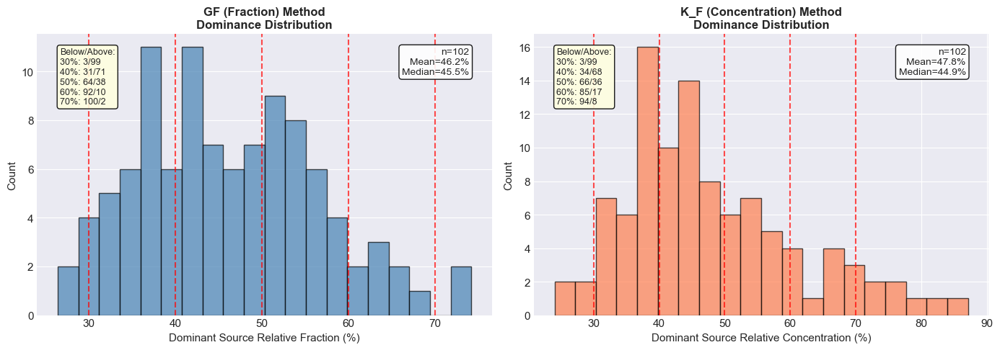

In [7]:
print("=" * 80)
print("DOMINANCE DISTRIBUTION OVERVIEW")
print("=" * 80)

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# GF Method distribution
ax = axes[0]
if 'dominant_gf_relative' in df.columns:
    valid = df['dominant_gf_relative'].dropna() * 100
    ax.hist(valid, bins=20, color='steelblue', edgecolor='black', alpha=0.7)
    for thresh in DOMINANCE_THRESHOLDS:
        ax.axvline(x=thresh * 100, color='red', linestyle='--', alpha=0.7, 
                   label=f'{thresh:.0%}' if thresh == DOMINANCE_THRESHOLDS[0] else '')
    ax.set_xlabel('Dominant Source Relative Fraction (%)', fontsize=11)
    ax.set_ylabel('Count', fontsize=11)
    ax.set_title('GF (Fraction) Method\nDominance Distribution', fontsize=12, fontweight='bold')
    ax.text(0.95, 0.95, f'n={len(valid)}\nMean={valid.mean():.1f}%\nMedian={valid.median():.1f}%',
            transform=ax.transAxes, fontsize=10, va='top', ha='right',
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.9))
    
    # Add counts above/below each threshold
    thresh_text = []
    for thresh in DOMINANCE_THRESHOLDS:
        n_below = (valid <= thresh * 100).sum()
        n_above = (valid > thresh * 100).sum()
        thresh_text.append(f'{thresh:.0%}: {n_below}/{n_above}')
    ax.text(0.05, 0.95, 'Below/Above:\n' + '\n'.join(thresh_text),
            transform=ax.transAxes, fontsize=9, va='top',
            bbox=dict(boxstyle='round', facecolor='lightyellow', alpha=0.9))

# K_F Method distribution
ax = axes[1]
if 'dominant_kf_relative' in df.columns:
    valid = df['dominant_kf_relative'].dropna() * 100
    ax.hist(valid, bins=20, color='coral', edgecolor='black', alpha=0.7)
    for thresh in DOMINANCE_THRESHOLDS:
        ax.axvline(x=thresh * 100, color='red', linestyle='--', alpha=0.7)
    ax.set_xlabel('Dominant Source Relative Concentration (%)', fontsize=11)
    ax.set_ylabel('Count', fontsize=11)
    ax.set_title('K_F (Concentration) Method\nDominance Distribution', fontsize=12, fontweight='bold')
    ax.text(0.95, 0.95, f'n={len(valid)}\nMean={valid.mean():.1f}%\nMedian={valid.median():.1f}%',
            transform=ax.transAxes, fontsize=10, va='top', ha='right',
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.9))
    
    # Add counts above/below each threshold
    thresh_text = []
    for thresh in DOMINANCE_THRESHOLDS:
        n_below = (valid <= thresh * 100).sum()
        n_above = (valid > thresh * 100).sum()
        thresh_text.append(f'{thresh:.0%}: {n_below}/{n_above}')
    ax.text(0.05, 0.95, 'Below/Above:\n' + '\n'.join(thresh_text),
            transform=ax.transAxes, fontsize=9, va='top',
            bbox=dict(boxstyle='round', facecolor='lightyellow', alpha=0.9))

plt.tight_layout()
plt.savefig(os.path.join(dirs['plots'], 'dominance_distribution_overview.png'), dpi=150, bbox_inches='tight')
plt.show()

---

# PART 1: Overall Threshold Analysis (All Samples)

## GF (Fraction) Method — All Samples

GF (FRACTION) METHOD — OVERALL DOMINANCE THRESHOLD ANALYSIS

  HIPS Fabs/MAC vs FTIR EC — GF (Fraction) Method

--- Threshold: 30% ---


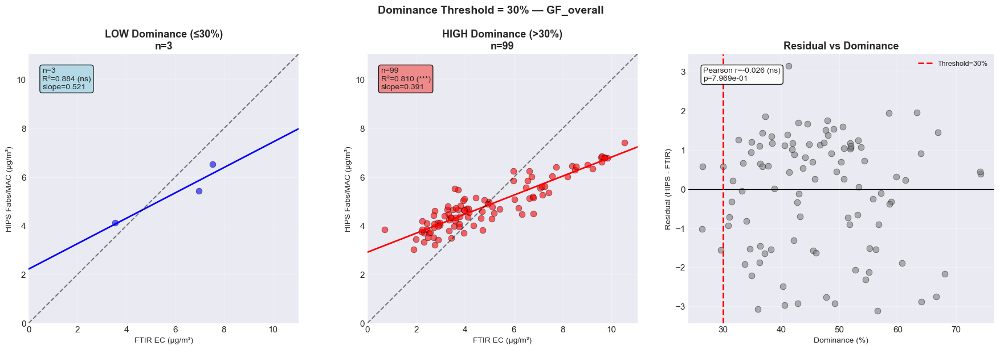


--- Threshold: 40% ---


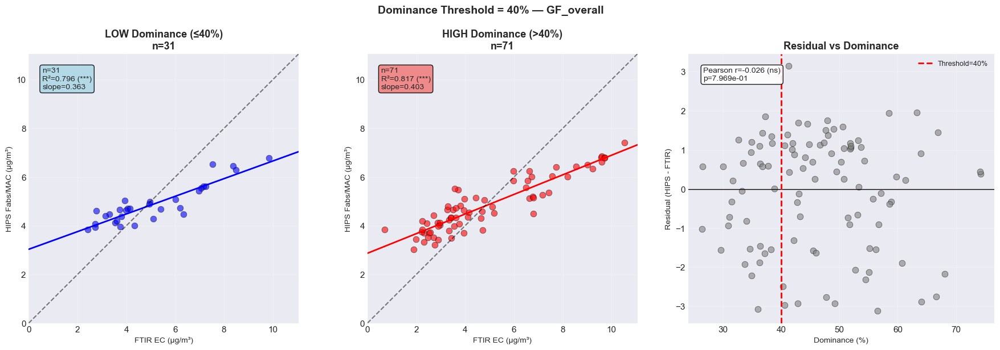


--- Threshold: 50% ---


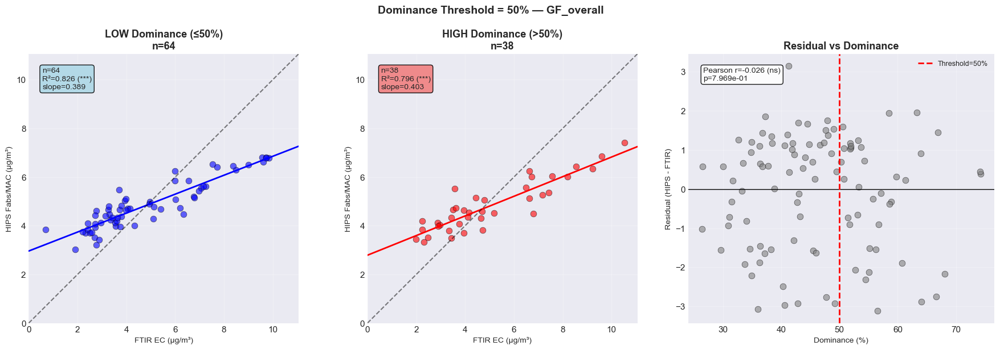


--- Threshold: 60% ---


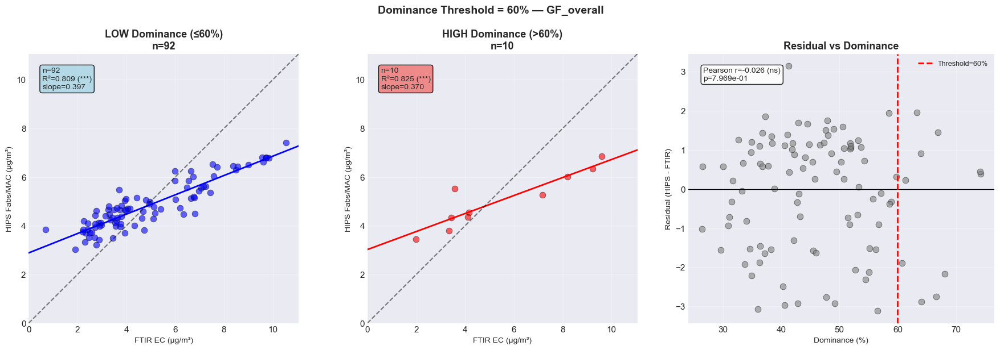


--- Threshold: 70% ---


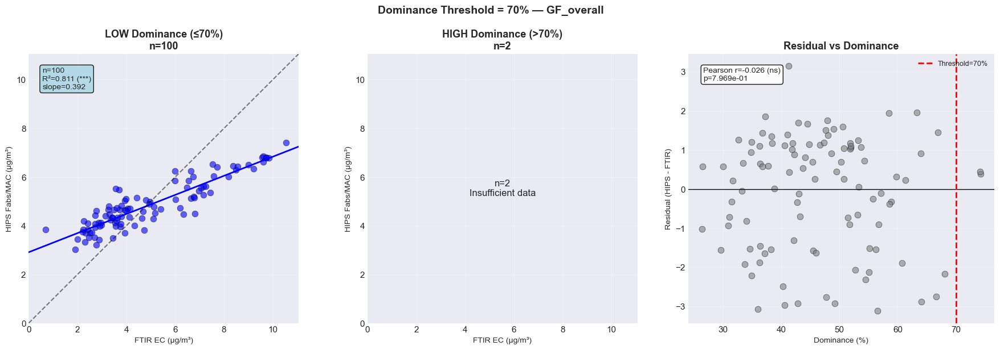


SUMMARY: HIPS Fabs/MAC vs FTIR EC — GF Method (Overall)
Threshold    Low n    Low R²     Low Slope    High n   High R²    High Slope   ΔR²       
----------------------------------------------------------------------------------------------------
30%          3        0.884      0.521        99       0.810      0.391        +0.074    
40%          31       0.796      0.363        71       0.817      0.403        -0.021    
50%          64       0.826      0.389        38       0.796      0.403        +0.030    
60%          92       0.809      0.397        10       0.825      0.370        -0.016    
70%          100      0.811      0.392        2        nan        nan          +nan      

  Aeth IR BCc vs FTIR EC — GF (Fraction) Method

--- Threshold: 30% ---


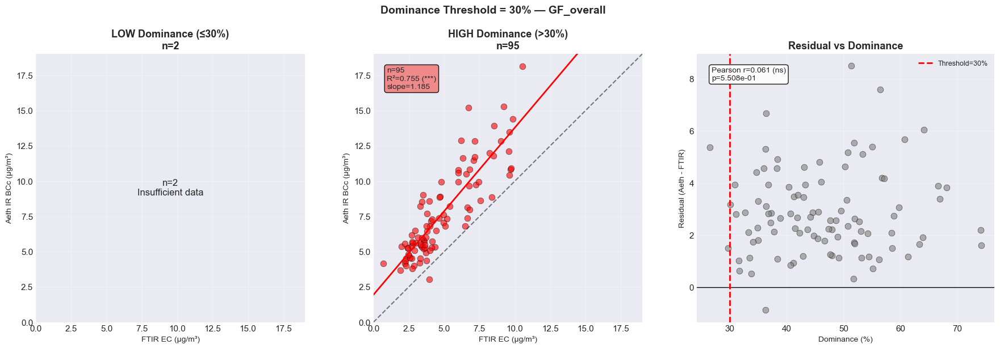


--- Threshold: 40% ---


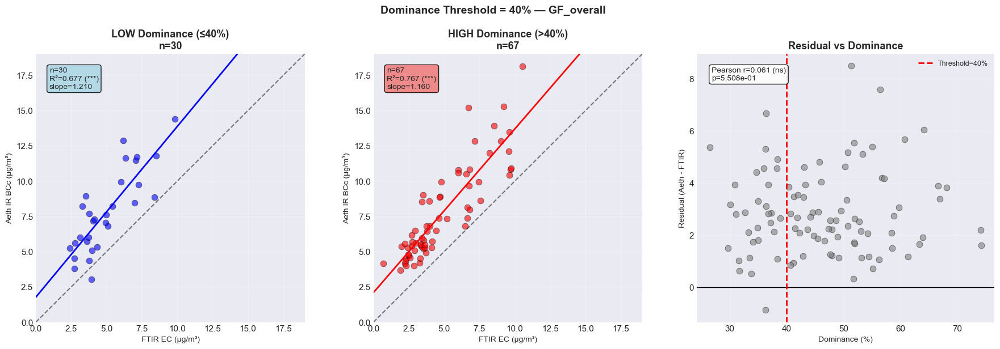


--- Threshold: 50% ---


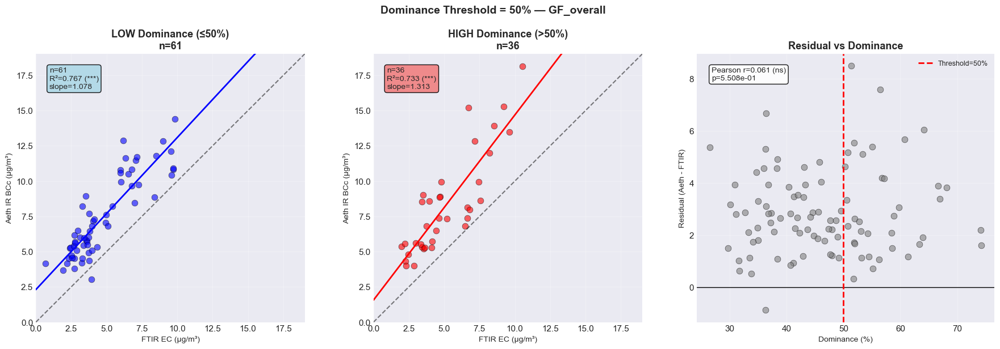


--- Threshold: 60% ---


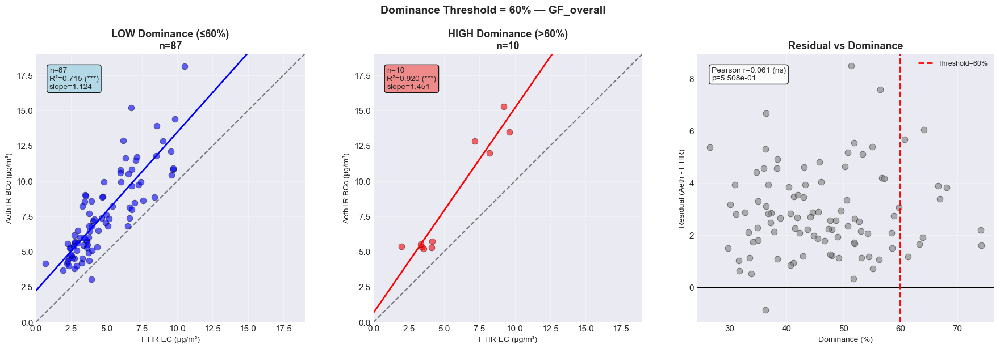


--- Threshold: 70% ---


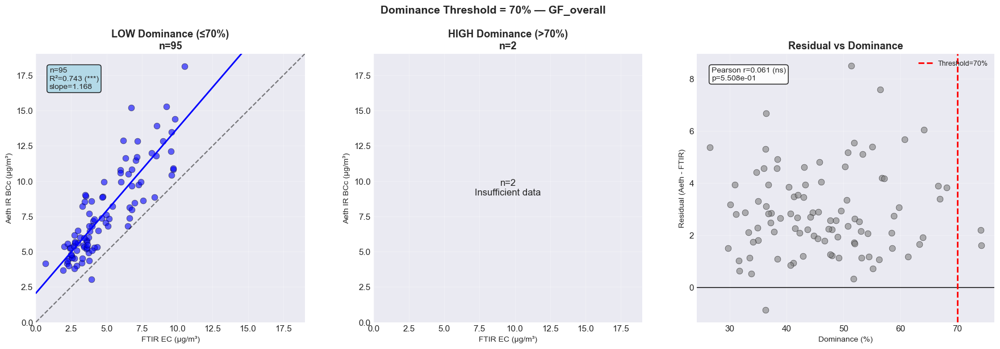


SUMMARY: Aeth IR BCc vs FTIR EC — GF Method (Overall)
Threshold    Low n    Low R²     Low Slope    High n   High R²    High Slope   ΔR²       
----------------------------------------------------------------------------------------------------
30%          2        nan        nan          95       0.755      1.185        +nan      
40%          30       0.677      1.210        67       0.767      1.160        -0.090    
50%          61       0.767      1.078        36       0.733      1.313        +0.034    
60%          87       0.715      1.124        10       0.920      1.451        -0.205    
70%          95       0.743      1.168        2        nan        nan          +nan      

  Aeth IR BCc vs HIPS Fabs/MAC — GF (Fraction) Method

--- Threshold: 30% ---


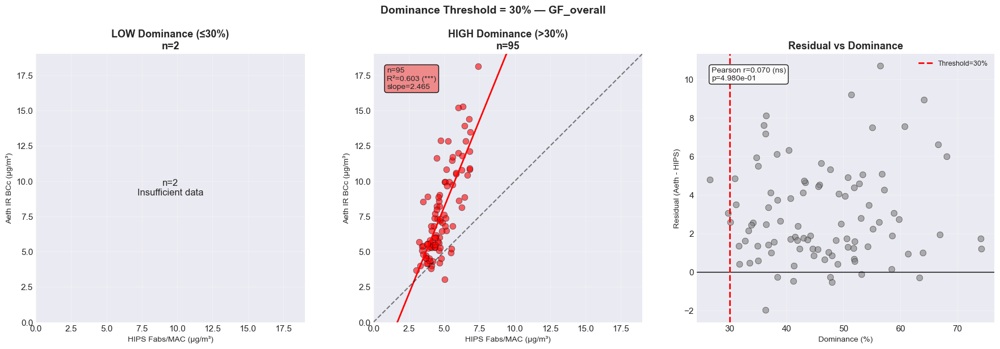


--- Threshold: 40% ---


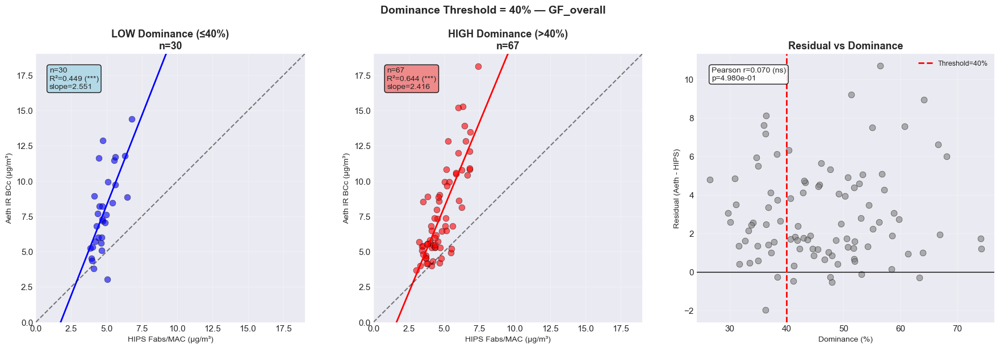


--- Threshold: 50% ---


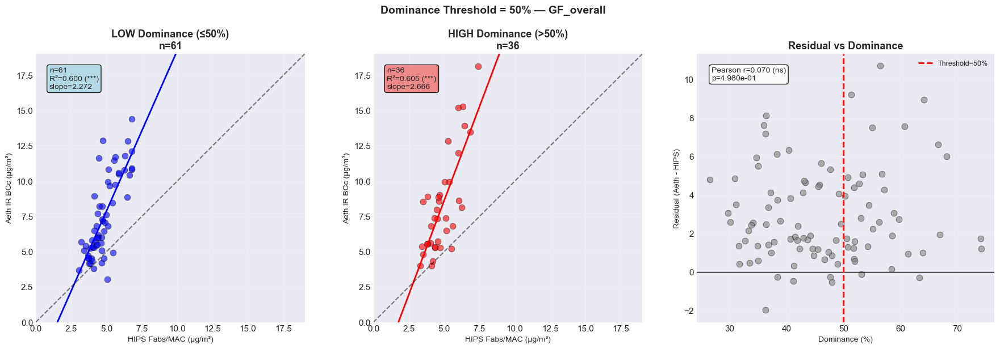


--- Threshold: 60% ---


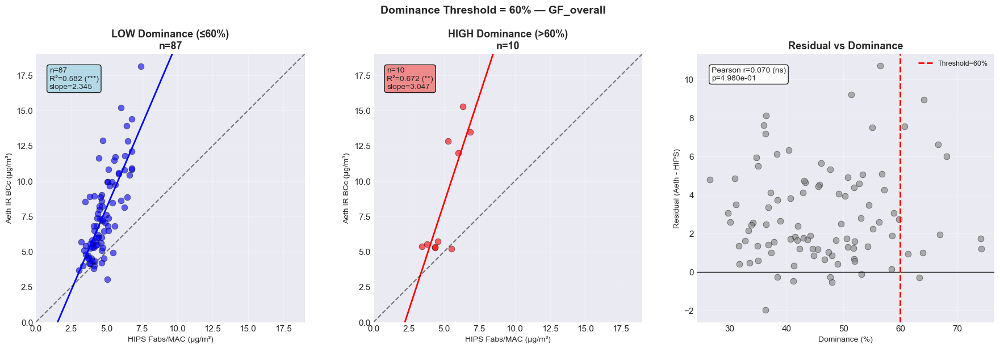


--- Threshold: 70% ---


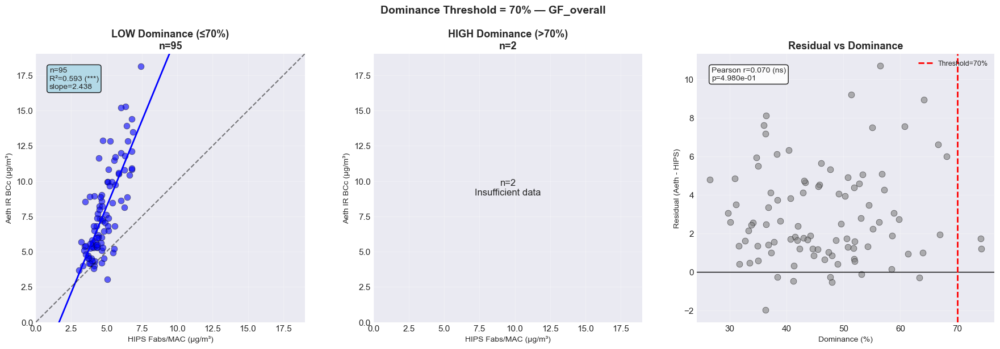


SUMMARY: Aeth IR BCc vs HIPS Fabs/MAC — GF Method (Overall)
Threshold    Low n    Low R²     Low Slope    High n   High R²    High Slope   ΔR²       
----------------------------------------------------------------------------------------------------
30%          2        nan        nan          95       0.603      2.465        +nan      
40%          30       0.449      2.551        67       0.644      2.416        -0.194    
50%          61       0.600      2.272        36       0.605      2.666        -0.005    
60%          87       0.582      2.345        10       0.672      3.047        -0.090    
70%          95       0.593      2.438        2        nan        nan          +nan      


In [8]:
print("=" * 80)
print("GF (FRACTION) METHOD — OVERALL DOMINANCE THRESHOLD ANALYSIS")
print("=" * 80)

gf_threshold_results = {}

for x_col, y_col, x_label, y_label, prefix in METHOD_PAIRS:
    pair_label = f'{y_label.split(" (")[0]} vs {x_label.split(" (")[0]}'
    
    print(f"\n{'='*80}")
    print(f"  {pair_label} — GF (Fraction) Method")
    print(f"{'='*80}")
    
    results = run_threshold_sweep(
        df, x_col, y_col, 'dominant_gf_relative', DOMINANCE_THRESHOLDS,
        x_label, y_label, 'GF_overall'
    )
    
    gf_threshold_results[prefix] = results
    
    # Print summary
    print_threshold_summary(results, f"SUMMARY: {pair_label} — GF Method (Overall)")

## K_F (Concentration) Method — All Samples

K_F (CONCENTRATION) METHOD — OVERALL DOMINANCE THRESHOLD ANALYSIS

  HIPS Fabs/MAC vs FTIR EC — K_F (Concentration) Method

--- Threshold: 30% ---


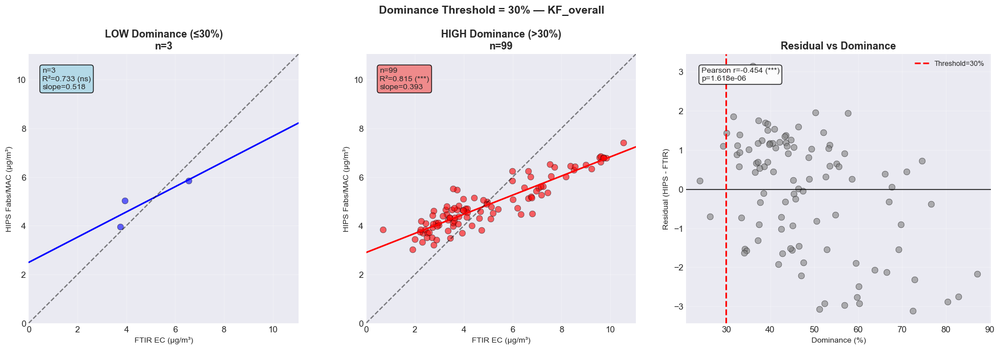


--- Threshold: 40% ---


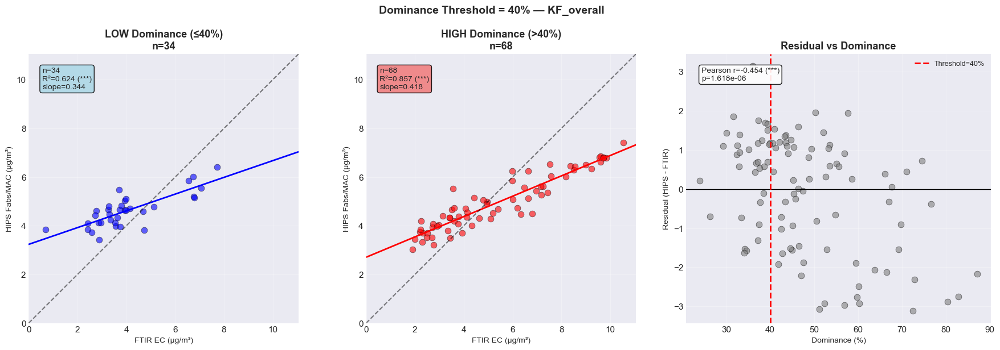


--- Threshold: 50% ---


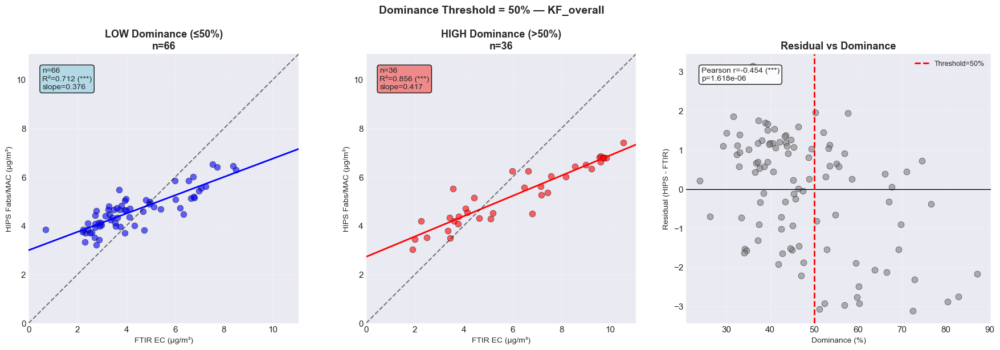


--- Threshold: 60% ---


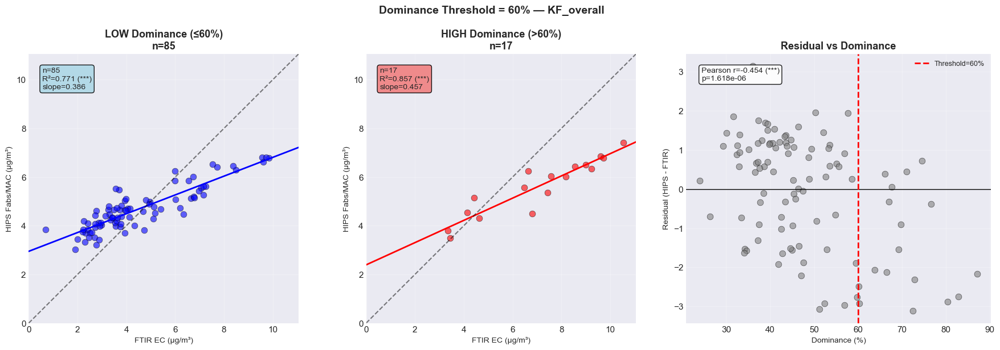


--- Threshold: 70% ---


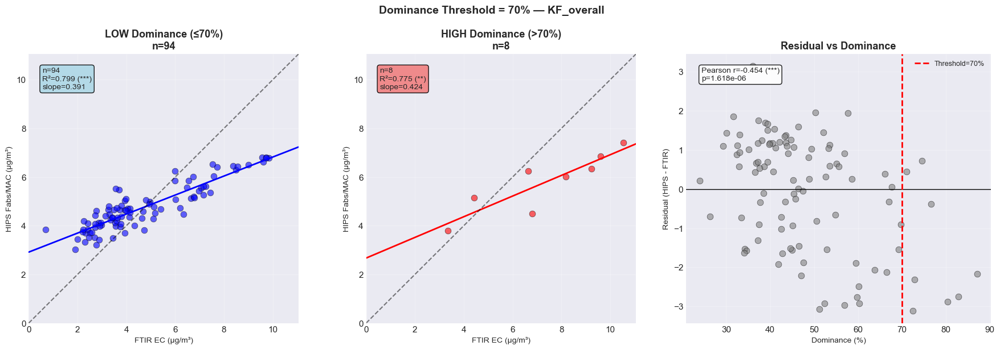


SUMMARY: HIPS Fabs/MAC vs FTIR EC — K_F Method (Overall)
Threshold    Low n    Low R²     Low Slope    High n   High R²    High Slope   ΔR²       
----------------------------------------------------------------------------------------------------
30%          3        0.733      0.518        99       0.815      0.393        -0.081    
40%          34       0.624      0.344        68       0.857      0.418        -0.233    
50%          66       0.712      0.376        36       0.856      0.417        -0.144    
60%          85       0.771      0.386        17       0.857      0.457        -0.086    
70%          94       0.799      0.391        8        0.775      0.424        +0.025    

  Aeth IR BCc vs FTIR EC — K_F (Concentration) Method

--- Threshold: 30% ---


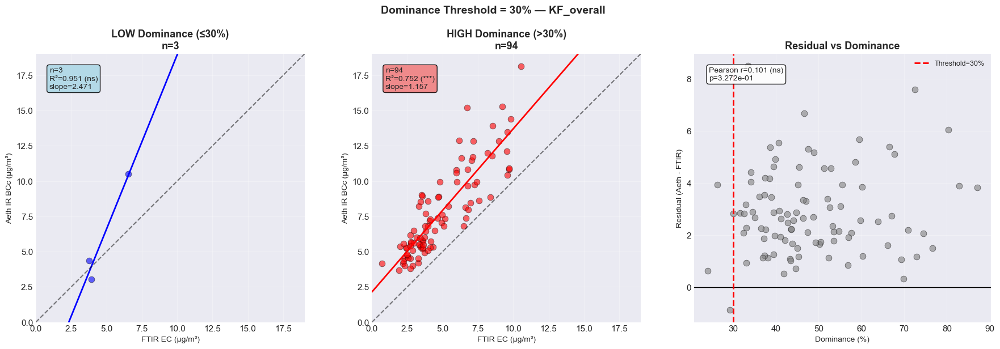


--- Threshold: 40% ---


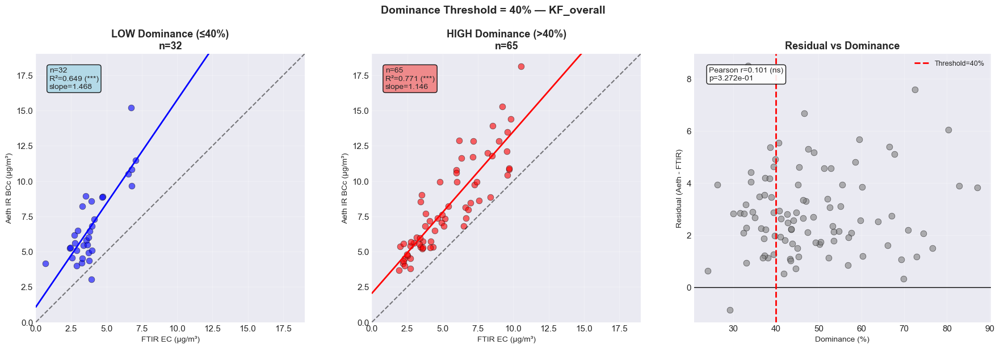


--- Threshold: 50% ---


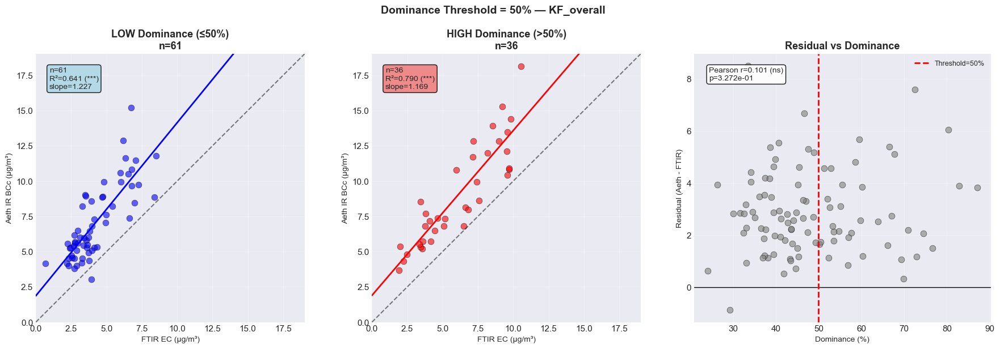


--- Threshold: 60% ---


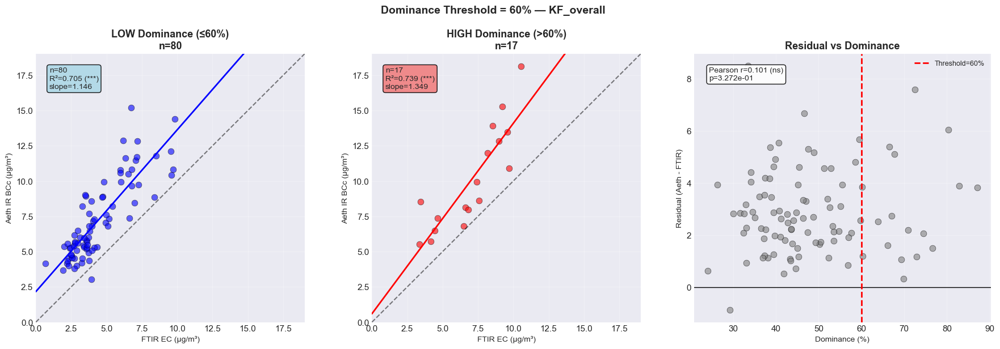


--- Threshold: 70% ---


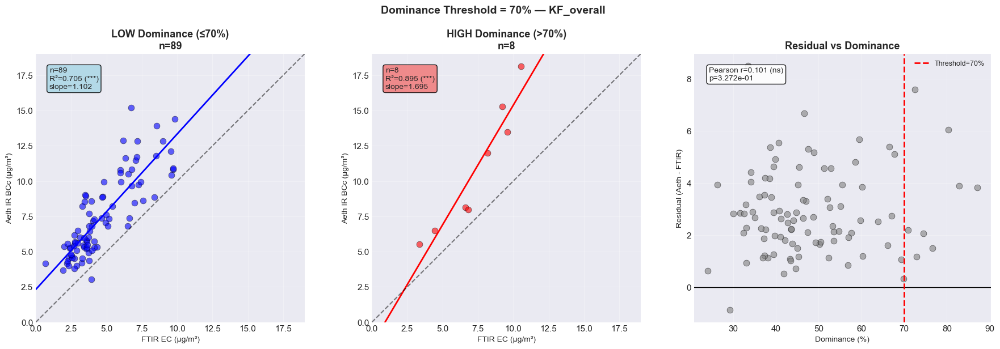


SUMMARY: Aeth IR BCc vs FTIR EC — K_F Method (Overall)
Threshold    Low n    Low R²     Low Slope    High n   High R²    High Slope   ΔR²       
----------------------------------------------------------------------------------------------------
30%          3        0.951      2.471        94       0.752      1.157        +0.198    
40%          32       0.649      1.468        65       0.771      1.146        -0.122    
50%          61       0.641      1.227        36       0.790      1.169        -0.149    
60%          80       0.705      1.146        17       0.739      1.349        -0.034    
70%          89       0.705      1.102        8        0.895      1.695        -0.190    

  Aeth IR BCc vs HIPS Fabs/MAC — K_F (Concentration) Method

--- Threshold: 30% ---


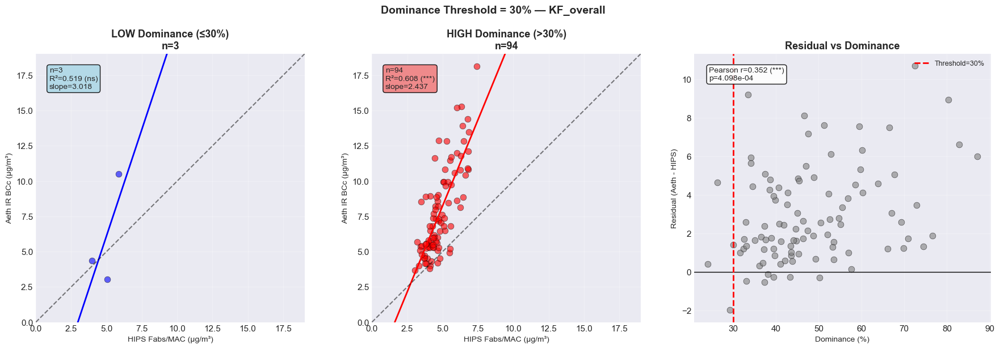


--- Threshold: 40% ---


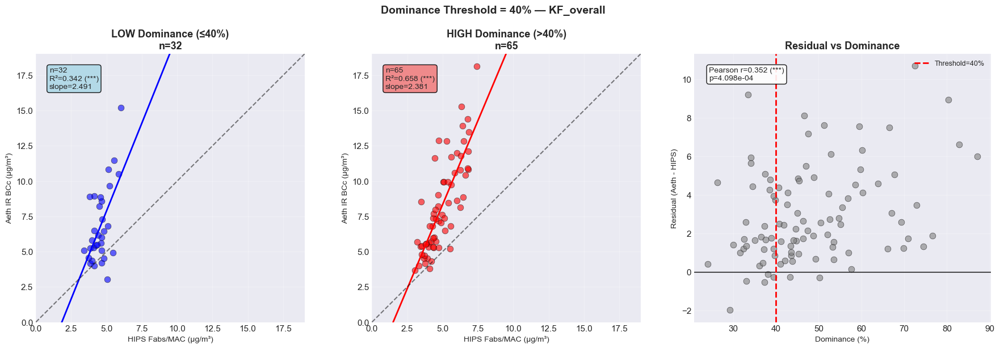


--- Threshold: 50% ---


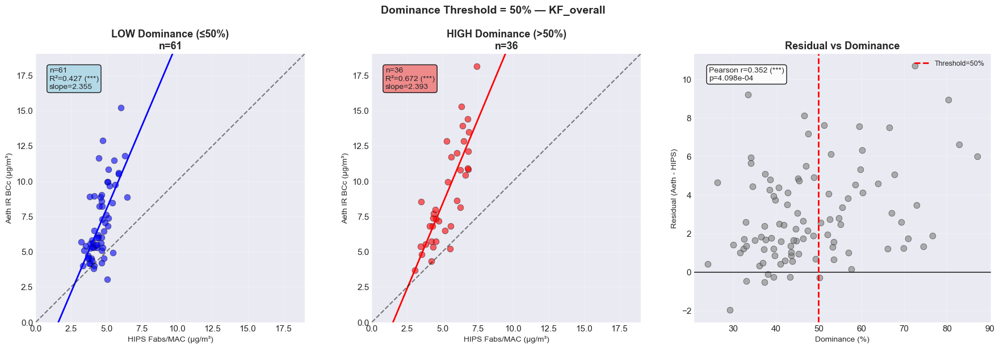


--- Threshold: 60% ---


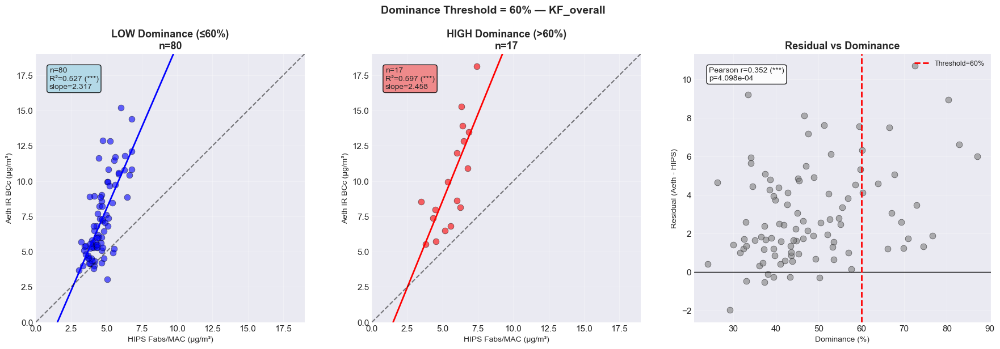


--- Threshold: 70% ---


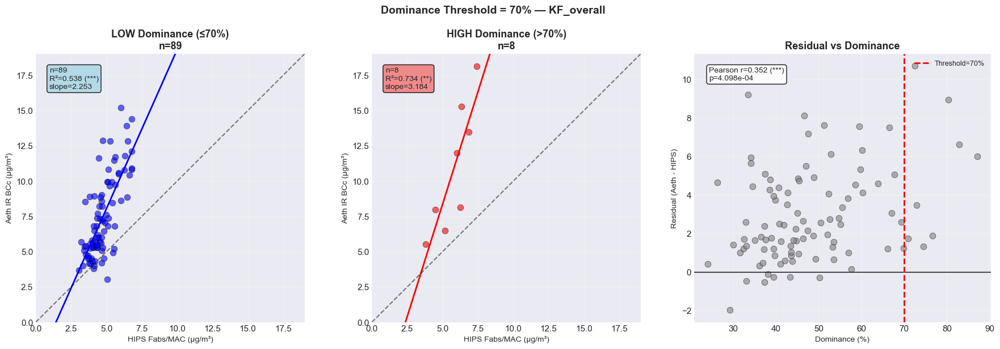


SUMMARY: Aeth IR BCc vs HIPS Fabs/MAC — K_F Method (Overall)
Threshold    Low n    Low R²     Low Slope    High n   High R²    High Slope   ΔR²       
----------------------------------------------------------------------------------------------------
30%          3        0.519      3.018        94       0.608      2.437        -0.089    
40%          32       0.342      2.491        65       0.658      2.381        -0.316    
50%          61       0.427      2.355        36       0.672      2.393        -0.245    
60%          80       0.527      2.317        17       0.597      2.458        -0.070    
70%          89       0.538      2.253        8        0.734      3.184        -0.197    


In [9]:
print("=" * 80)
print("K_F (CONCENTRATION) METHOD — OVERALL DOMINANCE THRESHOLD ANALYSIS")
print("=" * 80)

kf_threshold_results = {}

for x_col, y_col, x_label, y_label, prefix in METHOD_PAIRS:
    pair_label = f'{y_label.split(" (")[0]} vs {x_label.split(" (")[0]}'
    
    print(f"\n{'='*80}")
    print(f"  {pair_label} — K_F (Concentration) Method")
    print(f"{'='*80}")
    
    results = run_threshold_sweep(
        df, x_col, y_col, 'dominant_kf_relative', DOMINANCE_THRESHOLDS,
        x_label, y_label, 'KF_overall'
    )
    
    kf_threshold_results[prefix] = results
    
    # Print summary
    print_threshold_summary(results, f"SUMMARY: {pair_label} — K_F Method (Overall)")

---

# PART 2: Source-Specific Threshold Analysis

Analyze threshold effects **within each dominant source category** (charcoal, wood, fossil fuel, etc.)

This tells us if the dominance threshold effect is consistent across different source types, or if certain sources show stronger effects.

In [10]:
def analyze_threshold_for_source(df, x_col, y_col, dominance_col, source_col, 
                                  source, threshold, xlabel, ylabel):
    """
    Analyze threshold for a specific dominant source.
    Returns regression statistics for low/high dominance within that source.
    """
    # Filter to specific dominant source
    source_mask = df[source_col] == source
    df_source = df[source_mask].copy()
    
    # Filter to valid data
    valid_mask = df_source[x_col].notna() & df_source[y_col].notna() & df_source[dominance_col].notna()
    df_valid = df_source[valid_mask]
    
    if len(df_valid) < 5:
        return None
    
    # Split by threshold
    low_dom = df_valid[df_valid[dominance_col] <= threshold]
    high_dom = df_valid[df_valid[dominance_col] > threshold]
    
    results = {
        'source': source,
        'threshold': threshold,
        'total_n': len(df_valid)
    }
    
    # Low dominance
    if len(low_dom) >= 3:
        x, y = low_dom[x_col].values, low_dom[y_col].values
        slope, intercept, r, p, _ = stats.linregress(x, y)
        results['low'] = {'n': len(x), 'r2': r**2, 'slope': slope, 'intercept': intercept, 'p_value': p}
    else:
        results['low'] = {'n': len(low_dom), 'r2': np.nan, 'slope': np.nan}
    
    # High dominance
    if len(high_dom) >= 3:
        x, y = high_dom[x_col].values, high_dom[y_col].values
        slope, intercept, r, p, _ = stats.linregress(x, y)
        results['high'] = {'n': len(x), 'r2': r**2, 'slope': slope, 'intercept': intercept, 'p_value': p}
    else:
        results['high'] = {'n': len(high_dom), 'r2': np.nan, 'slope': np.nan}
    
    return results


def analyze_threshold_visual_for_source(df, x_col, y_col, dominance_col, source_col,
                                         source, threshold, xlabel, ylabel, method_name):
    """
    Create visual threshold analysis for a specific source.
    """
    # Filter to specific dominant source
    source_mask = df[source_col] == source
    df_source = df[source_mask].copy()
    
    # Filter to valid data
    valid_mask = df_source[x_col].notna() & df_source[y_col].notna() & df_source[dominance_col].notna()
    df_valid = df_source[valid_mask].copy()
    
    if len(df_valid) < 5:
        print(f"  {SOURCE_CATEGORIES[source]['label']}: Insufficient data (n={len(df_valid)})")
        return None
    
    # Split by threshold
    low_dom = df_valid[df_valid[dominance_col] <= threshold]
    high_dom = df_valid[df_valid[dominance_col] > threshold]
    
    # Calculate axis limits
    all_vals = np.concatenate([df_valid[x_col].values, df_valid[y_col].values])
    max_val = np.nanmax(all_vals) * 1.05
    
    source_color = SOURCE_CATEGORIES[source]['color']
    source_label = SOURCE_CATEGORIES[source]['label']
    
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    
    results = {'threshold': threshold, 'source': source}
    
    # Left: Low dominance
    ax = axes[0]
    if len(low_dom) >= 3:
        x_low = low_dom[x_col].values
        y_low = low_dom[y_col].values
        ax.scatter(x_low, y_low, c=source_color, alpha=0.6, s=60, edgecolors='black', linewidth=0.5)
        
        slope, intercept, r_value, p_val, _ = stats.linregress(x_low, y_low)
        x_line = np.array([0, max_val])
        ax.plot(x_line, slope * x_line + intercept, color=source_color, linewidth=2)
        ax.plot([0, max_val], [0, max_val], 'k--', alpha=0.5, linewidth=1.5)
        
        results['low'] = {'n': len(x_low), 'r2': r_value**2, 'slope': slope, 'p_value': p_val}
        sig = '***' if p_val < 0.001 else '**' if p_val < 0.01 else '*' if p_val < 0.05 else 'ns'
        ax.text(0.05, 0.95, f"n={len(x_low)}\nR²={r_value**2:.3f} ({sig})\nslope={slope:.3f}",
                transform=ax.transAxes, fontsize=10, va='top',
                bbox=dict(boxstyle='round', facecolor='lightblue', alpha=0.9))
    else:
        results['low'] = {'n': len(low_dom), 'r2': np.nan, 'slope': np.nan}
        ax.text(0.5, 0.5, f'n={len(low_dom)}\nInsufficient data', transform=ax.transAxes,
                ha='center', va='center', fontsize=12)
    
    ax.set_xlim(0, max_val)
    ax.set_ylim(0, max_val)
    ax.set_xlabel(xlabel, fontsize=10)
    ax.set_ylabel(ylabel, fontsize=10)
    ax.set_title(f'LOW Dominance (≤{threshold:.0%})\nn={len(low_dom)}', fontweight='bold')
    ax.set_aspect('equal', adjustable='box')
    ax.grid(True, alpha=0.3)
    
    # Middle: High dominance
    ax = axes[1]
    if len(high_dom) >= 3:
        x_high = high_dom[x_col].values
        y_high = high_dom[y_col].values
        ax.scatter(x_high, y_high, c=source_color, alpha=0.6, s=60, edgecolors='black', linewidth=0.5)
        
        slope, intercept, r_value, p_val, _ = stats.linregress(x_high, y_high)
        x_line = np.array([0, max_val])
        ax.plot(x_line, slope * x_line + intercept, color=source_color, linewidth=2)
        ax.plot([0, max_val], [0, max_val], 'k--', alpha=0.5, linewidth=1.5)
        
        results['high'] = {'n': len(x_high), 'r2': r_value**2, 'slope': slope, 'p_value': p_val}
        sig = '***' if p_val < 0.001 else '**' if p_val < 0.01 else '*' if p_val < 0.05 else 'ns'
        ax.text(0.05, 0.95, f"n={len(x_high)}\nR²={r_value**2:.3f} ({sig})\nslope={slope:.3f}",
                transform=ax.transAxes, fontsize=10, va='top',
                bbox=dict(boxstyle='round', facecolor='lightcoral', alpha=0.9))
    else:
        results['high'] = {'n': len(high_dom), 'r2': np.nan, 'slope': np.nan}
        ax.text(0.5, 0.5, f'n={len(high_dom)}\nInsufficient data', transform=ax.transAxes,
                ha='center', va='center', fontsize=12)
    
    ax.set_xlim(0, max_val)
    ax.set_ylim(0, max_val)
    ax.set_xlabel(xlabel, fontsize=10)
    ax.set_ylabel(ylabel, fontsize=10)
    ax.set_title(f'HIGH Dominance (>{threshold:.0%})\nn={len(high_dom)}', fontweight='bold')
    ax.set_aspect('equal', adjustable='box')
    ax.grid(True, alpha=0.3)
    
    # Right: Residual vs Dominance
    ax = axes[2]
    residual = df_valid[y_col] - df_valid[x_col]
    ax.scatter(df_valid[dominance_col] * 100, residual, c=source_color, alpha=0.6, s=60,
               edgecolors='black', linewidth=0.5)
    ax.axhline(y=0, color='black', linestyle='-', linewidth=1)
    ax.axvline(x=threshold * 100, color='red', linestyle='--', linewidth=2)
    
    if len(df_valid) >= 3:
        corr, p_val = stats.pearsonr(df_valid[dominance_col], residual)
        results['residual_corr'] = corr
        results['residual_p'] = p_val
        sig = '***' if p_val < 0.001 else '**' if p_val < 0.01 else '*' if p_val < 0.05 else 'ns'
        ax.text(0.05, 0.95, f"Pearson r={corr:.3f} ({sig})\np={p_val:.3e}",
                transform=ax.transAxes, fontsize=10, va='top',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.9))
    
    ax.set_xlabel('Dominance (%)', fontsize=10)
    ax.set_ylabel(f'Residual', fontsize=10)
    ax.set_title('Residual vs Dominance', fontweight='bold')
    ax.grid(True, alpha=0.3)
    
    plt.suptitle(f'{source_label} — Threshold = {threshold:.0%} ({method_name})', 
                 fontsize=14, fontweight='bold', color=source_color, y=1.02)
    plt.tight_layout()
    plt.show()
    
    return results

## Source-Specific Analysis: GF Method

SOURCE-SPECIFIC THRESHOLD ANALYSIS — GF (FRACTION) METHOD

  HIPS Fabs/MAC vs FTIR EC

  --- Charcoal Burning (n=22) ---


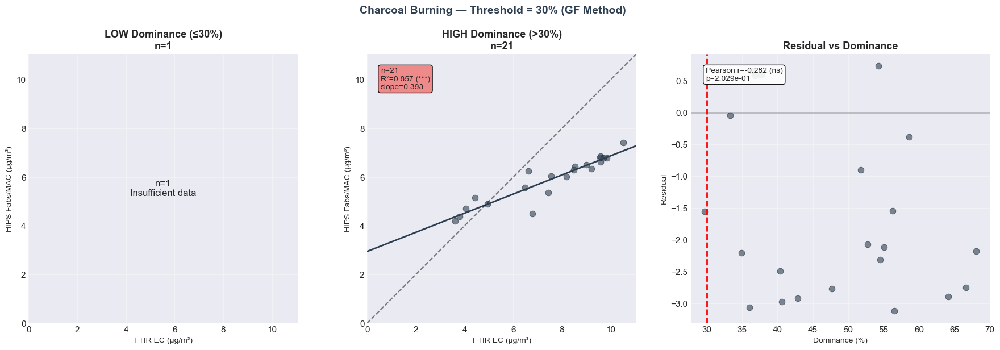

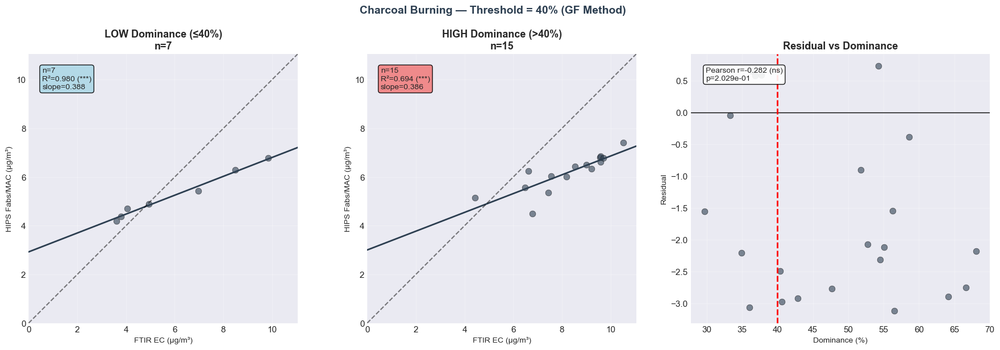

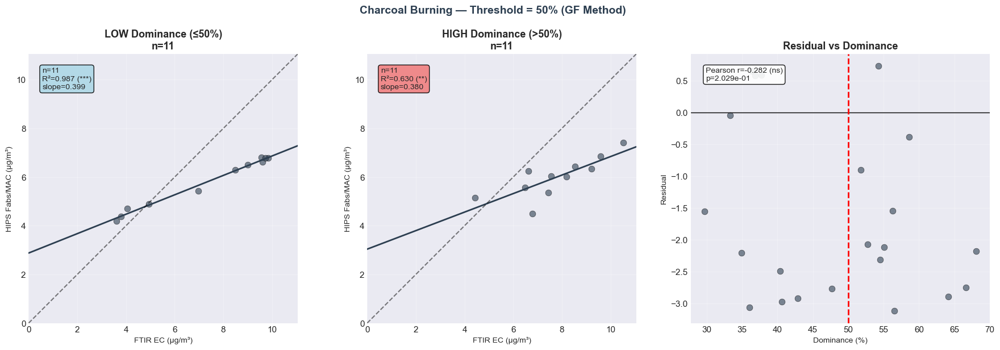

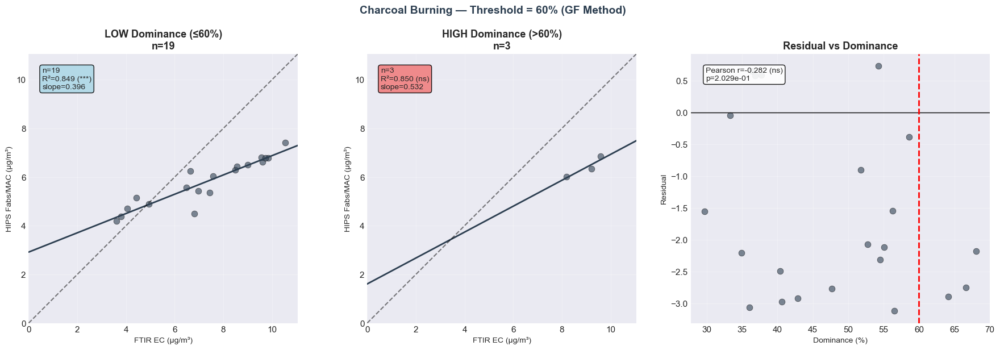

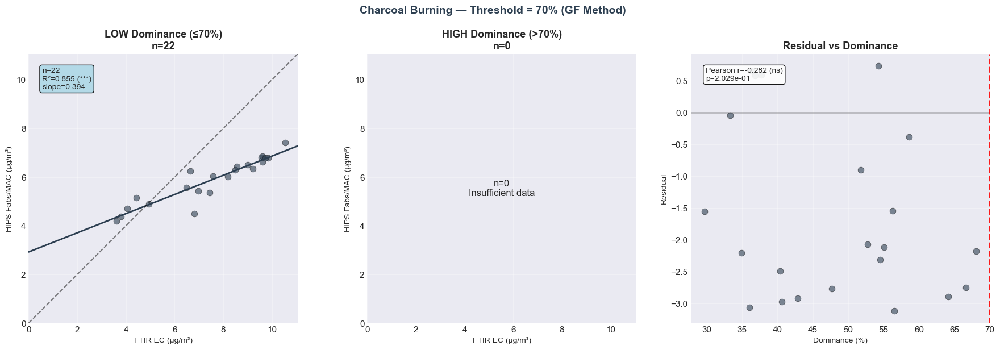


  --- Wood Burning (n=11) ---


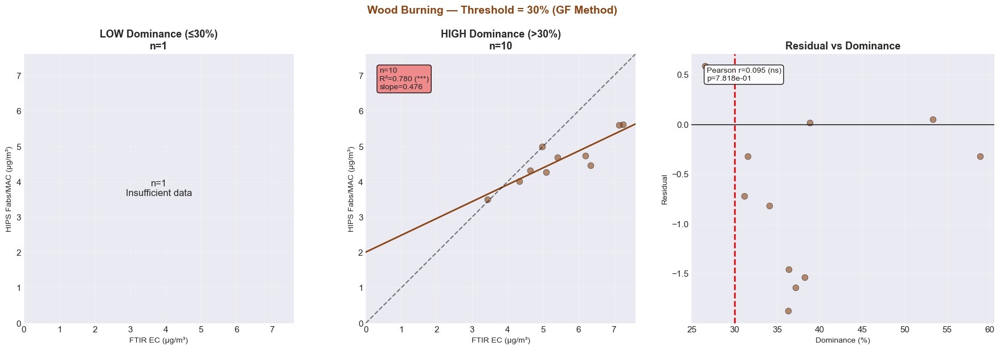

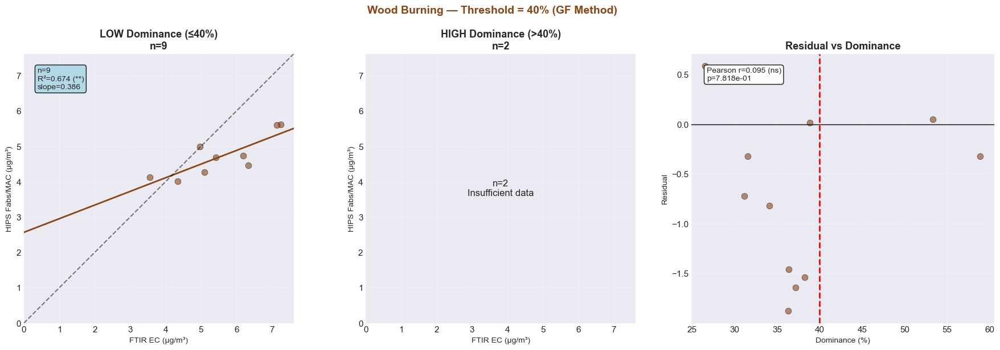

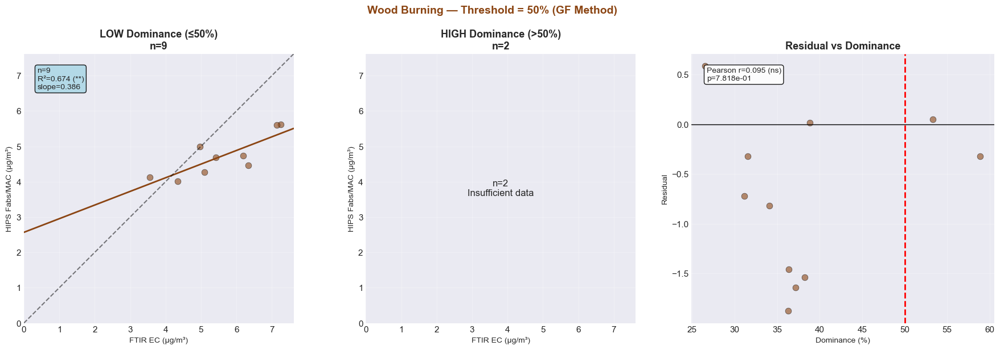

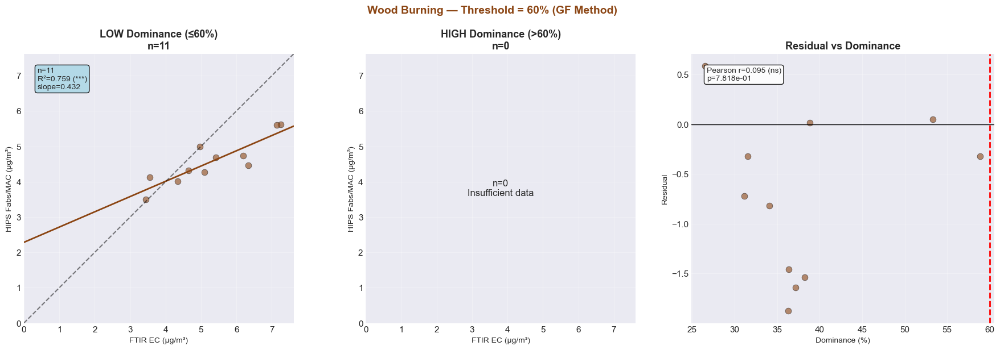

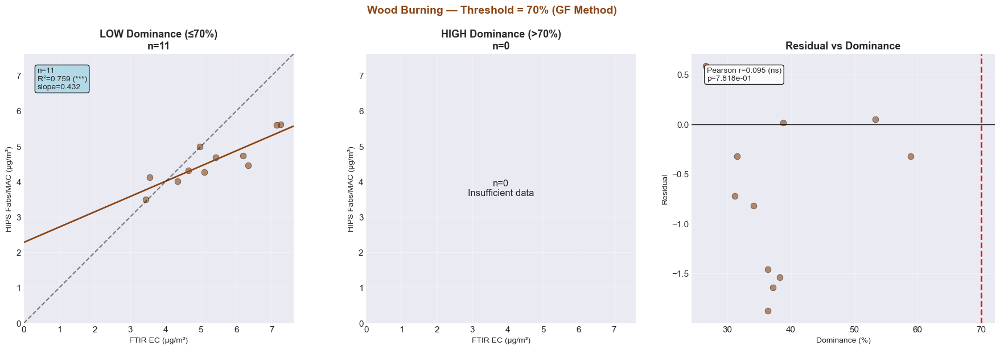


  --- Fossil Fuel (n=25) ---


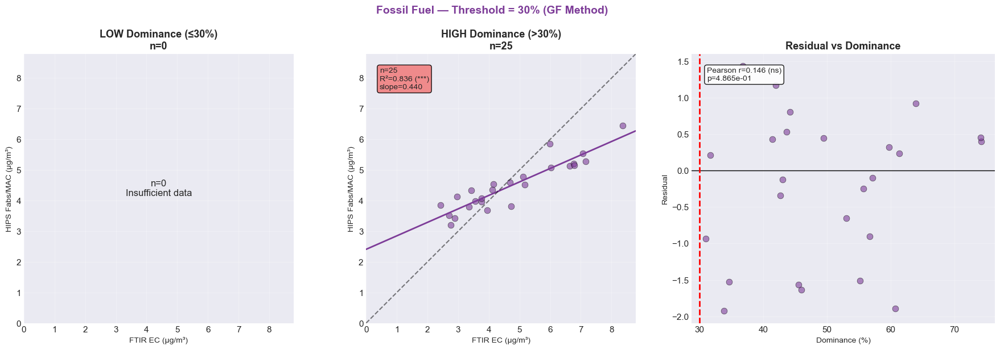

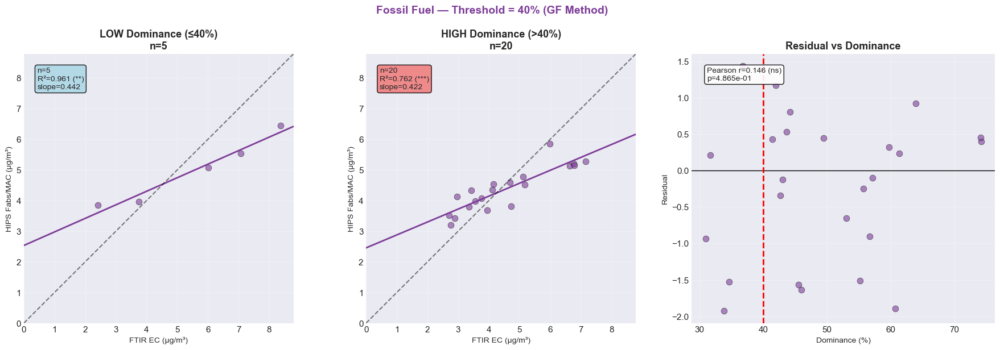

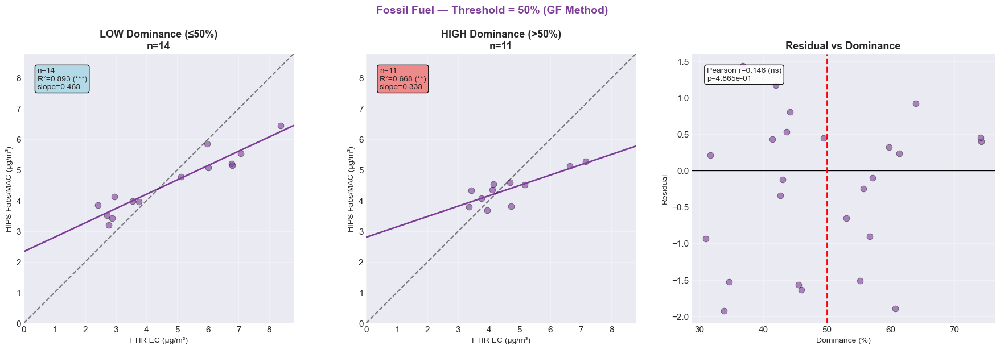

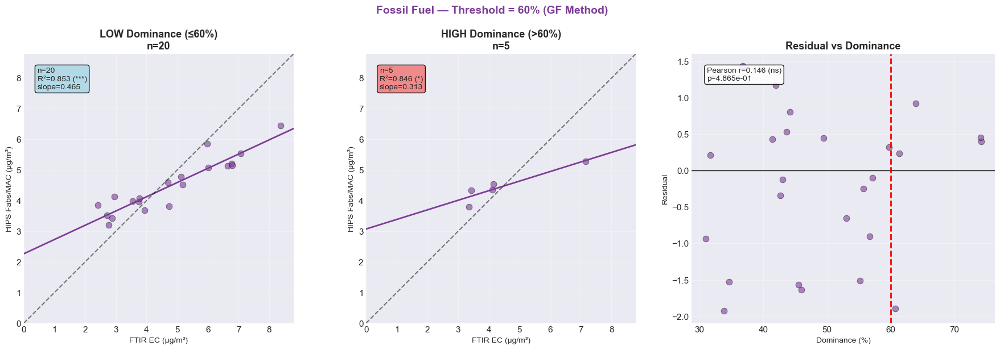

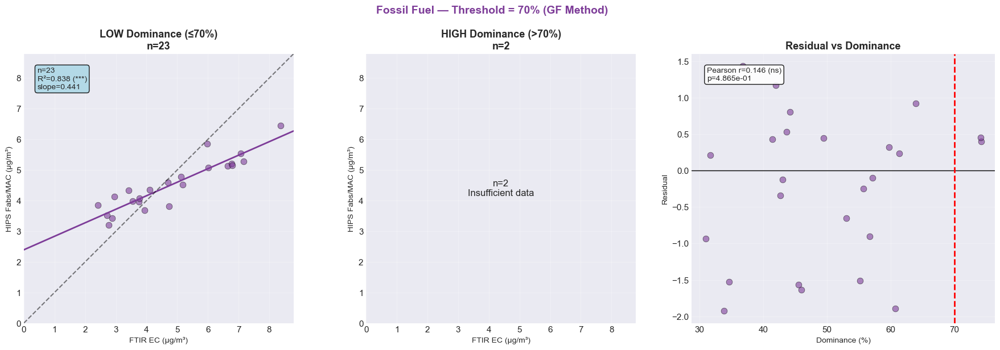


  --- Polluted Marine (n=23) ---


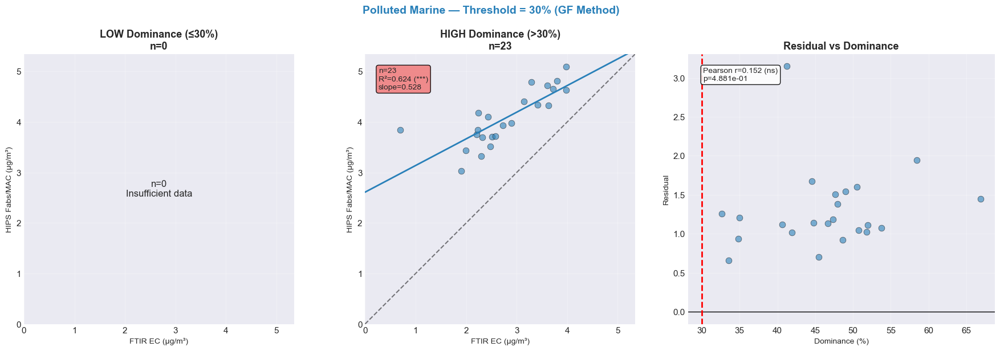

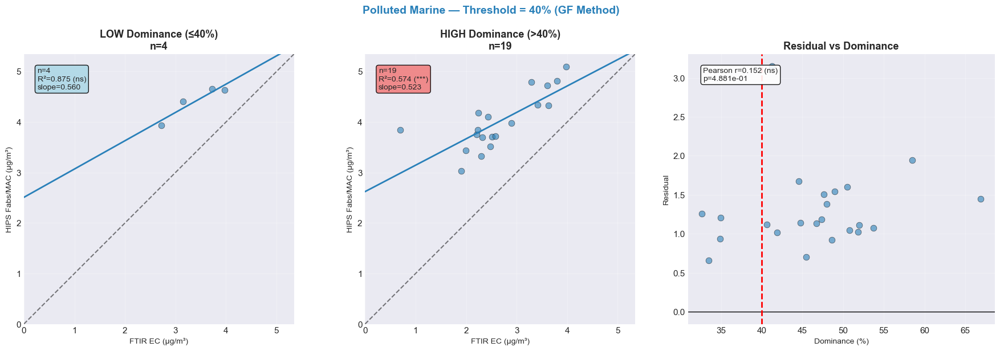

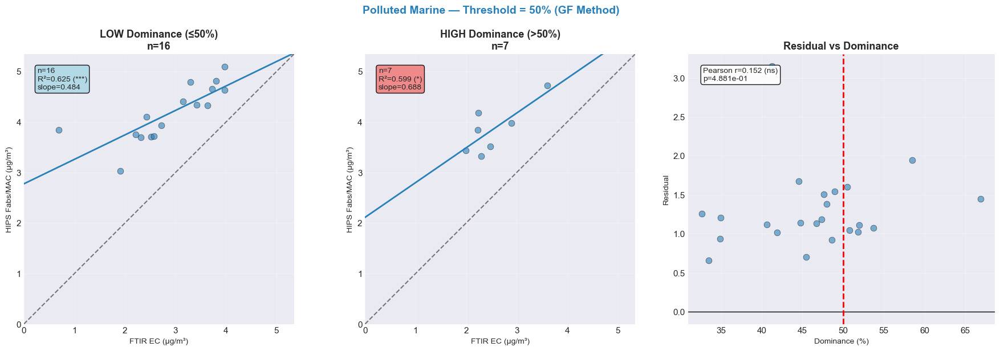

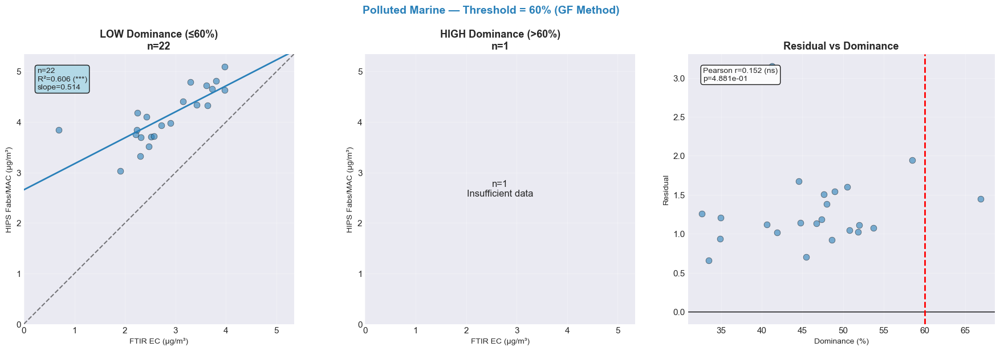

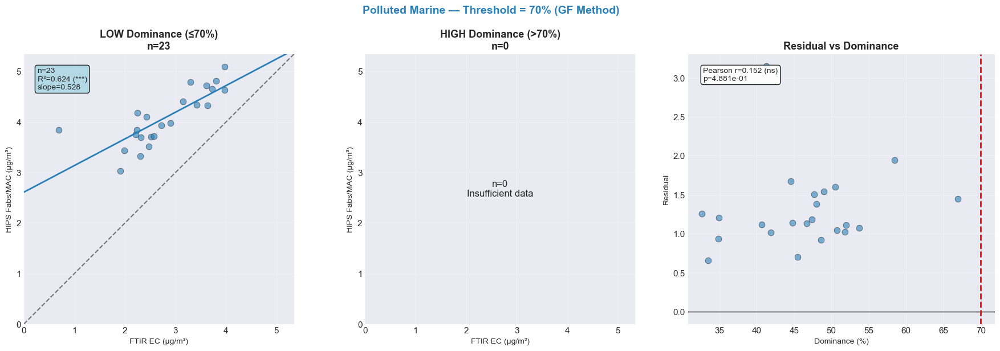


  --- Sea Salt (n=21) ---


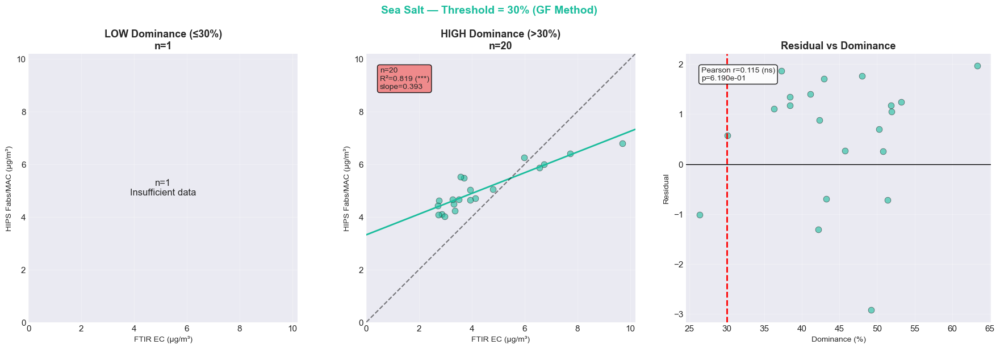

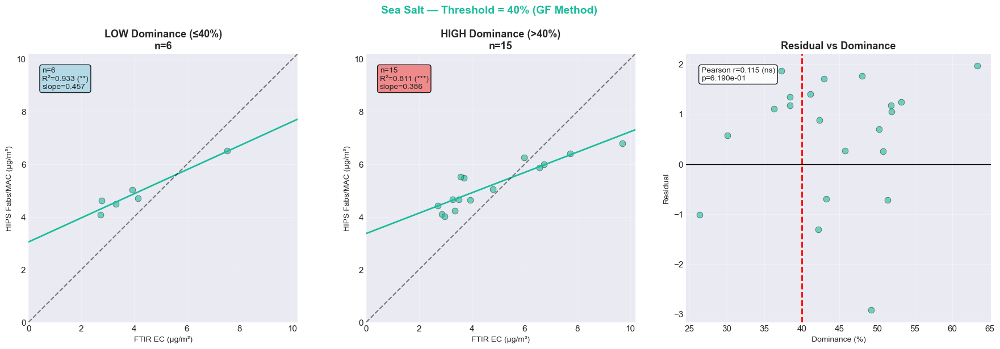

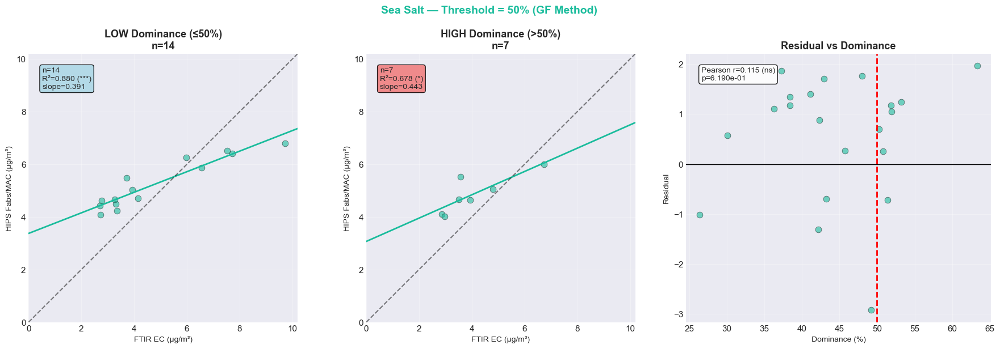

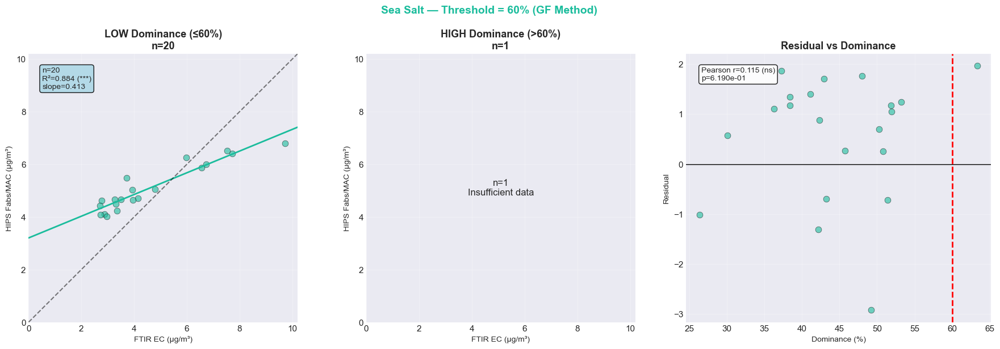

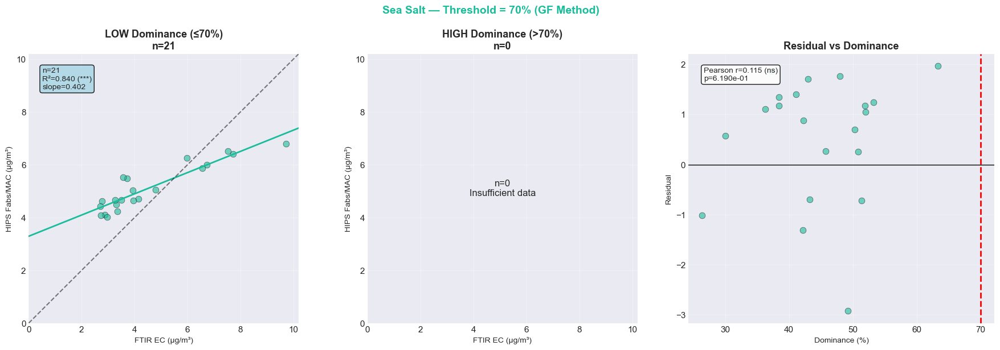


  Aeth IR BCc vs FTIR EC

  --- Charcoal Burning (n=22) ---


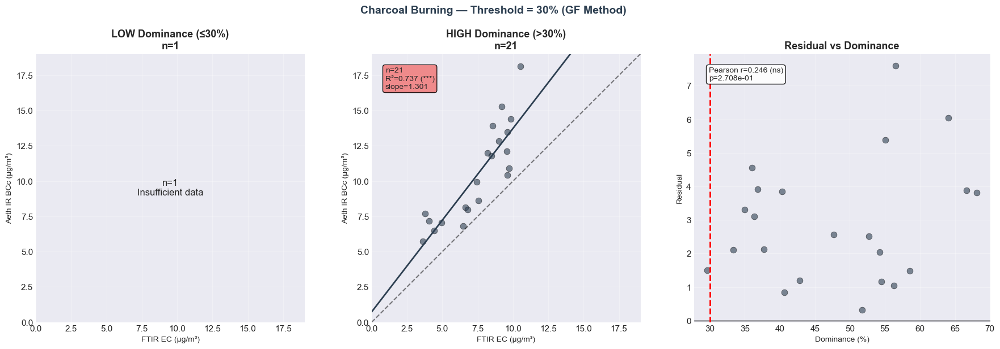

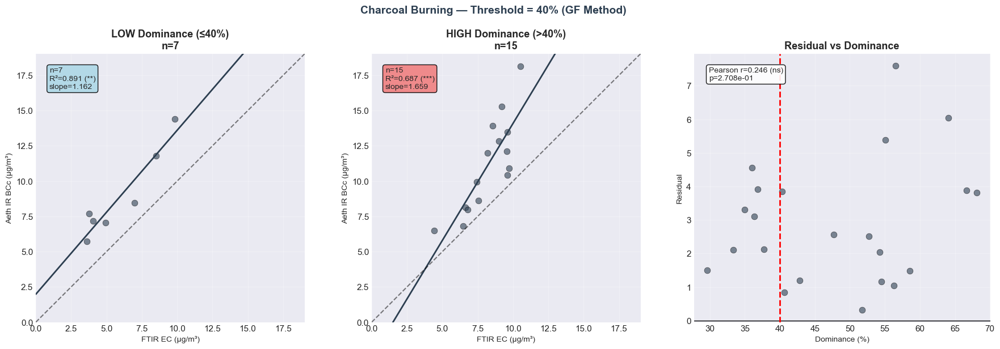

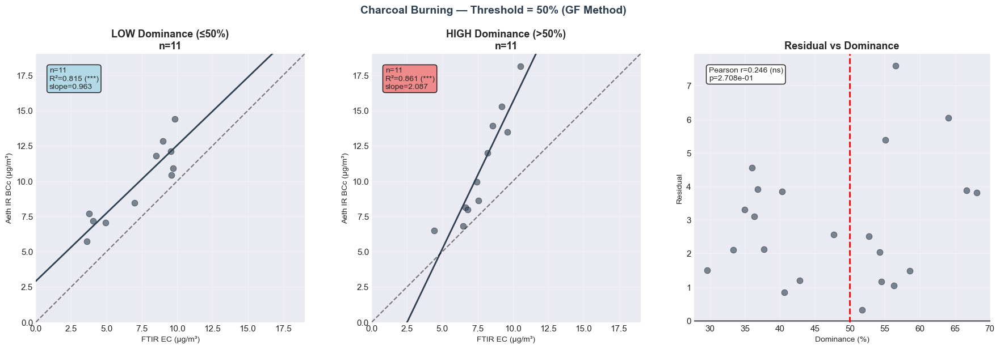

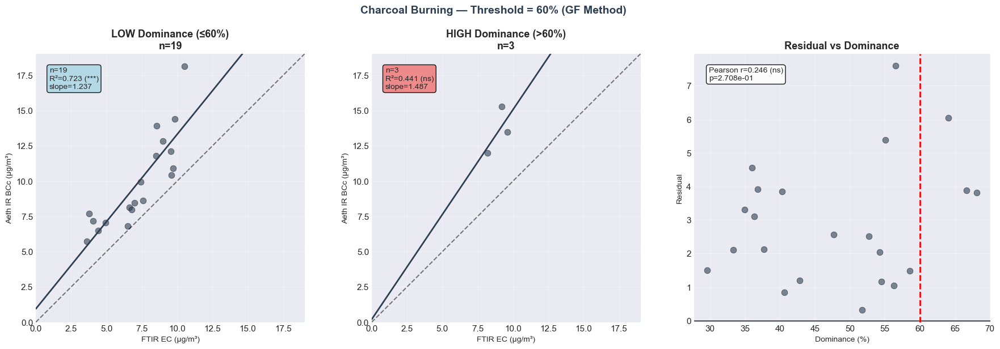

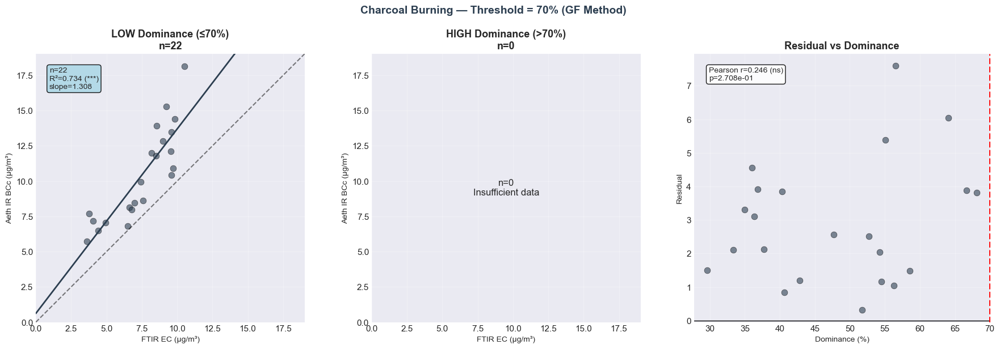


  --- Wood Burning (n=11) ---


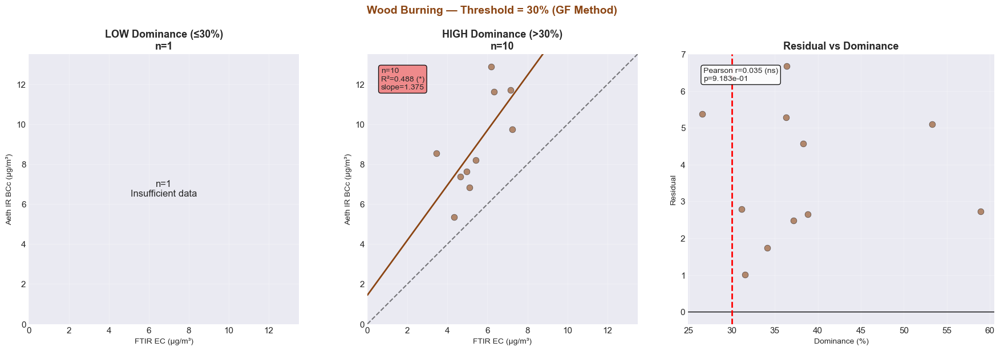

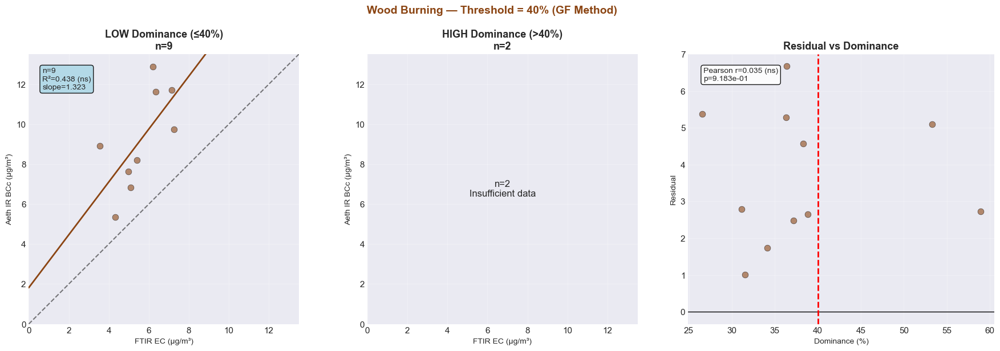

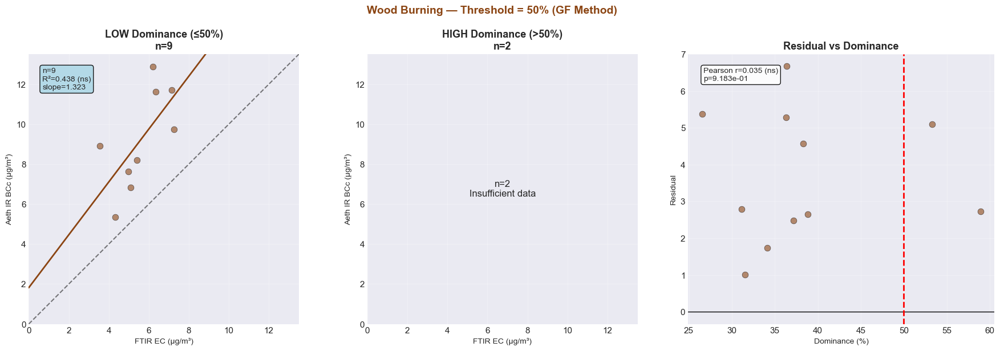

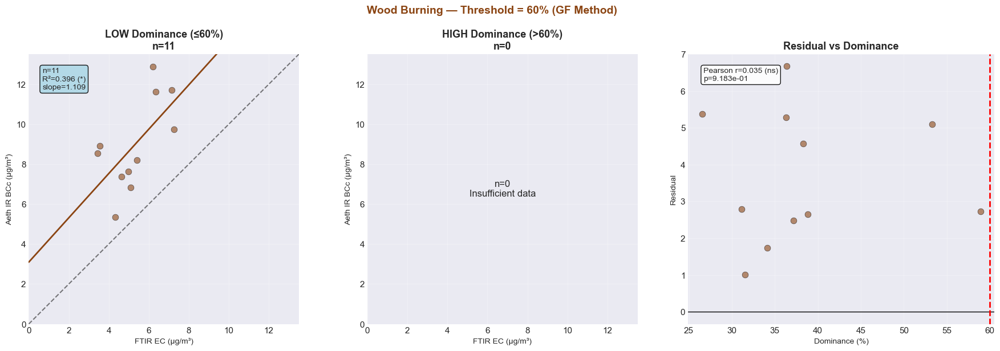

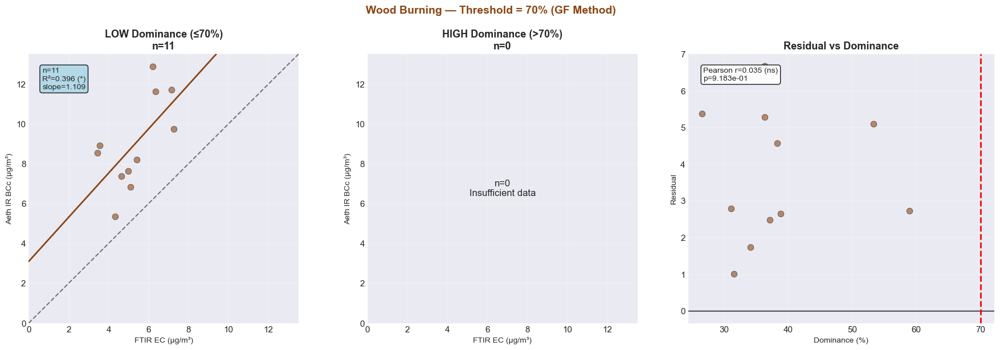


  --- Fossil Fuel (n=25) ---


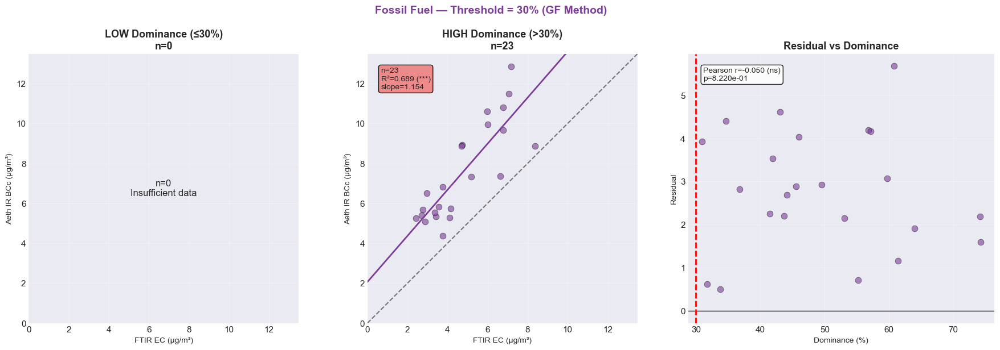

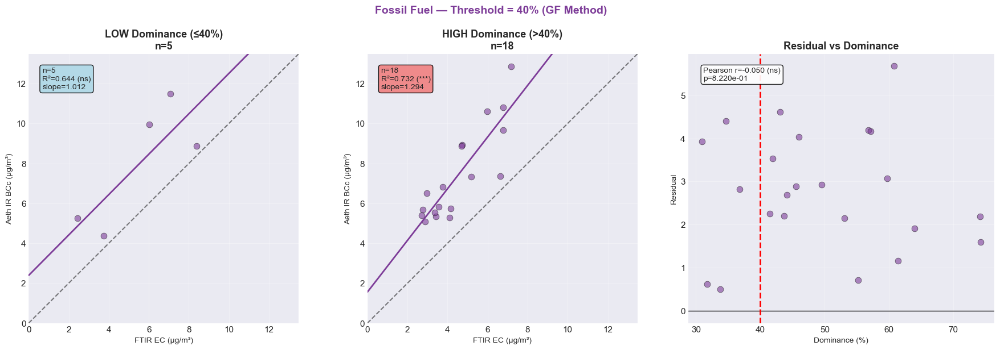

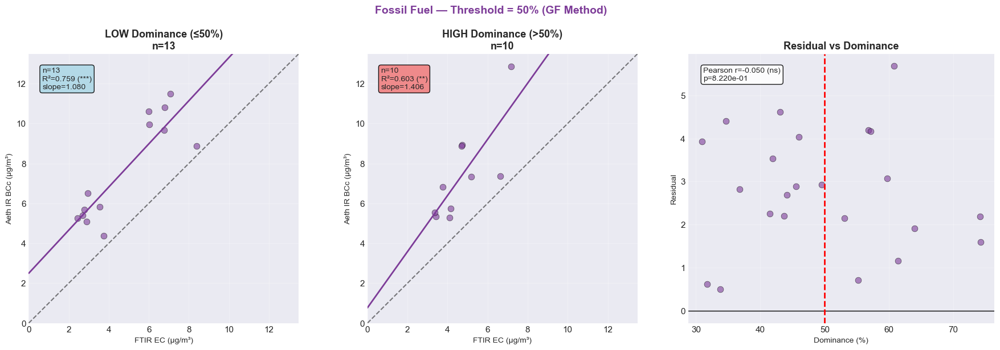

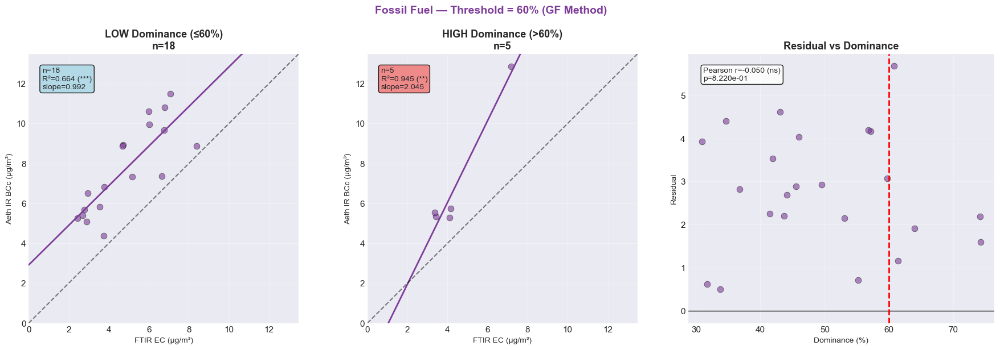

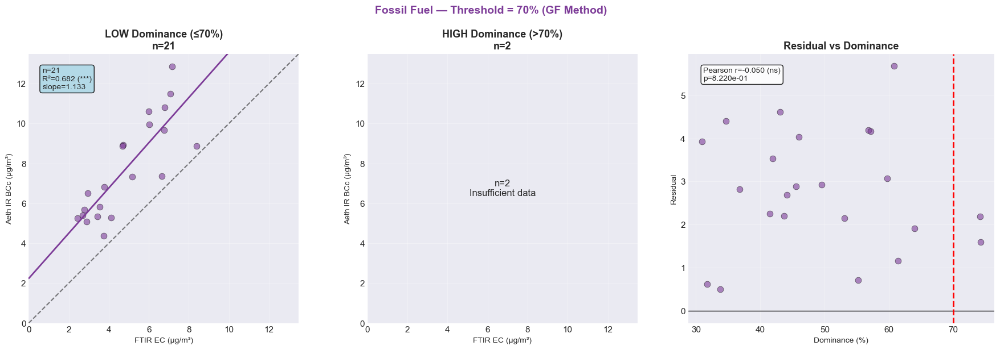


  --- Polluted Marine (n=23) ---


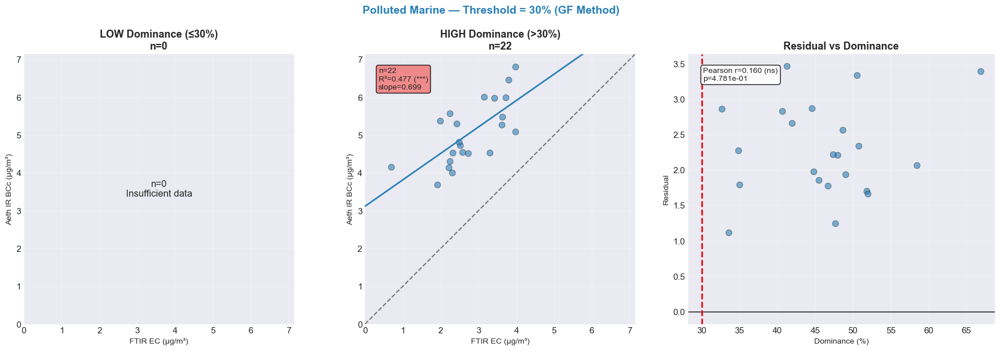

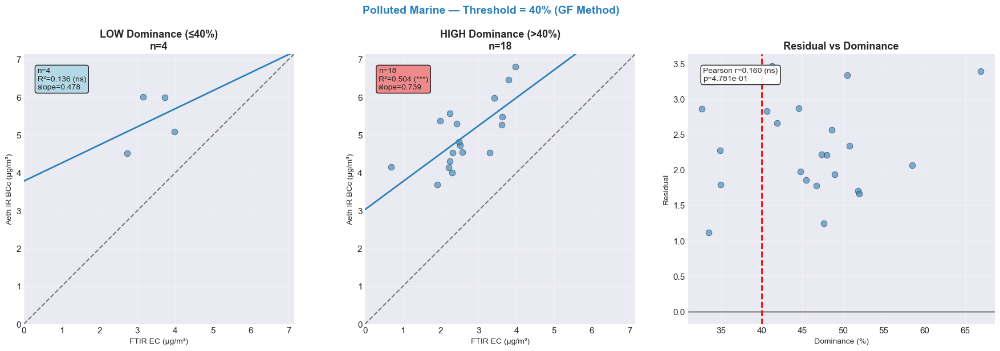

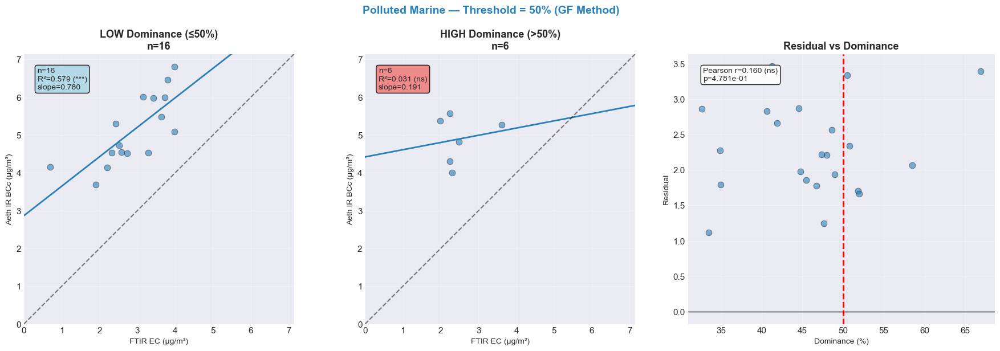

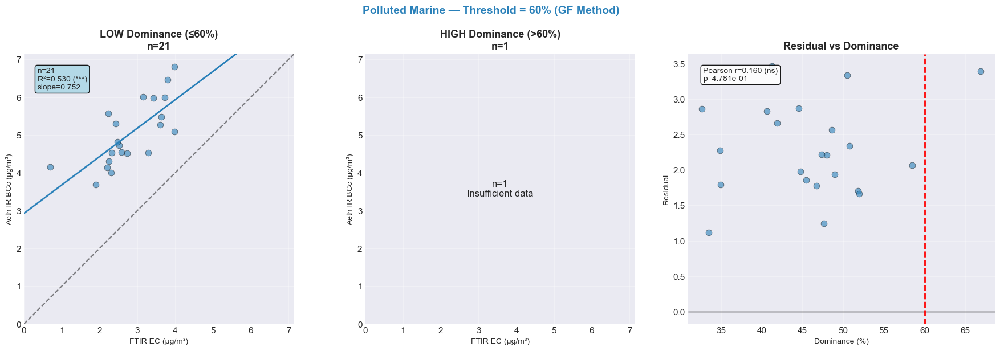

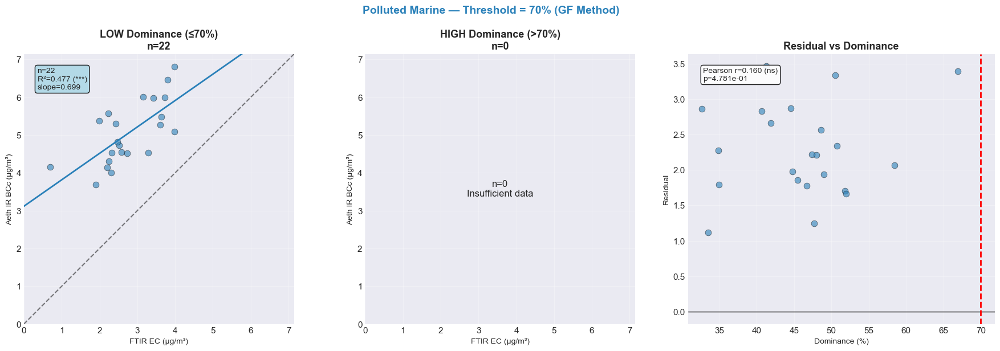


  --- Sea Salt (n=21) ---


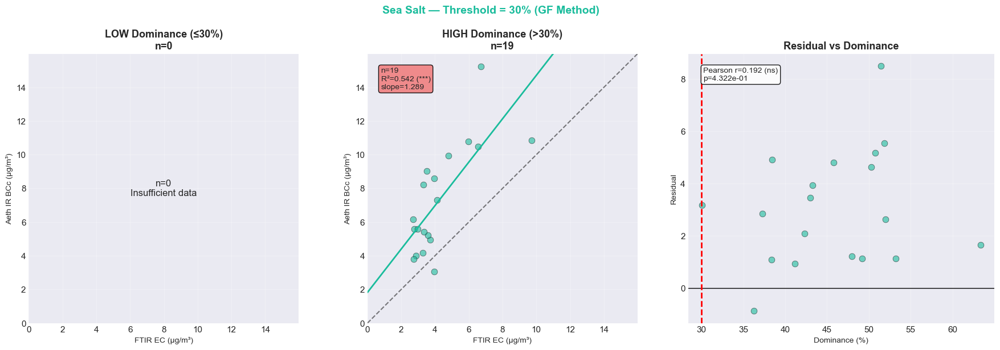

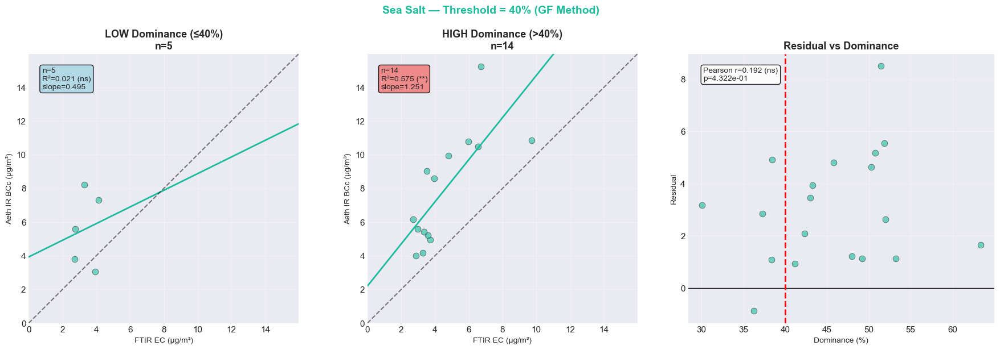

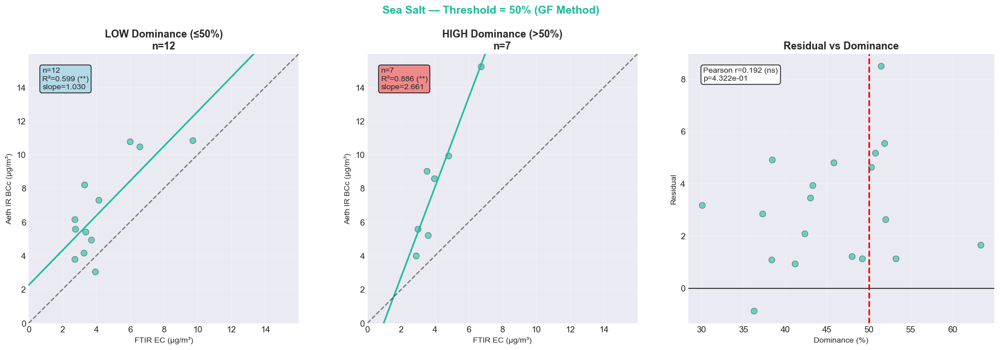

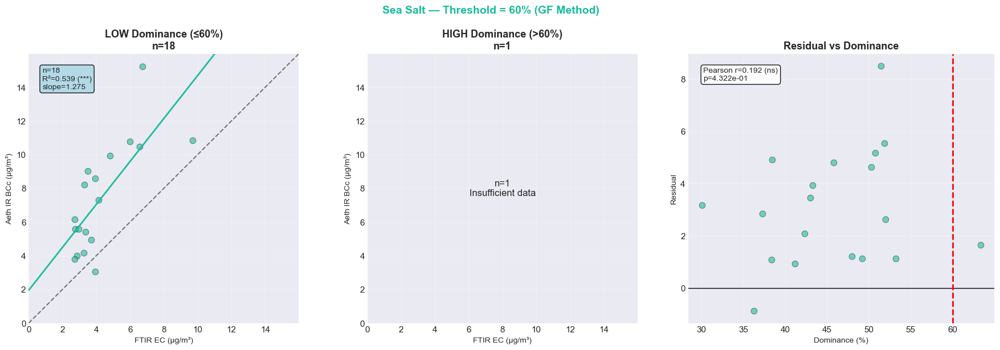

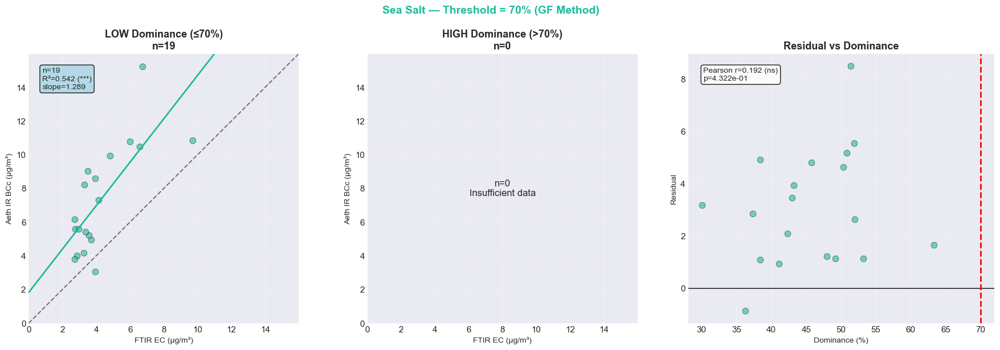


  Aeth IR BCc vs HIPS Fabs/MAC

  --- Charcoal Burning (n=22) ---


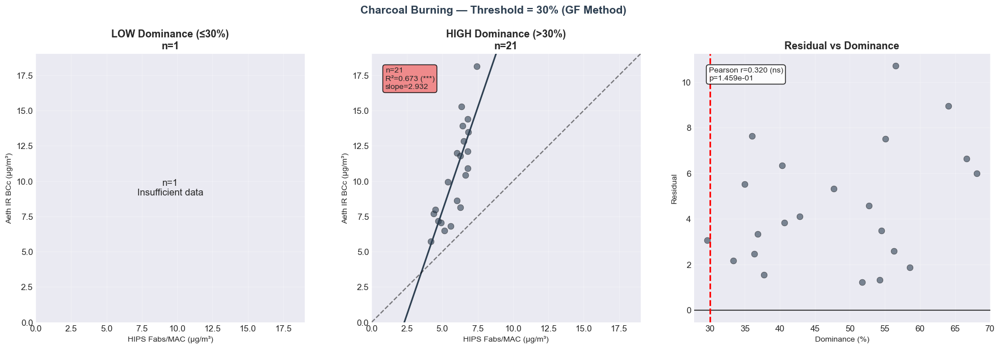

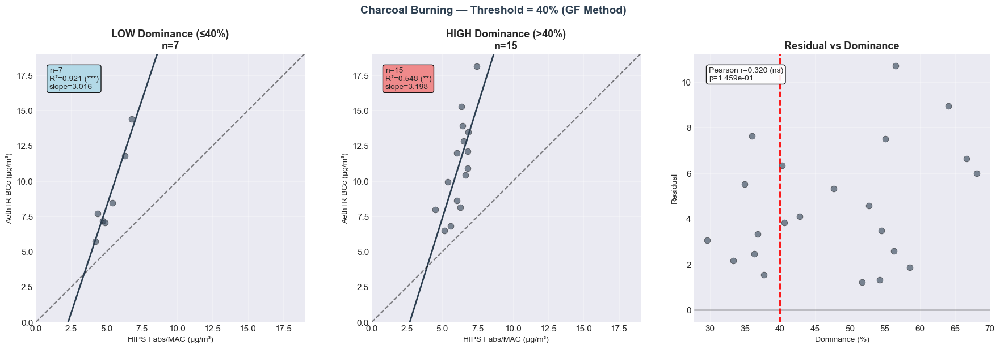

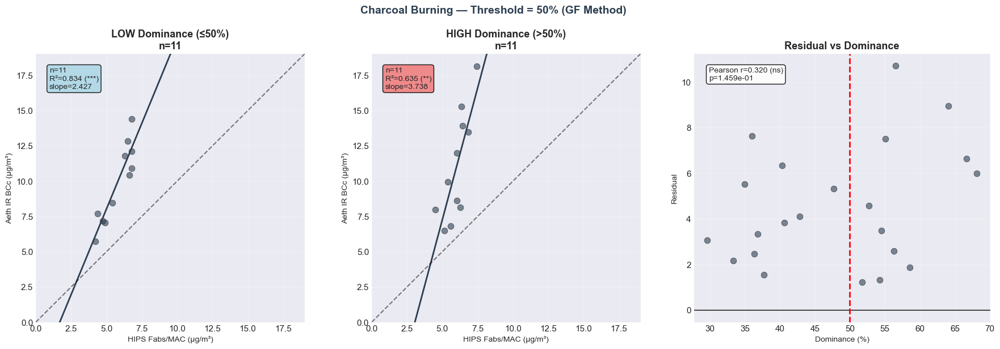

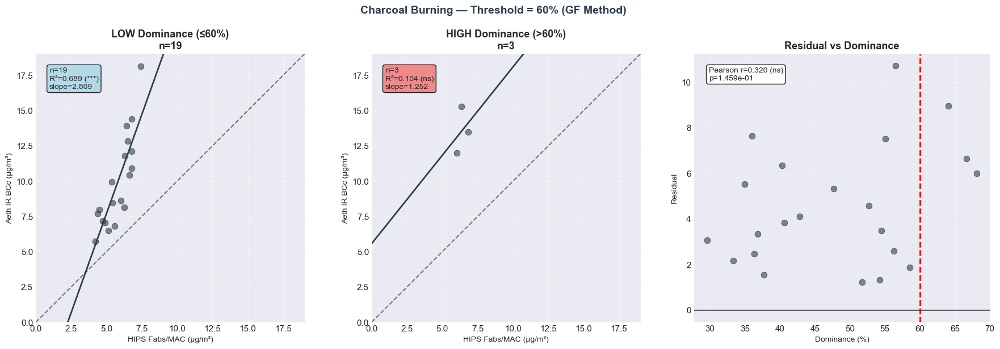

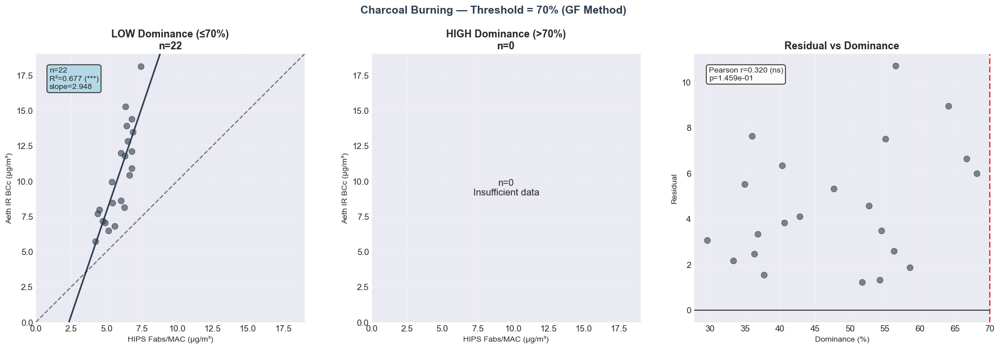


  --- Wood Burning (n=11) ---


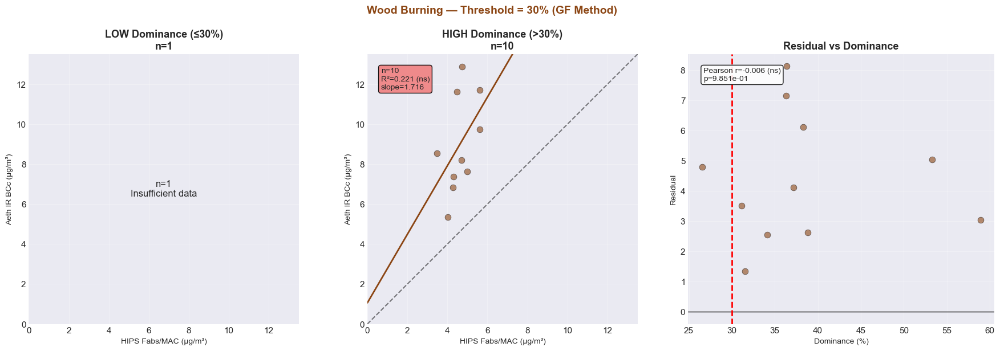

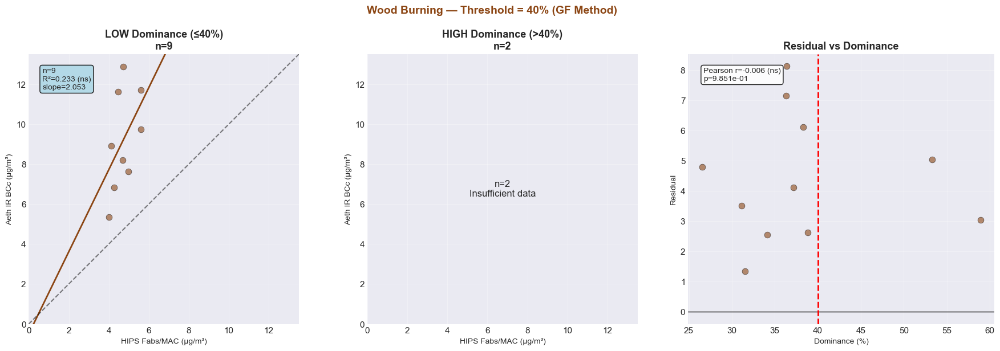

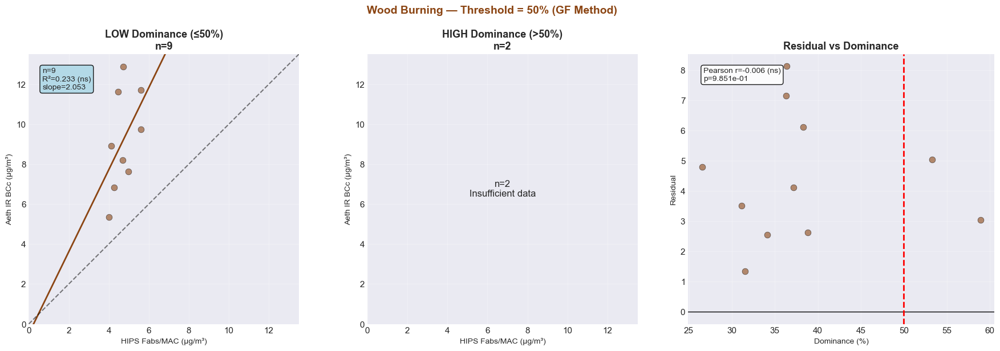

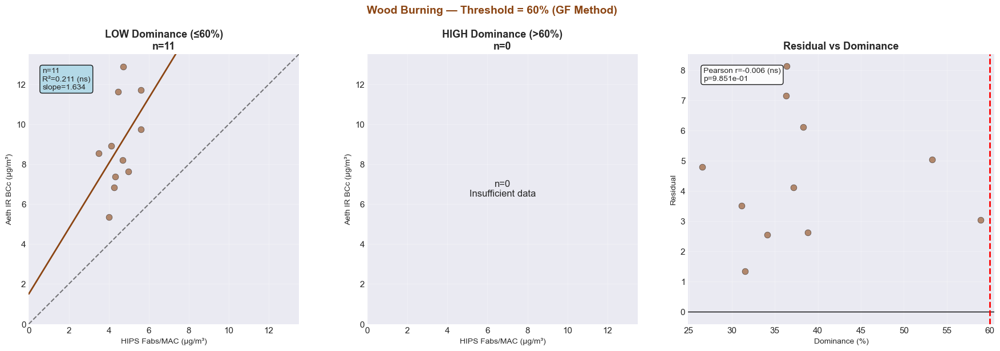

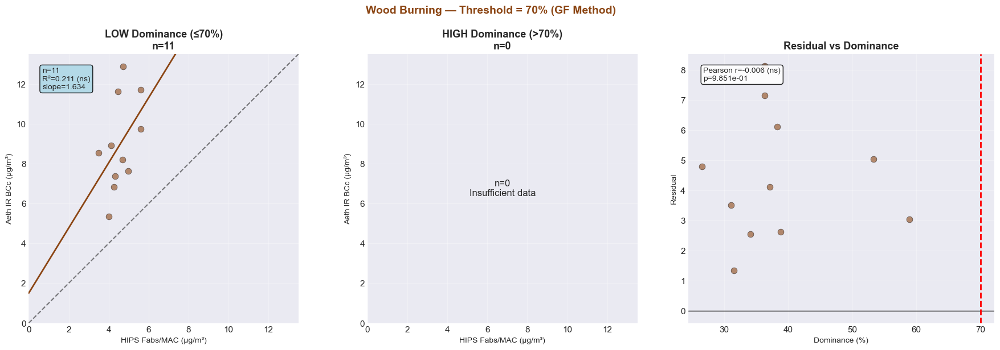


  --- Fossil Fuel (n=25) ---


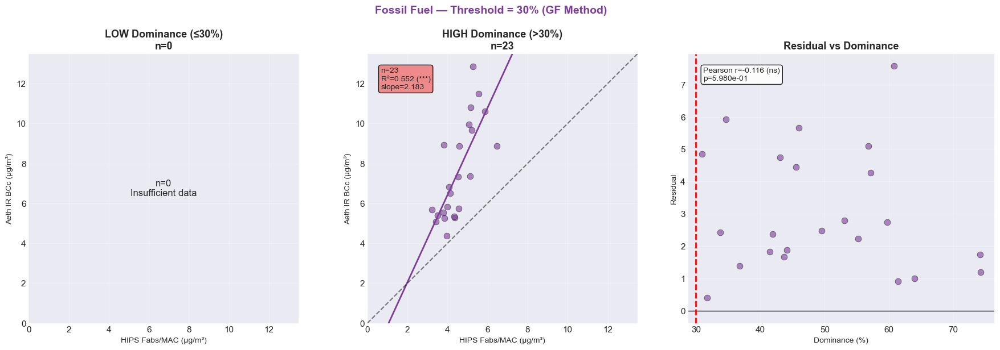

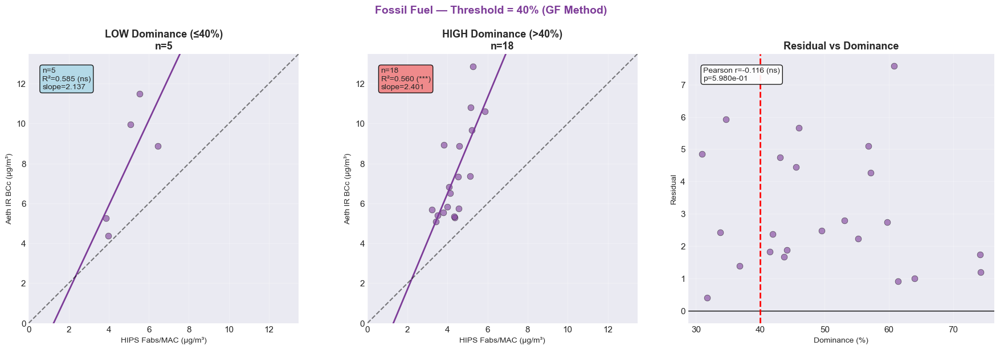

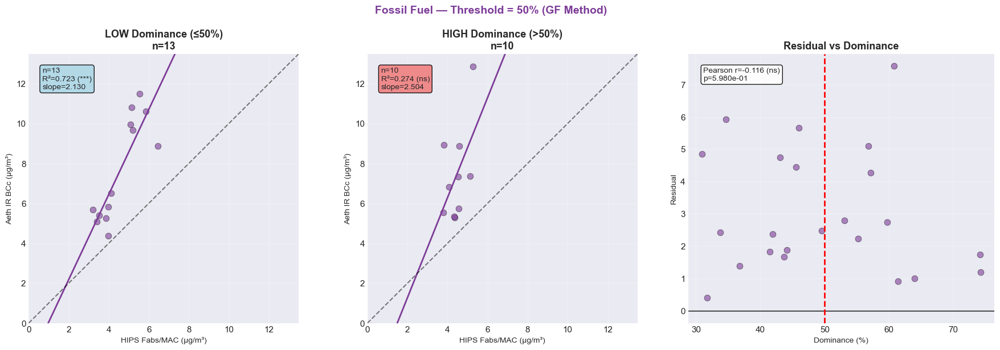

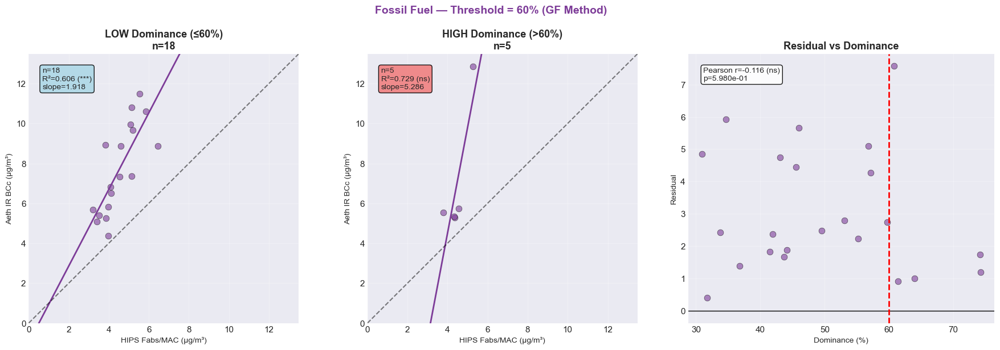

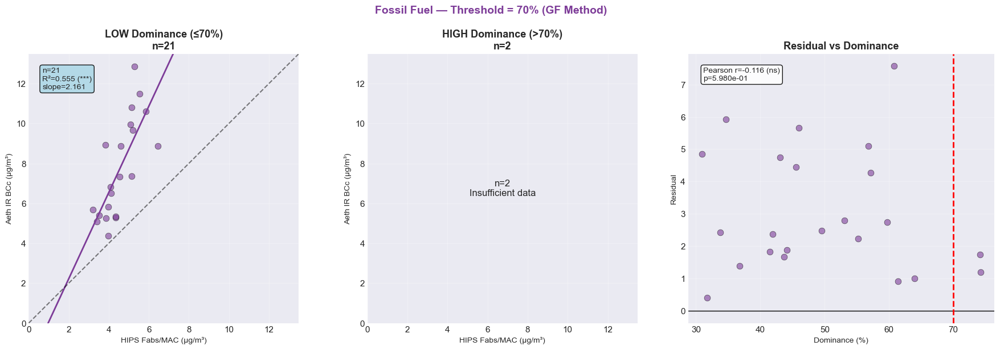


  --- Polluted Marine (n=23) ---


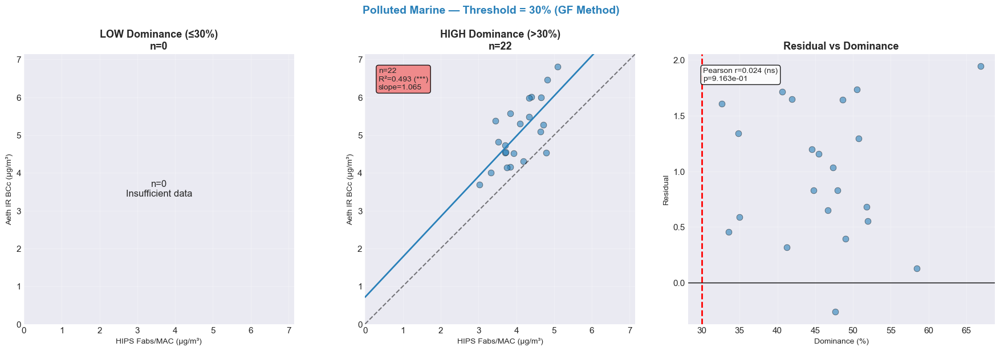

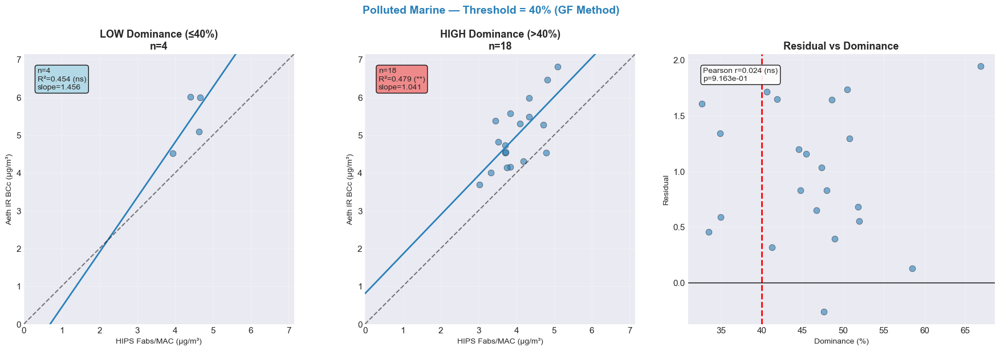

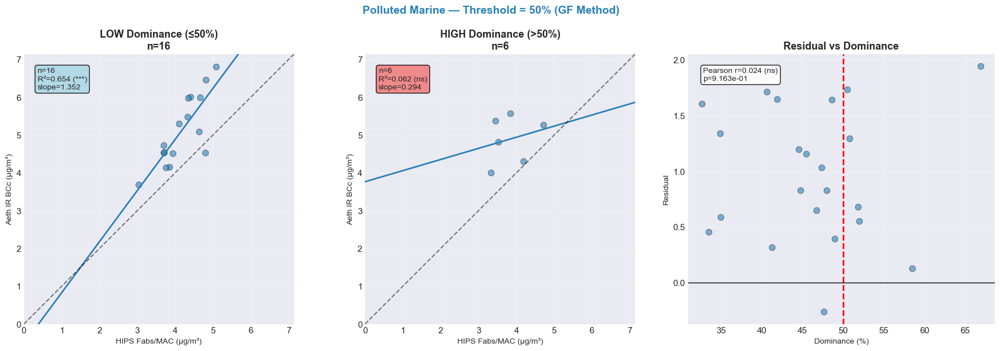

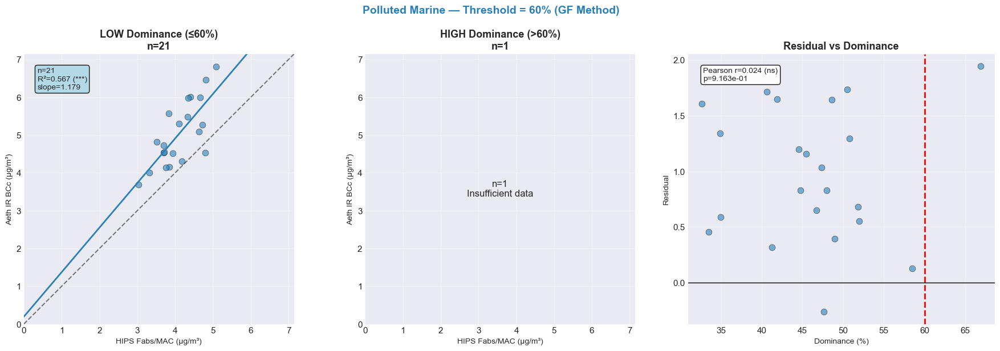

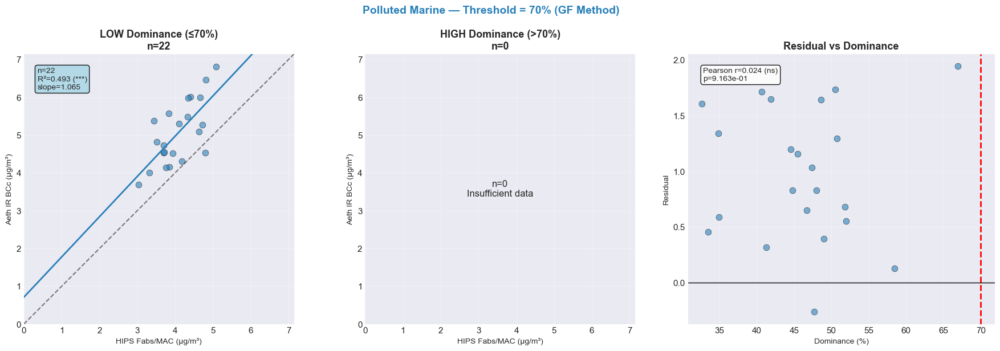


  --- Sea Salt (n=21) ---


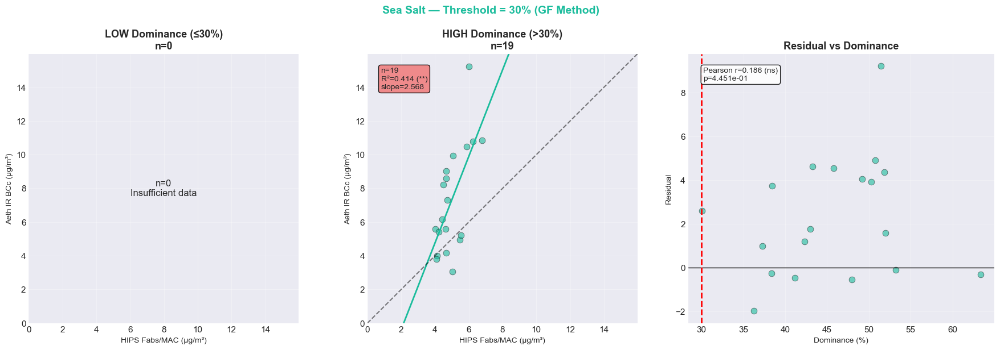

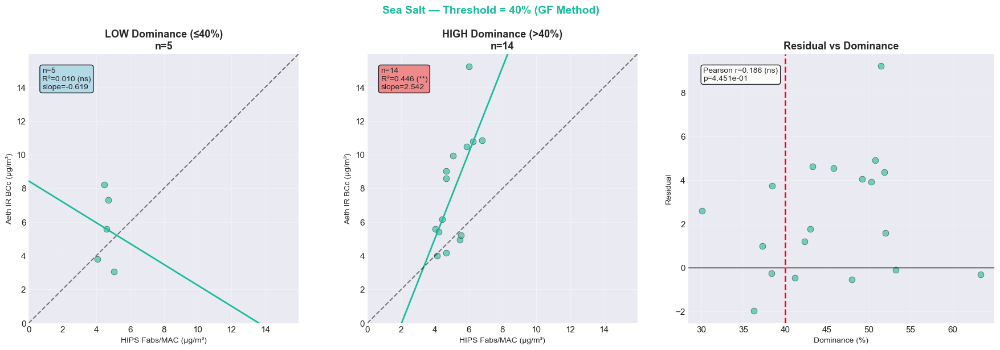

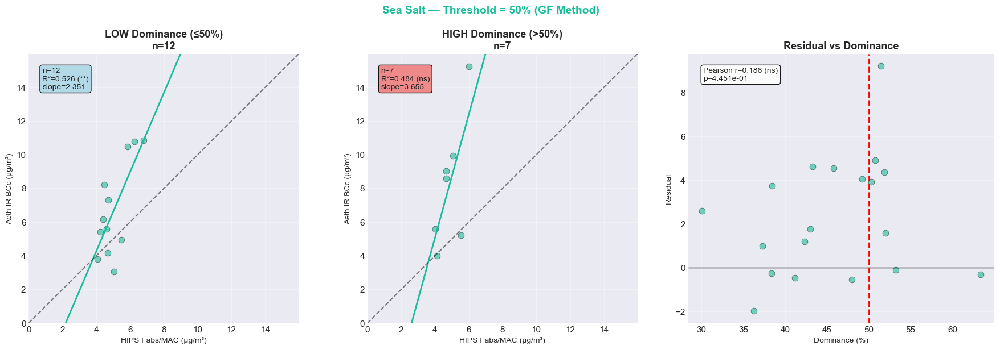

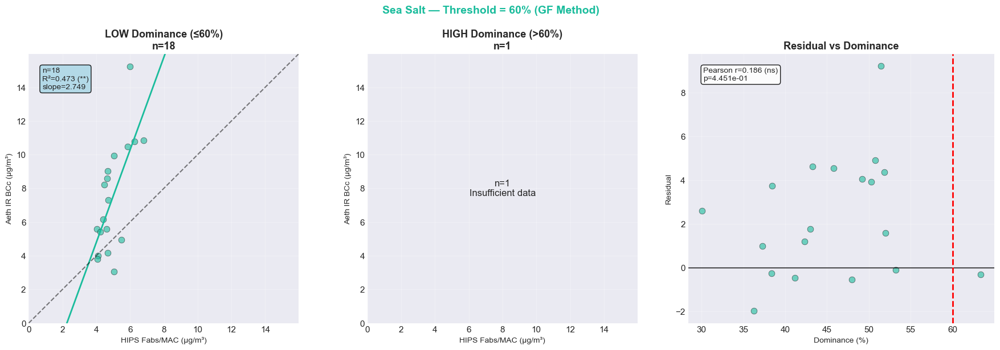

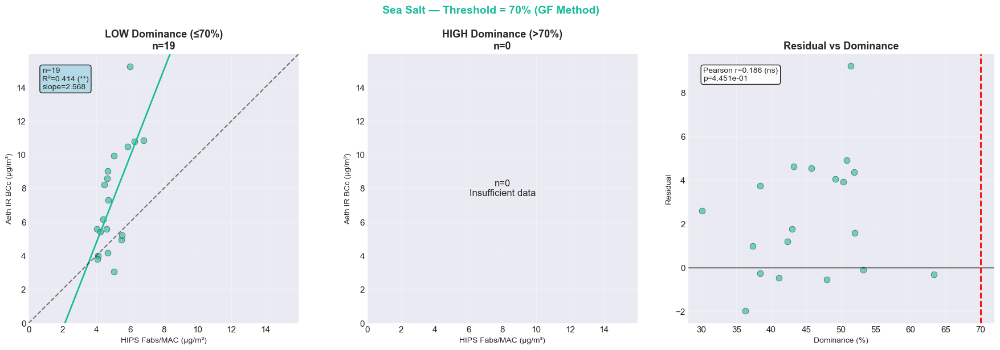

In [11]:
print("=" * 100)
print("SOURCE-SPECIFIC THRESHOLD ANALYSIS — GF (FRACTION) METHOD")
print("=" * 100)

# Store all source-specific results
gf_source_results = {}

for x_col, y_col, x_label, y_label, prefix in METHOD_PAIRS:
    pair_label = f'{y_label.split(" (")[0]} vs {x_label.split(" (")[0]}'
    gf_source_results[prefix] = {}
    
    print(f"\n{'='*100}")
    print(f"  {pair_label}")
    print(f"{'='*100}")
    
    for source in SOURCE_ORDER:
        source_label = SOURCE_CATEGORIES[source]['label']
        gf_source_results[prefix][source] = {}
        
        # Check if we have enough data for this source
        source_mask = df['dominant_source_frac'] == source
        n_source = source_mask.sum()
        
        if n_source < 10:
            print(f"\n  --- {source_label}: Skipping (n={n_source}) ---")
            continue
        
        print(f"\n  --- {source_label} (n={n_source}) ---")
        
        for threshold in DOMINANCE_THRESHOLDS:
            results = analyze_threshold_visual_for_source(
                df, x_col, y_col, 'dominant_gf_relative', 'dominant_source_frac',
                source, threshold, x_label, y_label, 'GF Method'
            )
            if results:
                gf_source_results[prefix][source][threshold] = results

## Source-Specific Analysis: K_F Method

SOURCE-SPECIFIC THRESHOLD ANALYSIS — K_F (CONCENTRATION) METHOD

  HIPS Fabs/MAC vs FTIR EC

  --- Charcoal Burning (n=41) ---


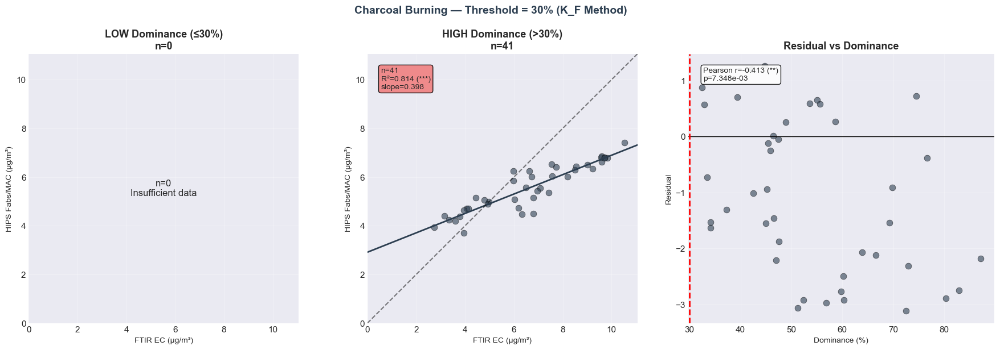

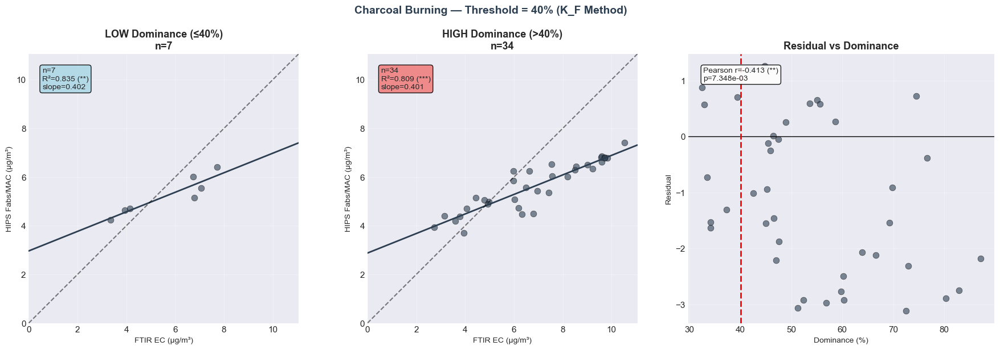

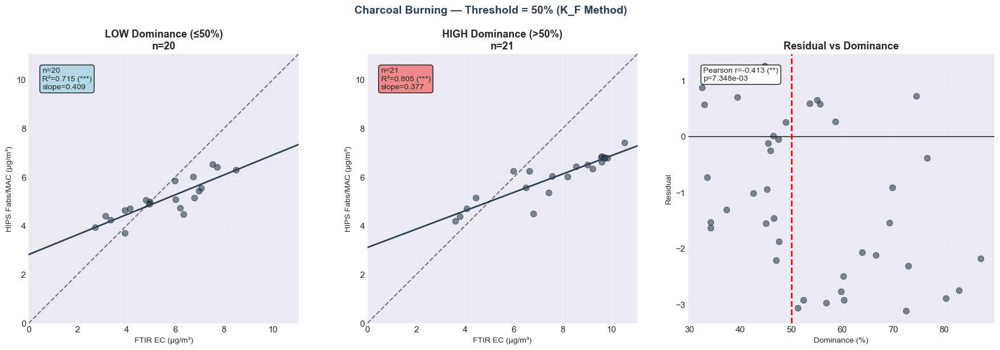

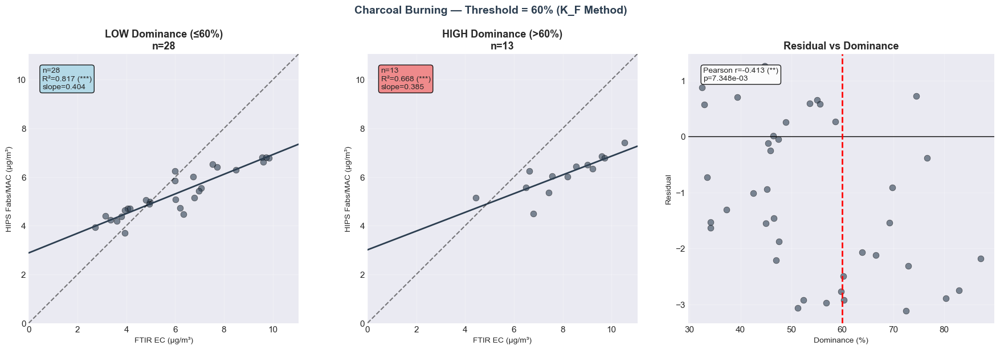

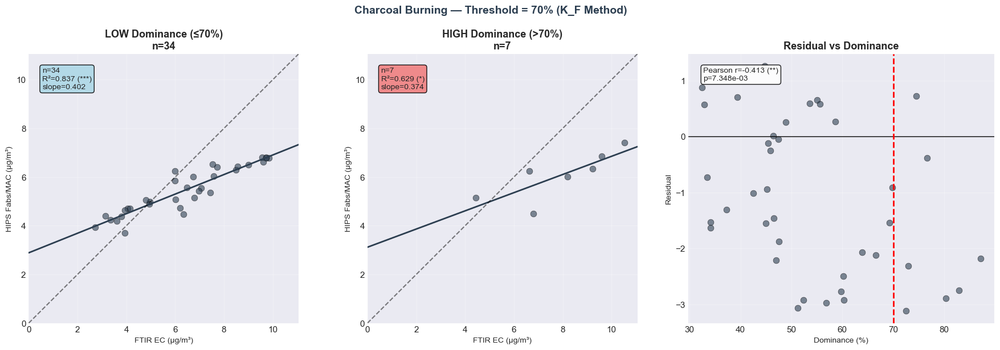


  --- Wood Burning (n=24) ---


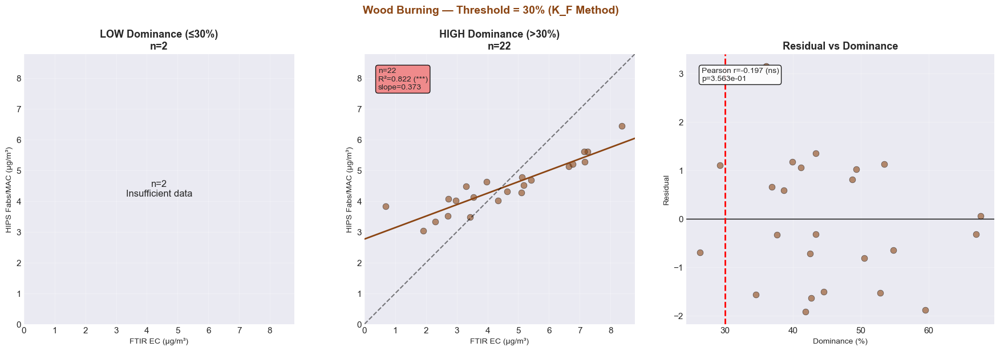

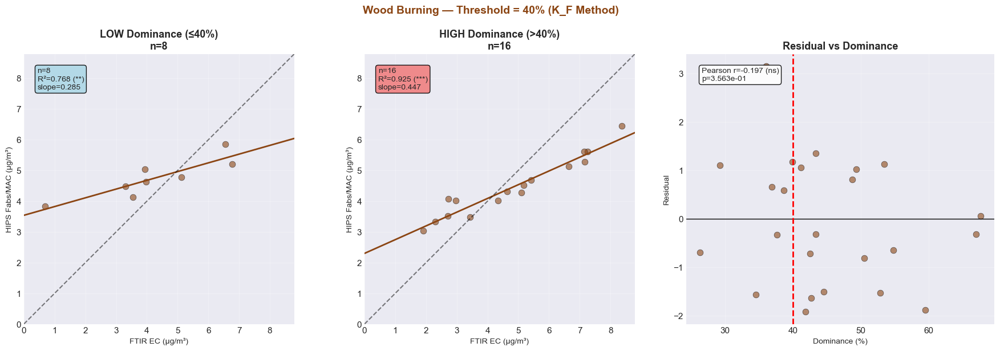

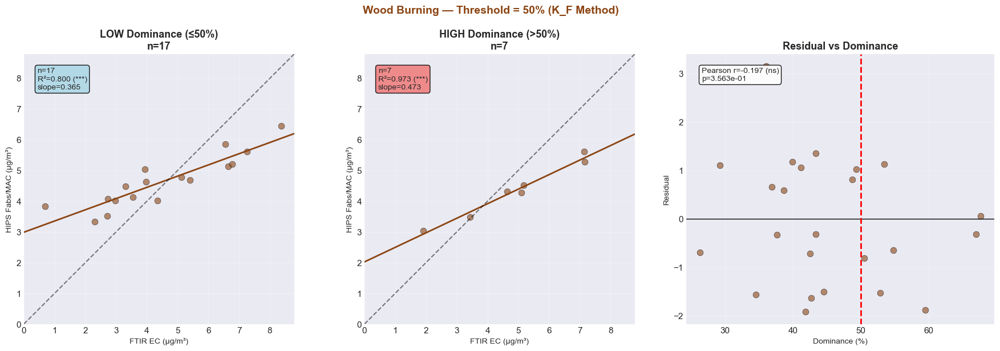

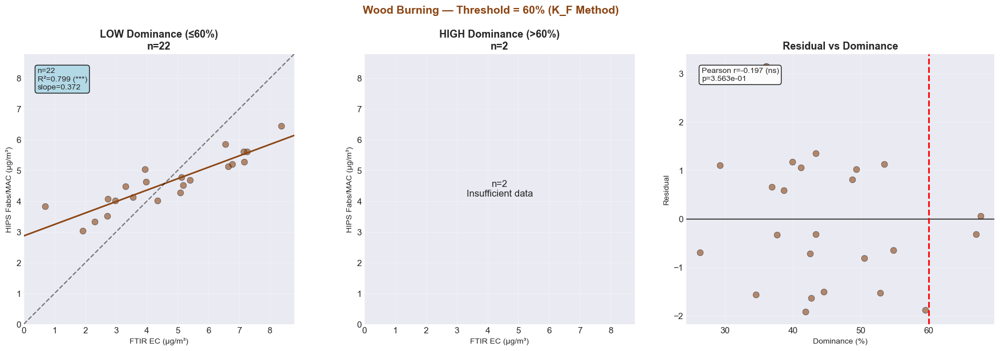

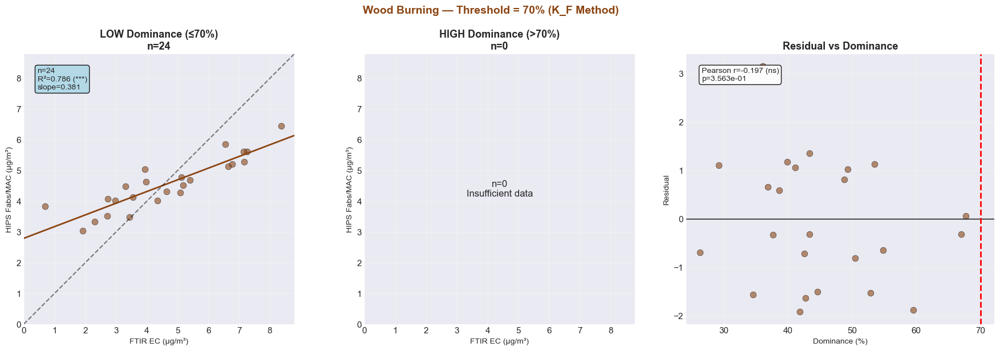


  --- Fossil Fuel (n=13) ---


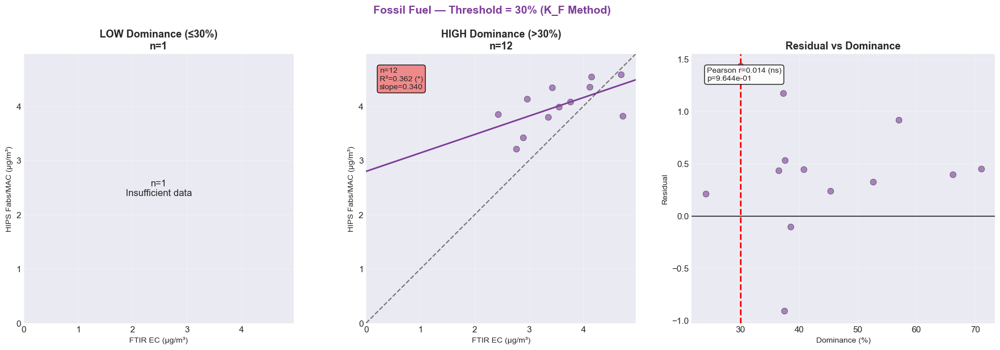

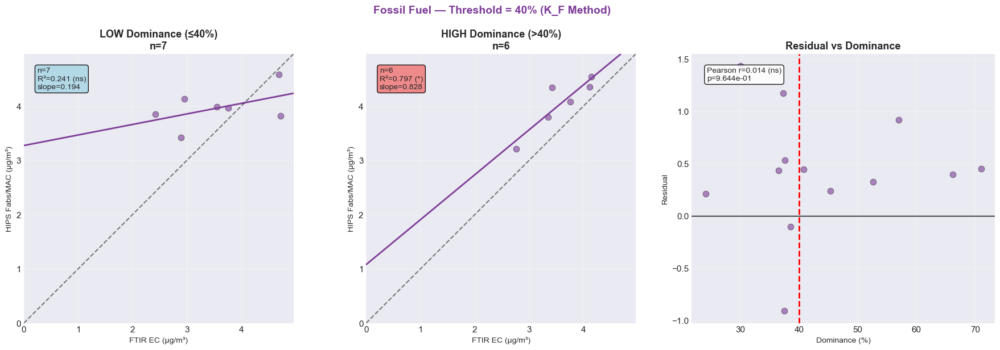

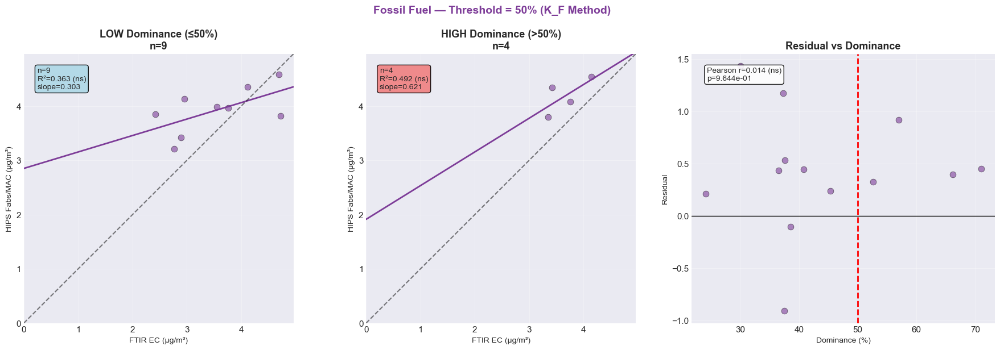

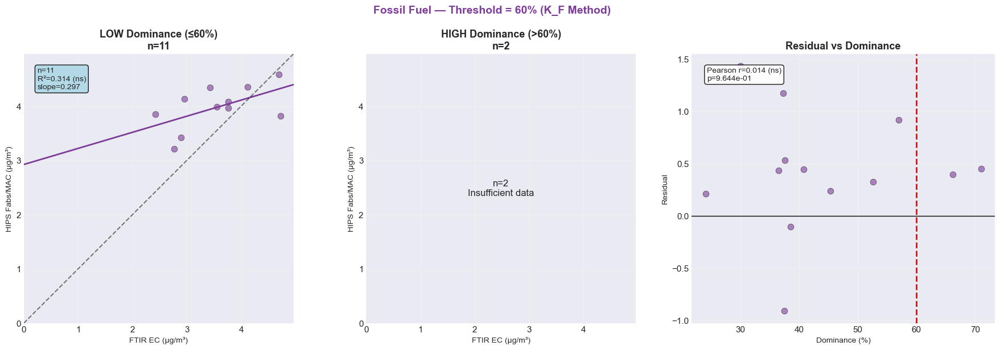

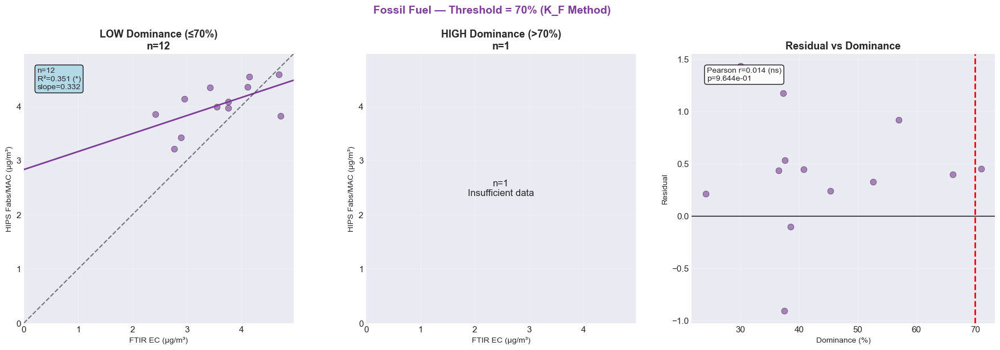


  --- Polluted Marine (n=21) ---


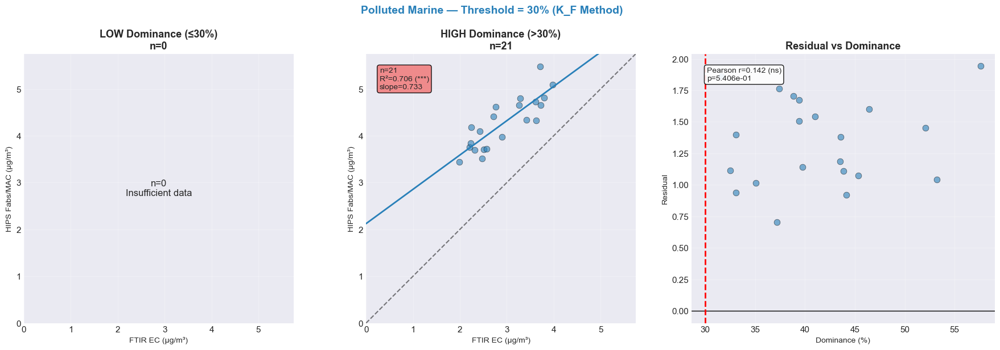

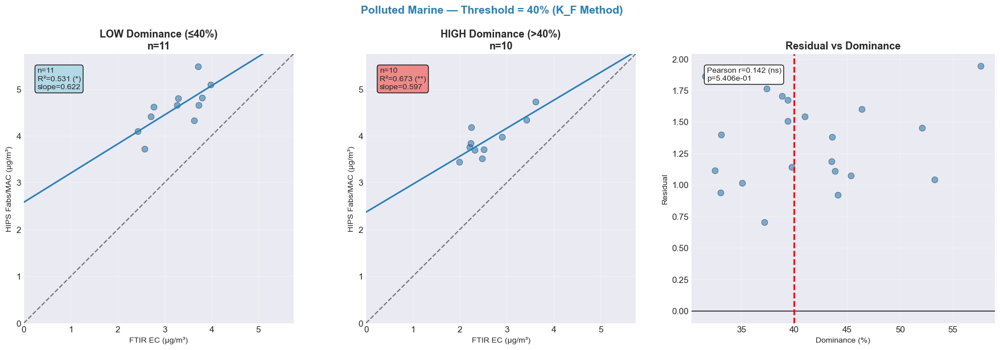

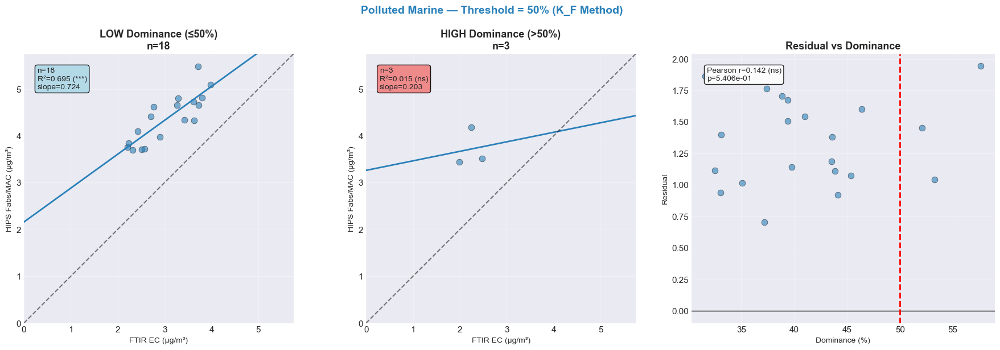

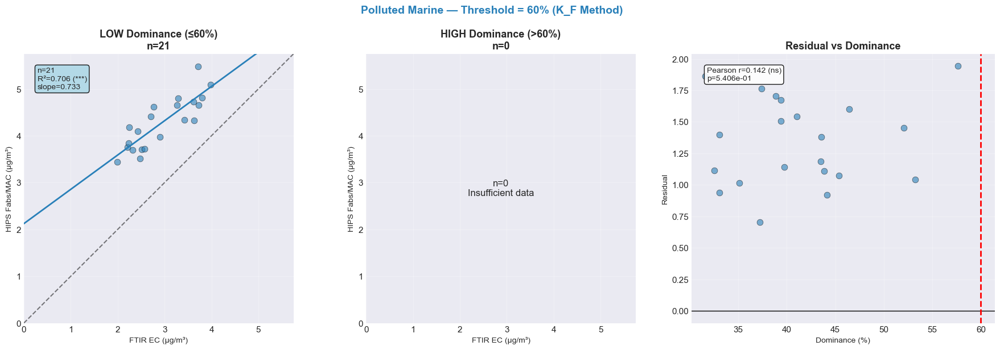

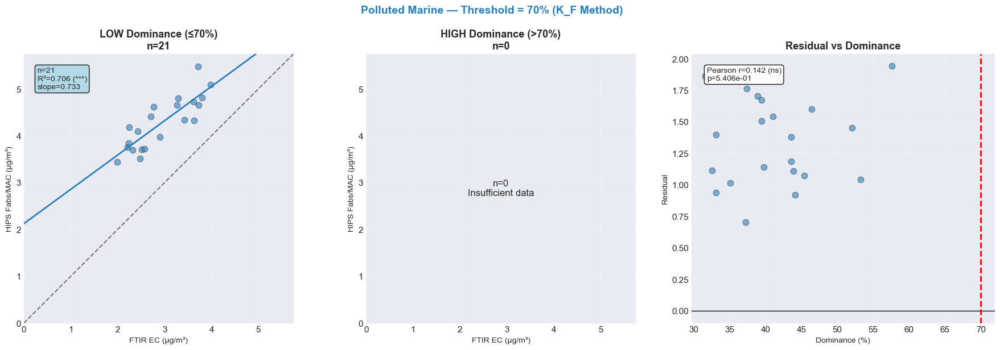


  --- Sea Salt: Skipping (n=3) ---

  Aeth IR BCc vs FTIR EC

  --- Charcoal Burning (n=41) ---


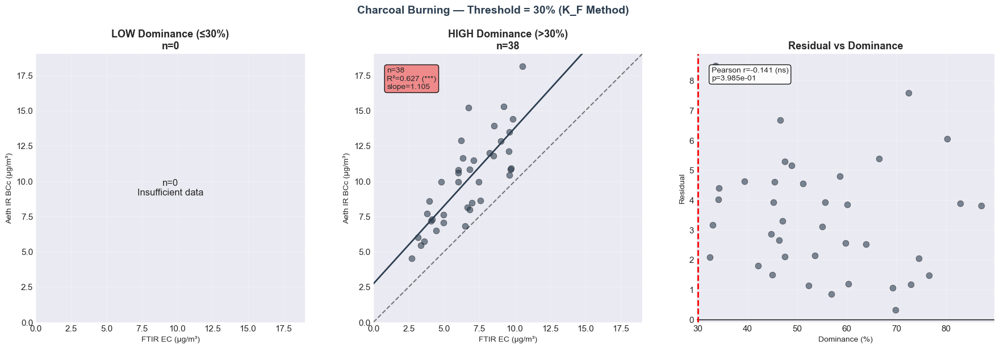

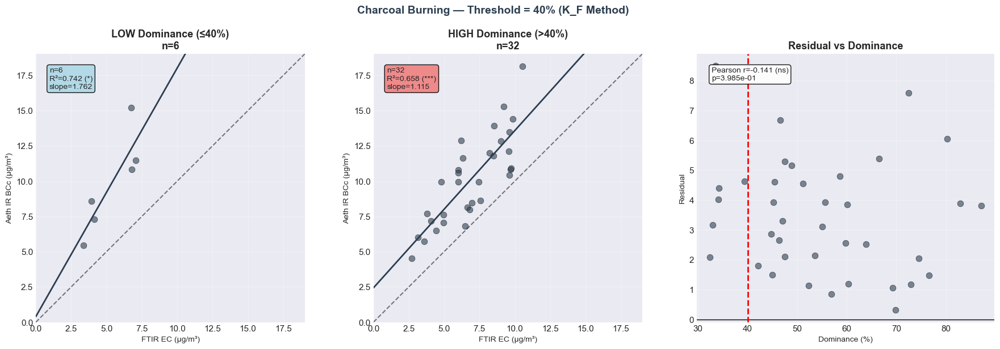

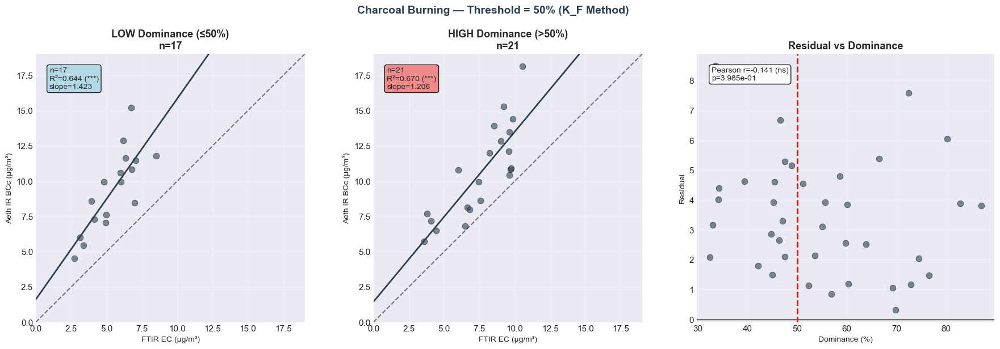

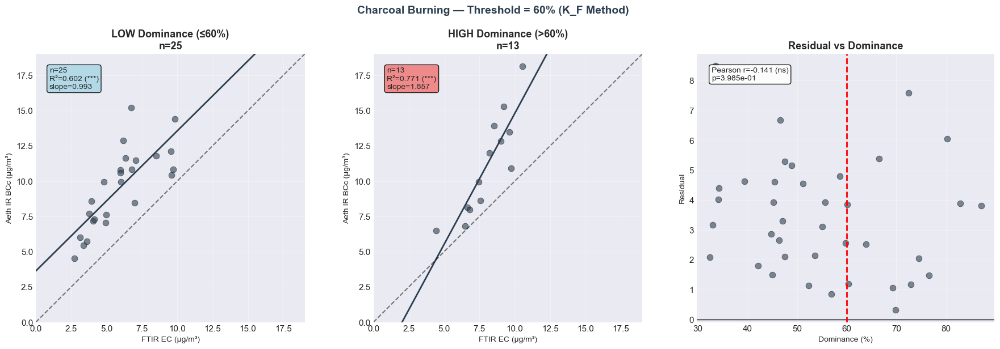

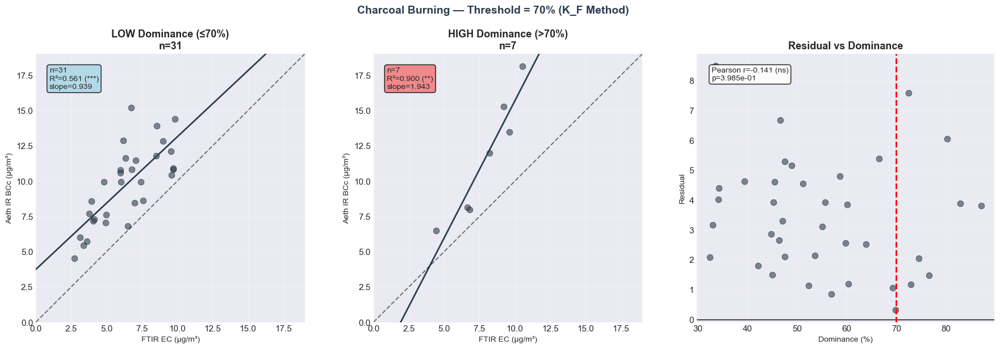


  --- Wood Burning (n=24) ---


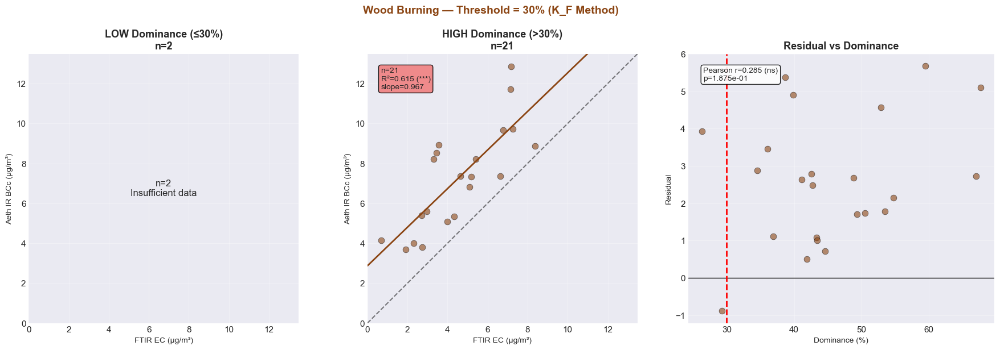

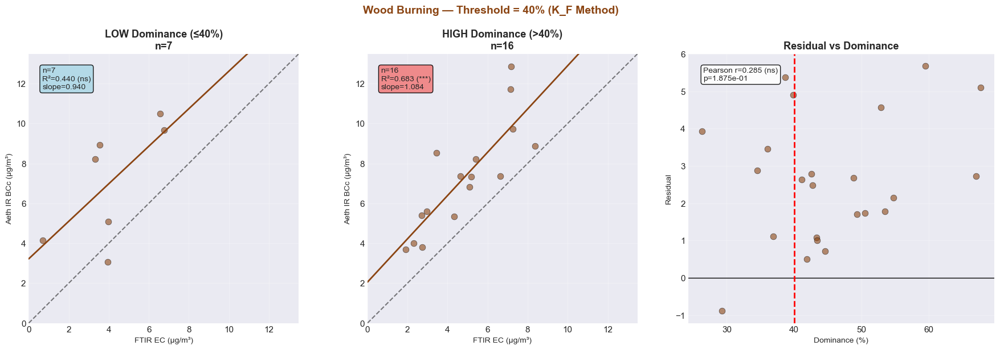

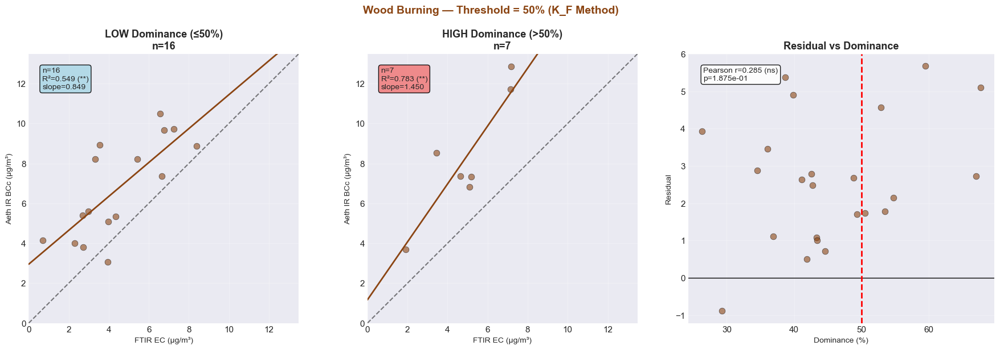

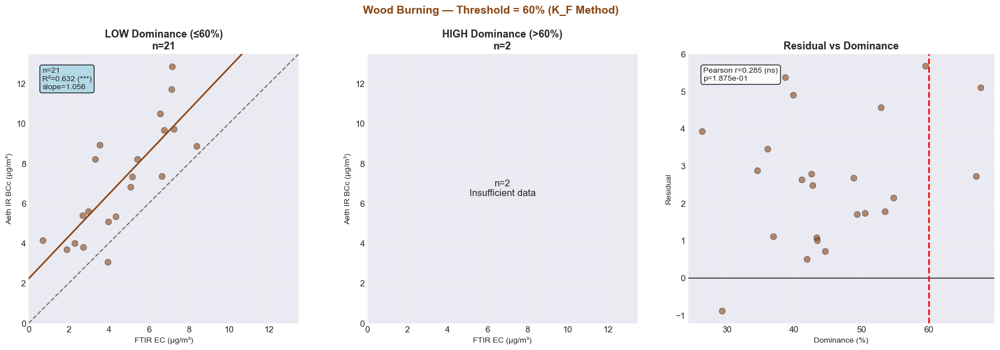

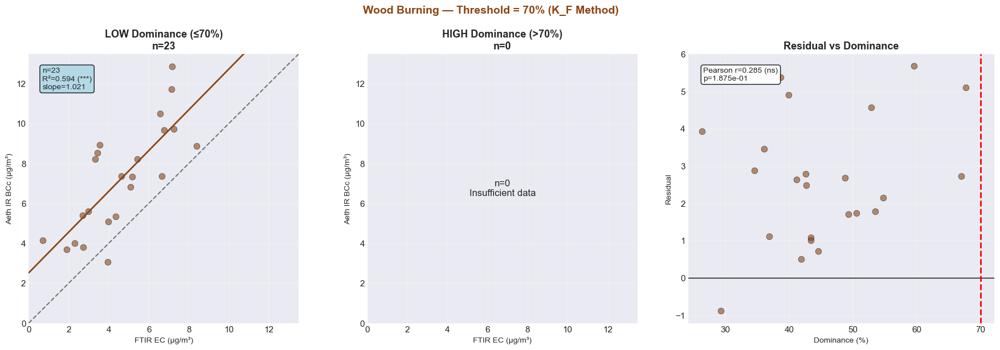


  --- Fossil Fuel (n=13) ---


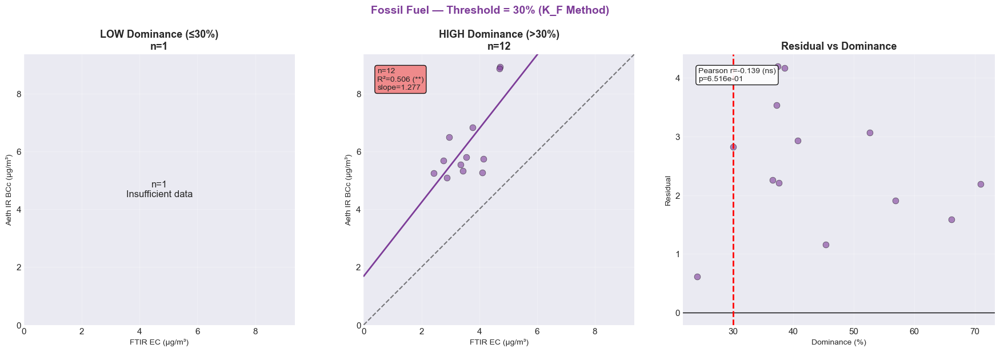

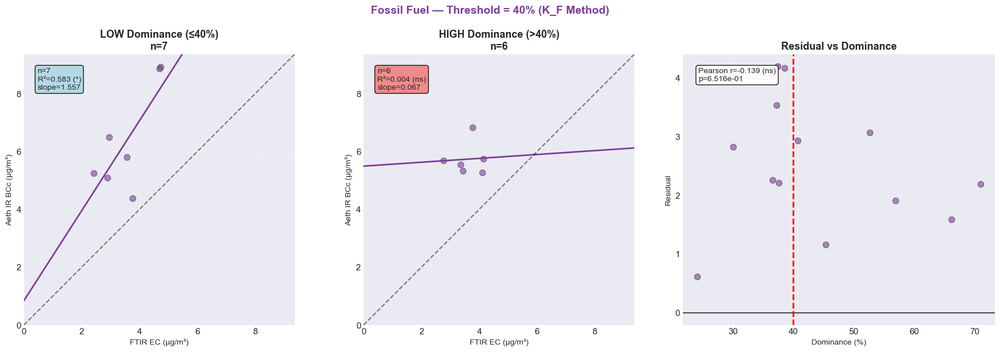

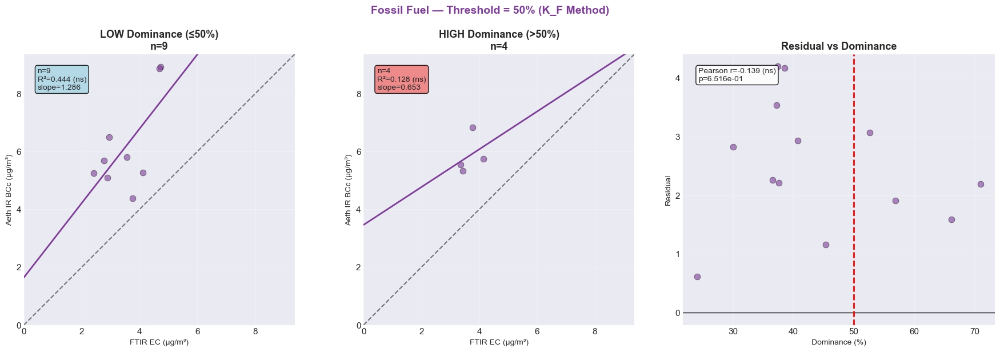

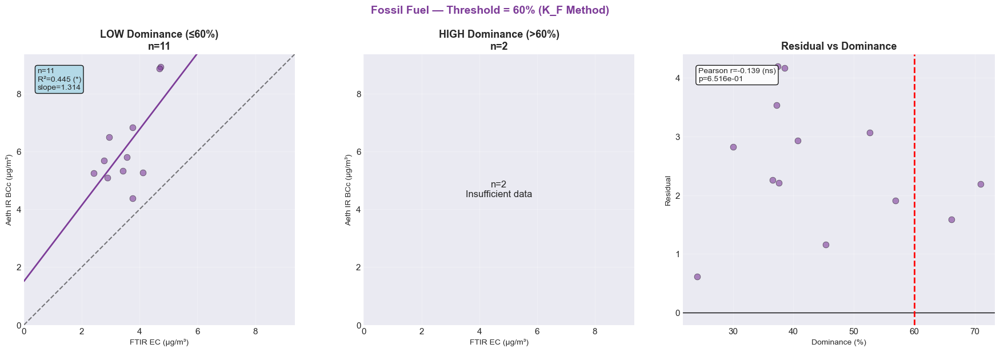

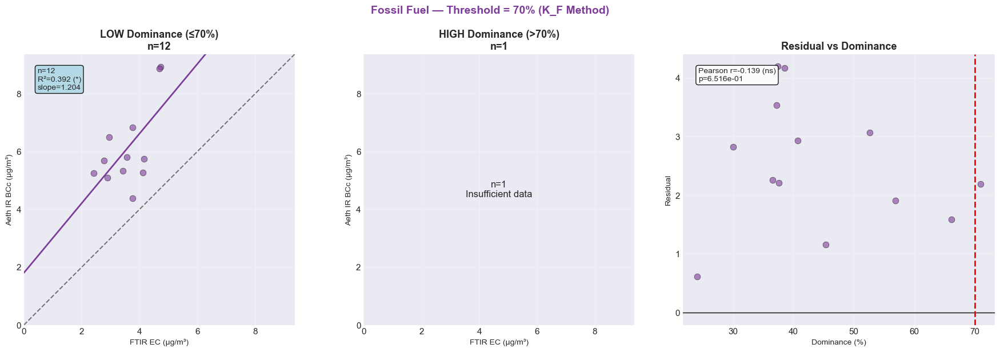


  --- Polluted Marine (n=21) ---


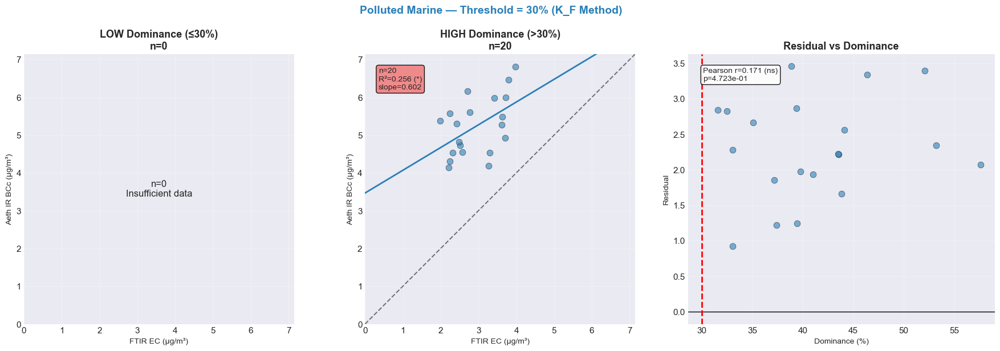

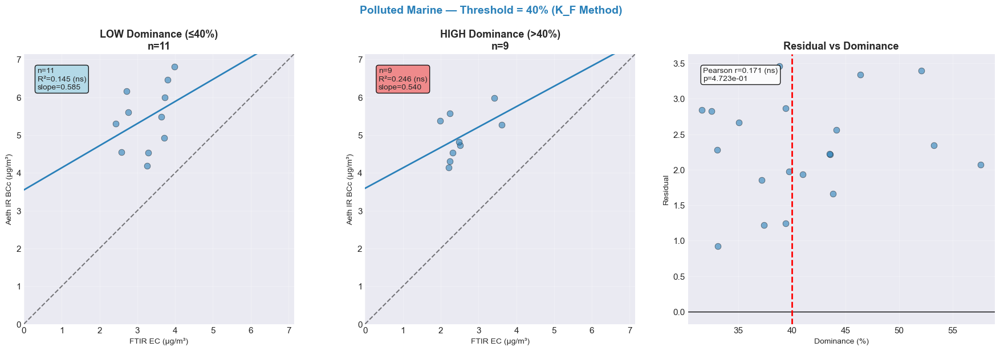

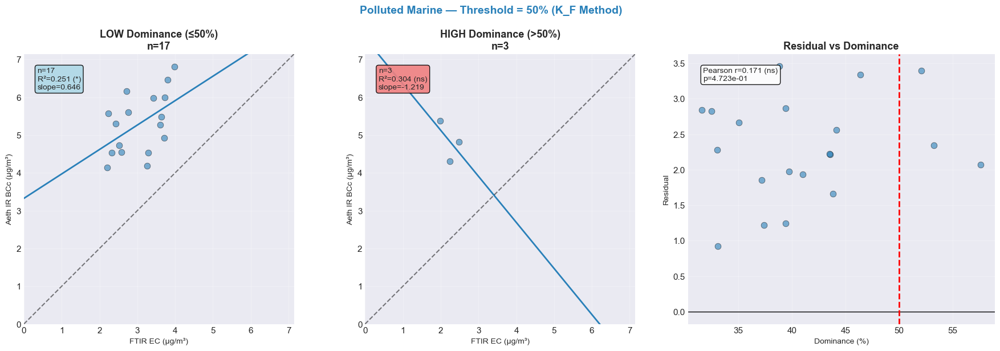

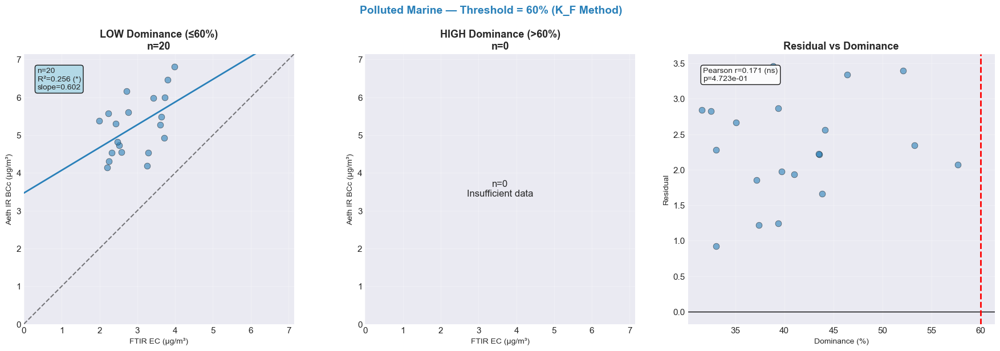

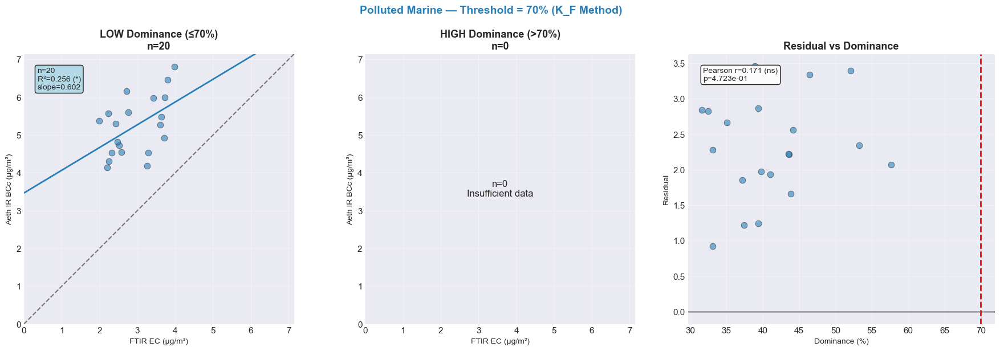


  --- Sea Salt: Skipping (n=3) ---

  Aeth IR BCc vs HIPS Fabs/MAC

  --- Charcoal Burning (n=41) ---


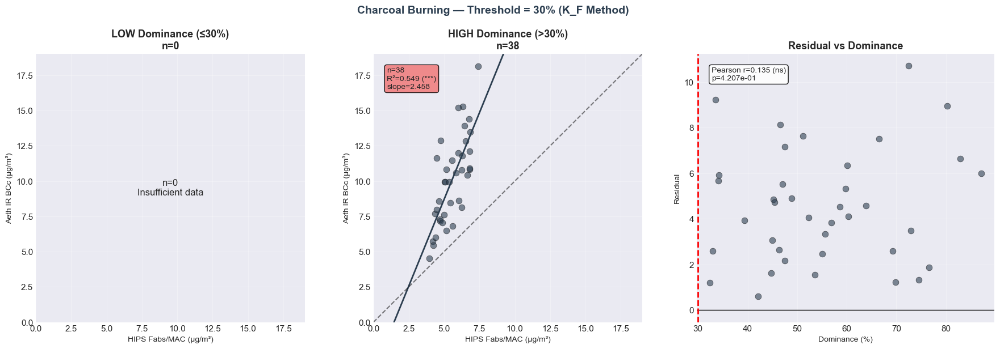

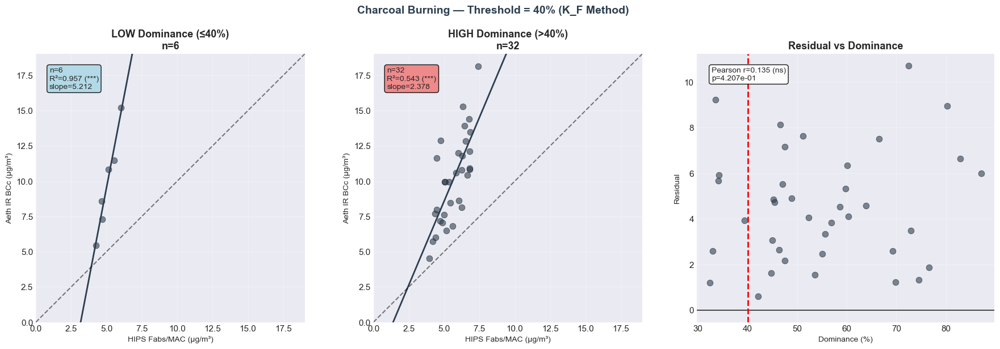

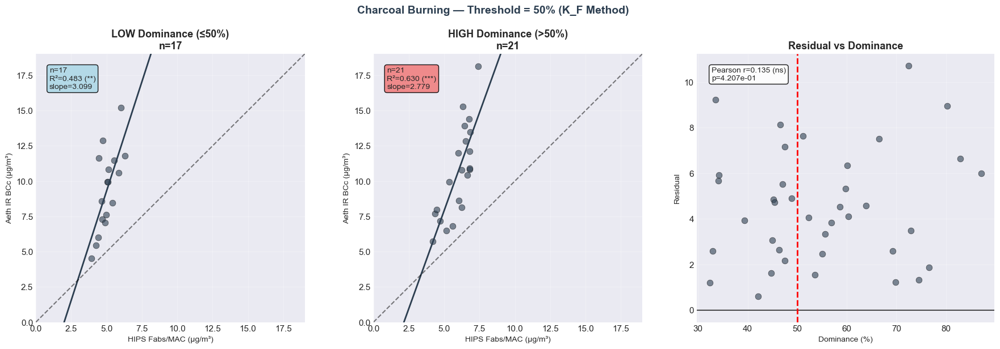

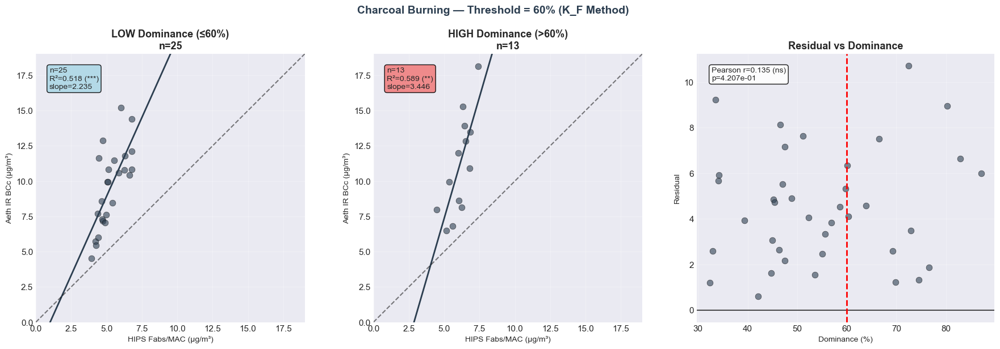

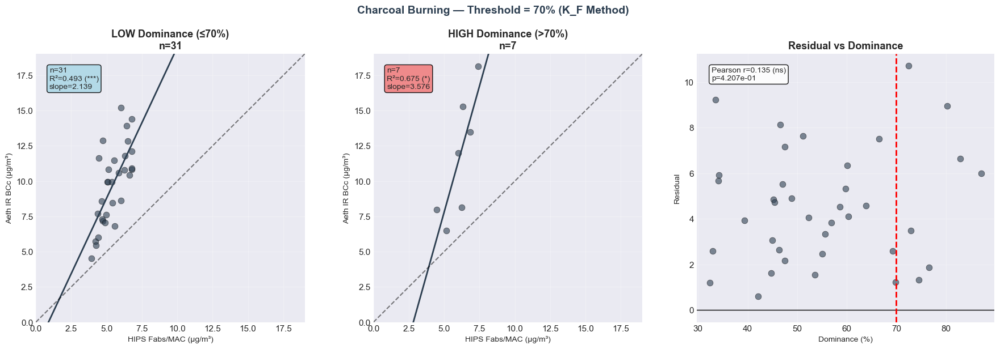


  --- Wood Burning (n=24) ---


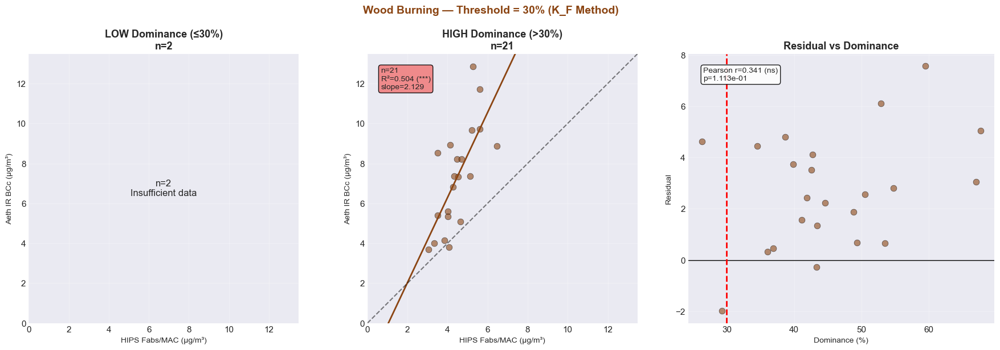

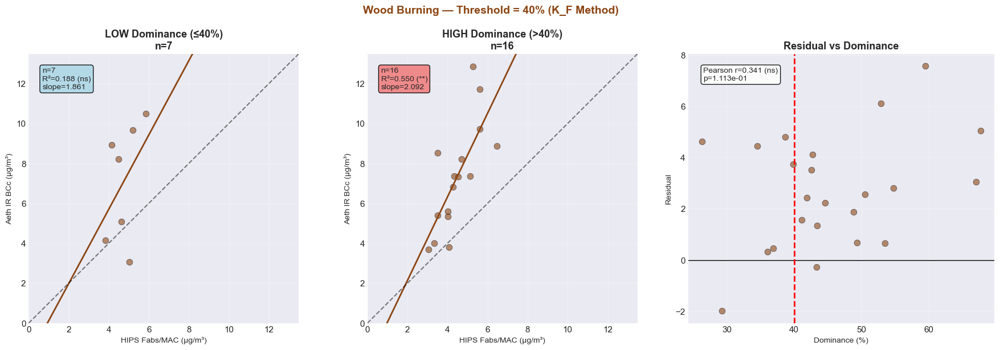

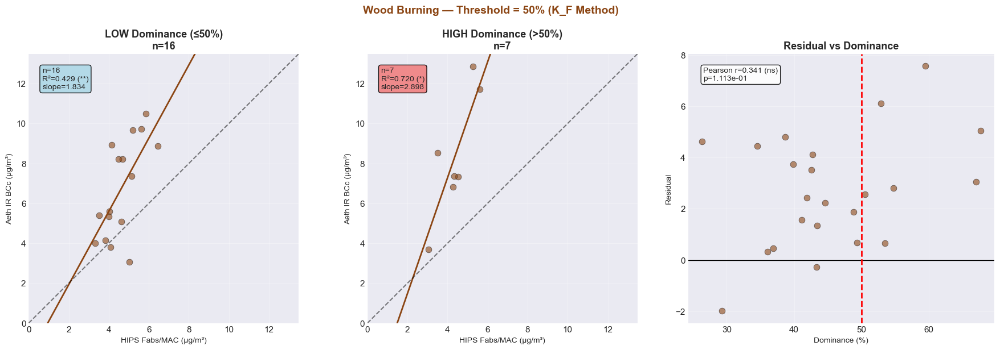

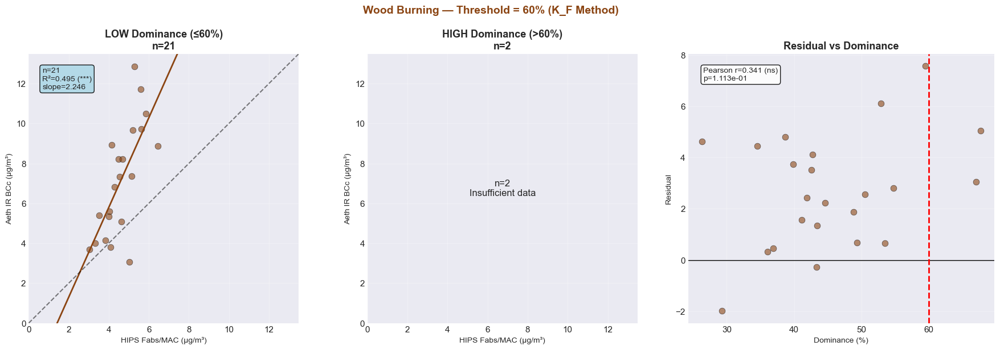

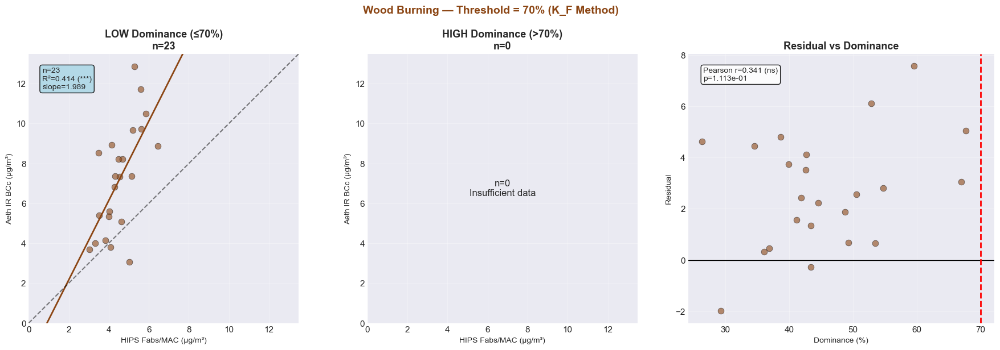


  --- Fossil Fuel (n=13) ---


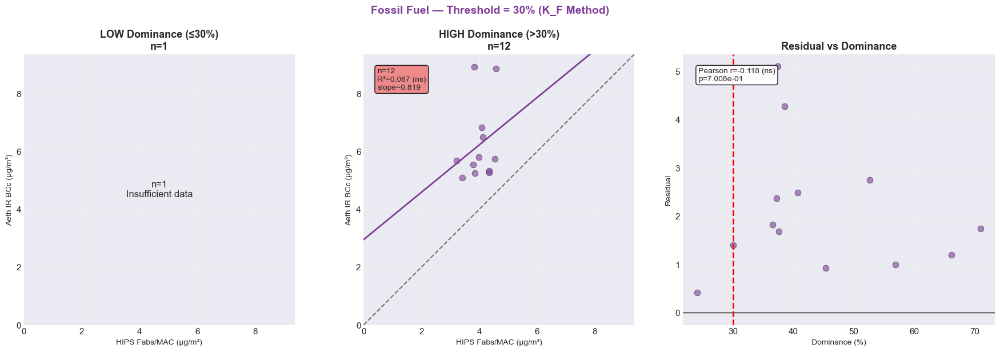

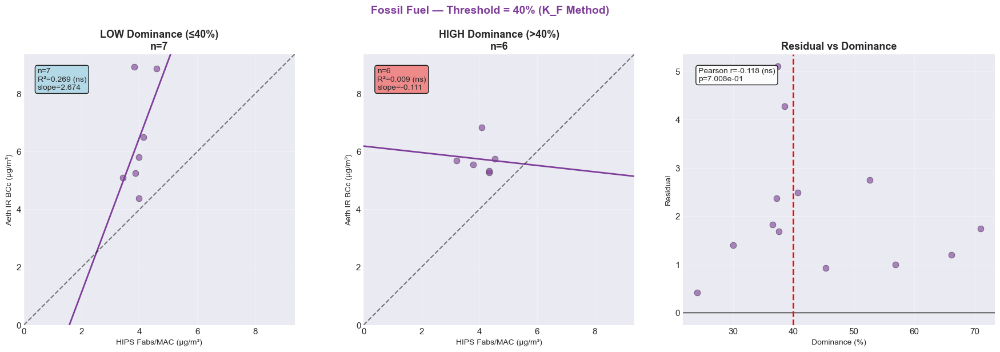

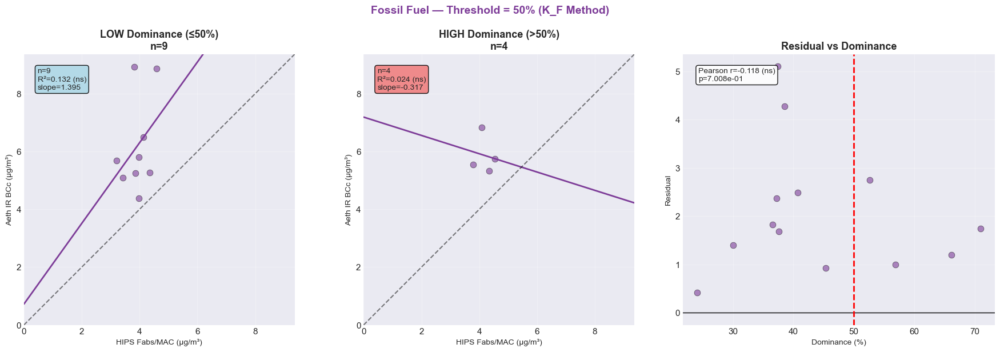

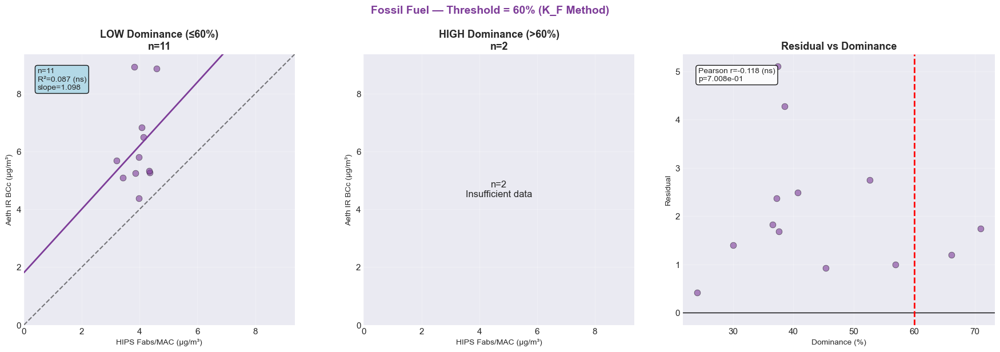

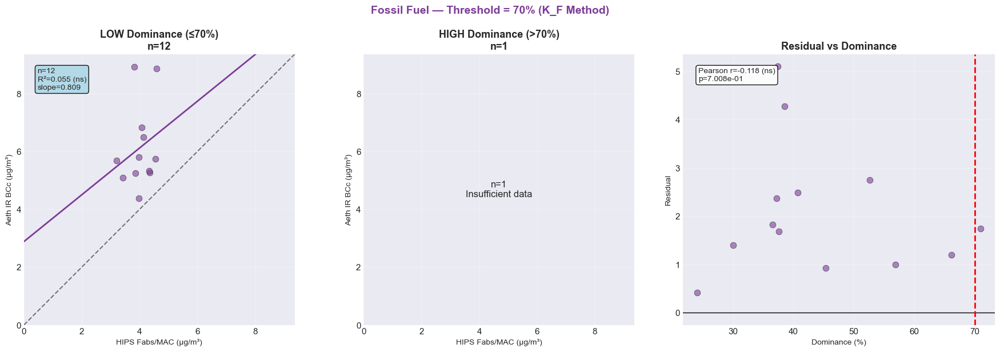


  --- Polluted Marine (n=21) ---


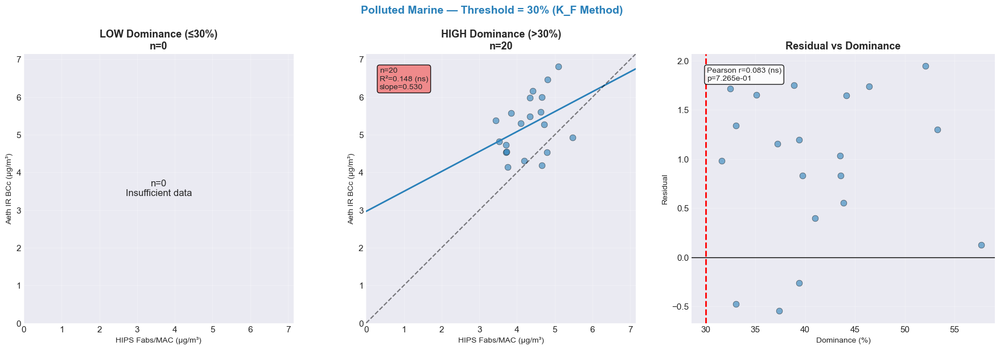

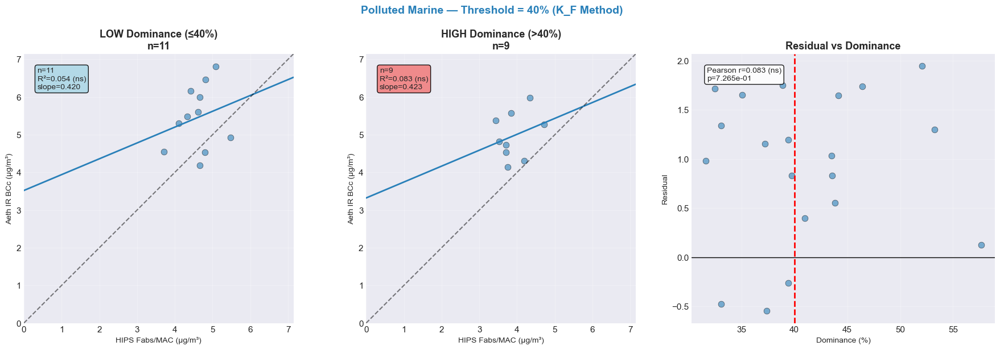

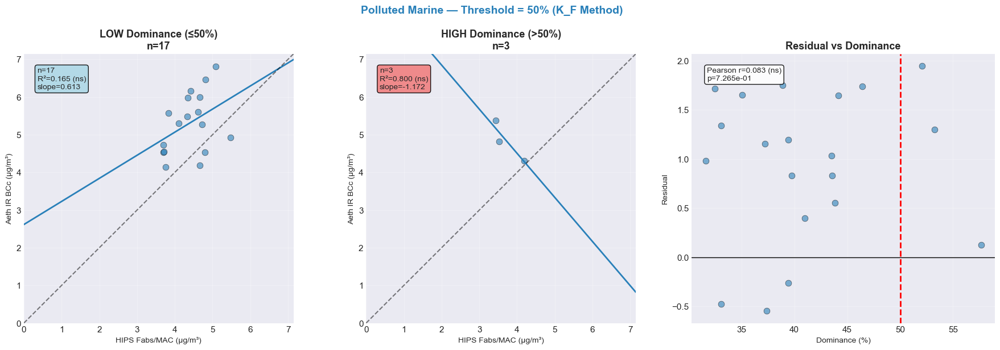

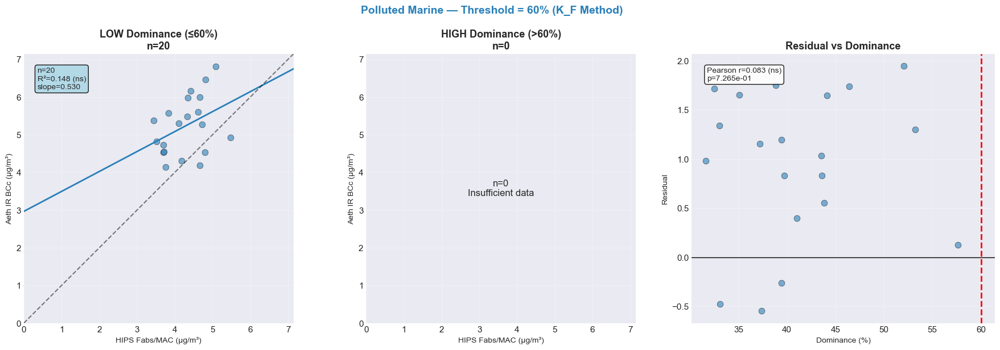

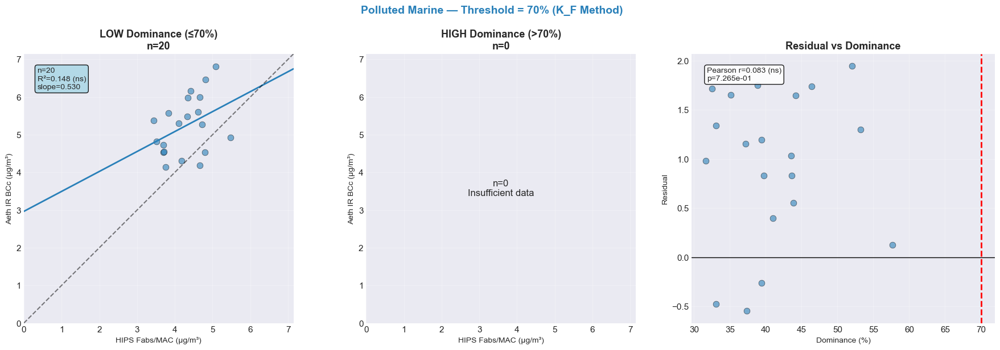


  --- Sea Salt: Skipping (n=3) ---


In [12]:
print("=" * 100)
print("SOURCE-SPECIFIC THRESHOLD ANALYSIS — K_F (CONCENTRATION) METHOD")
print("=" * 100)

# Store all source-specific results
kf_source_results = {}

for x_col, y_col, x_label, y_label, prefix in METHOD_PAIRS:
    pair_label = f'{y_label.split(" (")[0]} vs {x_label.split(" (")[0]}'
    kf_source_results[prefix] = {}
    
    print(f"\n{'='*100}")
    print(f"  {pair_label}")
    print(f"{'='*100}")
    
    for source in SOURCE_ORDER:
        source_label = SOURCE_CATEGORIES[source]['label']
        kf_source_results[prefix][source] = {}
        
        # Check if we have enough data for this source
        source_mask = df['dominant_source_conc'] == source
        n_source = source_mask.sum()
        
        if n_source < 10:
            print(f"\n  --- {source_label}: Skipping (n={n_source}) ---")
            continue
        
        print(f"\n  --- {source_label} (n={n_source}) ---")
        
        for threshold in DOMINANCE_THRESHOLDS:
            results = analyze_threshold_visual_for_source(
                df, x_col, y_col, 'dominant_kf_relative', 'dominant_source_conc',
                source, threshold, x_label, y_label, 'K_F Method'
            )
            if results:
                kf_source_results[prefix][source][threshold] = results

---

# Summary Tables: Source-Specific Results

In [13]:
def print_source_specific_summary(source_results, method_name):
    """
    Print summary tables for source-specific threshold analysis.
    """
    print(f"\n{'='*120}")
    print(f"SOURCE-SPECIFIC THRESHOLD SUMMARY — {method_name}")
    print(f"{'='*120}")
    
    for prefix, sources_data in source_results.items():
        # Find the method pair label
        pair_info = [p for p in METHOD_PAIRS if p[4] == prefix][0]
        pair_label = f'{pair_info[3].split(" (")[0]} vs {pair_info[2].split(" (")[0]}'
        
        print(f"\n--- {pair_label} ---")
        print(f"{'Source':<20s} {'Threshold':<10s} │ {'Low n':<7s} {'Low R²':<9s} │ "
              f"{'High n':<7s} {'High R²':<9s} │ {'ΔR²':<9s}")
        print("-" * 95)
        
        for source in SOURCE_ORDER:
            source_label = SOURCE_CATEGORIES[source]['label'][:18]
            threshold_data = sources_data.get(source, {})
            
            if not threshold_data:
                print(f"{source_label:<20s} {'N/A':<10s} │ {'—':^7s} {'—':^9s} │ {'—':^7s} {'—':^9s} │ {'—':^9s}")
                continue
            
            for threshold in DOMINANCE_THRESHOLDS:
                results = threshold_data.get(threshold, {})
                if not results:
                    continue
                
                low = results.get('low', {})
                high = results.get('high', {})
                
                low_r2 = low.get('r2', np.nan)
                high_r2 = high.get('r2', np.nan)
                delta = low_r2 - high_r2 if not (np.isnan(low_r2) or np.isnan(high_r2)) else np.nan
                
                thresh_str = f"{threshold:.0%}"
                print(f"{source_label:<20s} {thresh_str:<10s} │ {low.get('n', 0):<7d} {low_r2:<9.3f} │ "
                      f"{high.get('n', 0):<7d} {high_r2:<9.3f} │ {delta:<+9.3f}")
            
            print("-" * 95)

# Print summaries
print_source_specific_summary(gf_source_results, 'GF (Fraction) Method')
print_source_specific_summary(kf_source_results, 'K_F (Concentration) Method')


SOURCE-SPECIFIC THRESHOLD SUMMARY — GF (Fraction) Method

--- HIPS Fabs/MAC vs FTIR EC ---
Source               Threshold  │ Low n   Low R²    │ High n  High R²   │ ΔR²      
-----------------------------------------------------------------------------------------------
Charcoal Burning     30%        │ 1       nan       │ 21      0.857     │ +nan     
Charcoal Burning     40%        │ 7       0.980     │ 15      0.694     │ +0.286   
Charcoal Burning     50%        │ 11      0.987     │ 11      0.630     │ +0.357   
Charcoal Burning     60%        │ 19      0.849     │ 3       0.850     │ -0.001   
Charcoal Burning     70%        │ 22      0.855     │ 0       nan       │ +nan     
-----------------------------------------------------------------------------------------------
Wood Burning         30%        │ 1       nan       │ 10      0.780     │ +nan     
Wood Burning         40%        │ 9       0.674     │ 2       nan       │ +nan     
Wood Burning         50%        │ 9       0.

---

# Comparison Visualization: All Sources at Representative Threshold


COMPARISON: ALL SOURCES AT 50% THRESHOLD


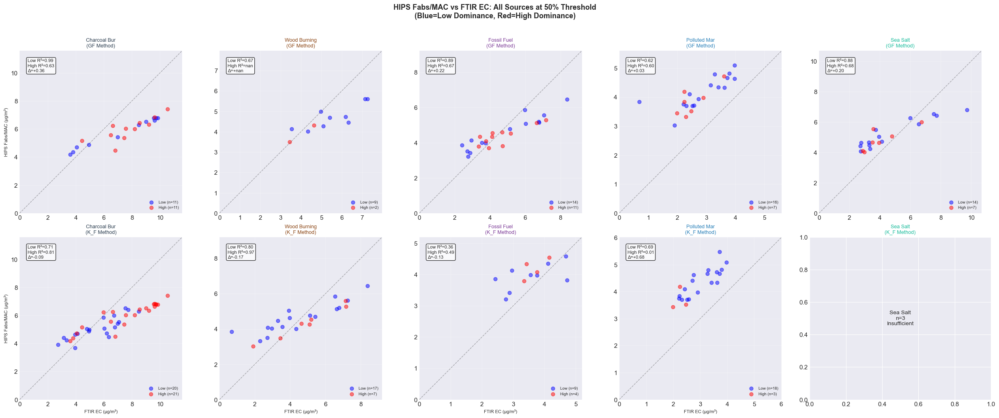

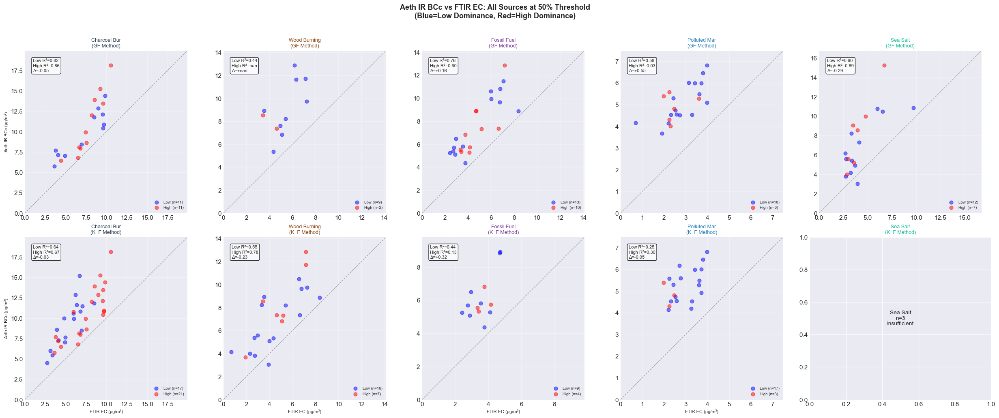

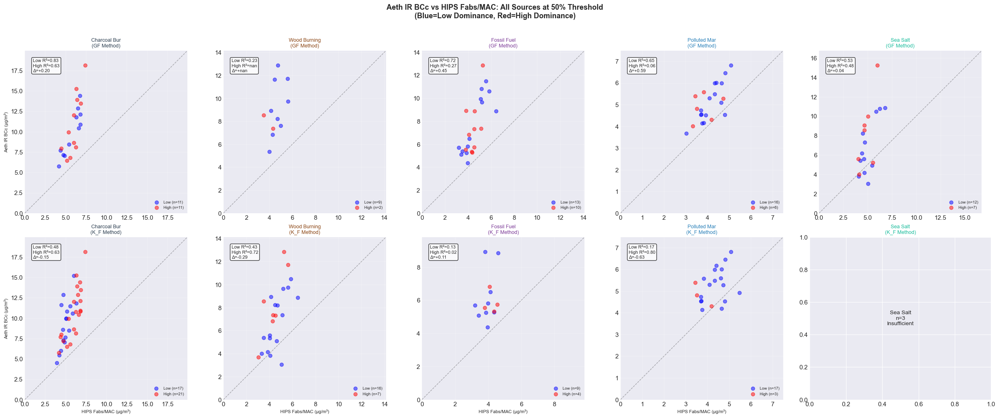

In [14]:
# Create comparison plot at 50% threshold
REPRESENTATIVE_THRESHOLD = 0.50

print(f"\n{'='*100}")
print(f"COMPARISON: ALL SOURCES AT {REPRESENTATIVE_THRESHOLD:.0%} THRESHOLD")
print(f"{'='*100}")

for x_col, y_col, x_label, y_label, prefix in METHOD_PAIRS:
    pair_label = f'{y_label.split(" (")[0]} vs {x_label.split(" (")[0]}'
    
    fig, axes = plt.subplots(2, len(SOURCE_ORDER), figsize=(5*len(SOURCE_ORDER), 10))
    
    for col_idx, source in enumerate(SOURCE_ORDER):
        source_color = SOURCE_CATEGORIES[source]['color']
        source_label = SOURCE_CATEGORIES[source]['label']
        
        for row_idx, (method_name, dominance_col, source_col, results_dict) in enumerate([
            ('GF Method', 'dominant_gf_relative', 'dominant_source_frac', gf_source_results),
            ('K_F Method', 'dominant_kf_relative', 'dominant_source_conc', kf_source_results)
        ]):
            ax = axes[row_idx, col_idx]
            
            # Get data for this source
            source_mask = df[source_col] == source
            df_source = df[source_mask].copy()
            valid_mask = df_source[x_col].notna() & df_source[y_col].notna() & df_source[dominance_col].notna()
            df_valid = df_source[valid_mask]
            
            if len(df_valid) < 5:
                ax.text(0.5, 0.5, f'{source_label[:12]}\nn={len(df_valid)}\nInsufficient',
                       transform=ax.transAxes, ha='center', va='center', fontsize=10)
                ax.set_title(f'{source_label[:12]}\n({method_name})', fontsize=9, color=source_color)
                continue
            
            # Split by threshold
            low_mask = df_valid[dominance_col] <= REPRESENTATIVE_THRESHOLD
            high_mask = df_valid[dominance_col] > REPRESENTATIVE_THRESHOLD
            
            max_val = max(df_valid[x_col].max(), df_valid[y_col].max()) * 1.1
            
            # Plot low dominance (blue) and high dominance (red)
            if low_mask.sum() > 0:
                ax.scatter(df_valid.loc[low_mask, x_col], df_valid.loc[low_mask, y_col],
                          c='blue', alpha=0.5, s=40, label=f'Low (n={low_mask.sum()})')
            if high_mask.sum() > 0:
                ax.scatter(df_valid.loc[high_mask, x_col], df_valid.loc[high_mask, y_col],
                          c='red', alpha=0.5, s=40, label=f'High (n={high_mask.sum()})')
            
            ax.plot([0, max_val], [0, max_val], 'k--', alpha=0.3, linewidth=1)
            
            # Get results
            results = results_dict.get(prefix, {}).get(source, {}).get(REPRESENTATIVE_THRESHOLD, {})
            if results:
                low = results.get('low', {})
                high = results.get('high', {})
                low_r2 = low.get('r2', np.nan)
                high_r2 = high.get('r2', np.nan)
                delta = low_r2 - high_r2 if not (np.isnan(low_r2) or np.isnan(high_r2)) else np.nan
                ax.text(0.05, 0.95, f'Low R²={low_r2:.2f}\nHigh R²={high_r2:.2f}\nΔ={delta:+.2f}',
                        transform=ax.transAxes, fontsize=8, va='top',
                        bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
            
            ax.set_xlim(0, max_val)
            ax.set_ylim(0, max_val)
            ax.set_aspect('equal')
            ax.grid(True, alpha=0.3)
            ax.legend(fontsize=7, loc='lower right')
            
            if row_idx == 1:
                ax.set_xlabel(x_label, fontsize=8)
            if col_idx == 0:
                ax.set_ylabel(y_label, fontsize=8)
            
            ax.set_title(f'{source_label[:12]}\n({method_name})', fontsize=9, color=source_color)
    
    plt.suptitle(f'{pair_label}: All Sources at {REPRESENTATIVE_THRESHOLD:.0%} Threshold\n(Blue=Low Dominance, Red=High Dominance)',
                 fontsize=13, fontweight='bold', y=1.02)
    plt.tight_layout()
    plt.savefig(os.path.join(dirs['plots'], f'source_comparison_{prefix}_{int(REPRESENTATIVE_THRESHOLD*100)}pct.png'),
                dpi=150, bbox_inches='tight')
    plt.show()

---

# Export Results

In [15]:
# Compile all results into DataFrames for export

# 1. Overall threshold results
overall_data = []
for prefix in [p[4] for p in METHOD_PAIRS]:
    pair_info = [p for p in METHOD_PAIRS if p[4] == prefix][0]
    pair_name = f'{pair_info[3].split(" (")[0]} vs {pair_info[2].split(" (")[0]}'
    
    for threshold in DOMINANCE_THRESHOLDS:
        # GF results
        gf_t = gf_threshold_results.get(prefix, {}).get(threshold, {})
        if gf_t:
            overall_data.append({
                'Method_Pair': pair_name, 'Prefix': prefix, 'Dominance_Method': 'GF',
                'Source': 'ALL', 'Threshold': threshold,
                'Low_n': gf_t.get('low', {}).get('n'),
                'Low_R2': gf_t.get('low', {}).get('r2'),
                'Low_Slope': gf_t.get('low', {}).get('slope'),
                'High_n': gf_t.get('high', {}).get('n'),
                'High_R2': gf_t.get('high', {}).get('r2'),
                'High_Slope': gf_t.get('high', {}).get('slope'),
                'Residual_Corr': gf_t.get('residual_corr'),
            })
        
        # KF results
        kf_t = kf_threshold_results.get(prefix, {}).get(threshold, {})
        if kf_t:
            overall_data.append({
                'Method_Pair': pair_name, 'Prefix': prefix, 'Dominance_Method': 'KF',
                'Source': 'ALL', 'Threshold': threshold,
                'Low_n': kf_t.get('low', {}).get('n'),
                'Low_R2': kf_t.get('low', {}).get('r2'),
                'Low_Slope': kf_t.get('low', {}).get('slope'),
                'High_n': kf_t.get('high', {}).get('n'),
                'High_R2': kf_t.get('high', {}).get('r2'),
                'High_Slope': kf_t.get('high', {}).get('slope'),
                'Residual_Corr': kf_t.get('residual_corr'),
            })

# 2. Source-specific results
source_specific_data = []
for prefix in [p[4] for p in METHOD_PAIRS]:
    pair_info = [p for p in METHOD_PAIRS if p[4] == prefix][0]
    pair_name = f'{pair_info[3].split(" (")[0]} vs {pair_info[2].split(" (")[0]}'
    
    for source in SOURCE_ORDER:
        for threshold in DOMINANCE_THRESHOLDS:
            # GF results
            gf_t = gf_source_results.get(prefix, {}).get(source, {}).get(threshold, {})
            if gf_t:
                source_specific_data.append({
                    'Method_Pair': pair_name, 'Prefix': prefix, 'Dominance_Method': 'GF',
                    'Source': SOURCE_CATEGORIES[source]['label'], 'Threshold': threshold,
                    'Low_n': gf_t.get('low', {}).get('n'),
                    'Low_R2': gf_t.get('low', {}).get('r2'),
                    'Low_Slope': gf_t.get('low', {}).get('slope'),
                    'High_n': gf_t.get('high', {}).get('n'),
                    'High_R2': gf_t.get('high', {}).get('r2'),
                    'High_Slope': gf_t.get('high', {}).get('slope'),
                    'Residual_Corr': gf_t.get('residual_corr'),
                })
            
            # KF results
            kf_t = kf_source_results.get(prefix, {}).get(source, {}).get(threshold, {})
            if kf_t:
                source_specific_data.append({
                    'Method_Pair': pair_name, 'Prefix': prefix, 'Dominance_Method': 'KF',
                    'Source': SOURCE_CATEGORIES[source]['label'], 'Threshold': threshold,
                    'Low_n': kf_t.get('low', {}).get('n'),
                    'Low_R2': kf_t.get('low', {}).get('r2'),
                    'Low_Slope': kf_t.get('low', {}).get('slope'),
                    'High_n': kf_t.get('high', {}).get('n'),
                    'High_R2': kf_t.get('high', {}).get('r2'),
                    'High_Slope': kf_t.get('high', {}).get('slope'),
                    'Residual_Corr': kf_t.get('residual_corr'),
                })

# Combine and save
all_results = overall_data + source_specific_data
results_df = pd.DataFrame(all_results)
results_path = os.path.join(dirs['data'], 'dominance_threshold_analysis_all_results.csv')
results_df.to_csv(results_path, index=False)
print(f"Saved all threshold analysis results to: {results_path}")

# Save merged dataset
df_path = os.path.join(dirs['data'], 'bc_ec_with_dominance_metrics.csv')
df.to_csv(df_path, index=False)
print(f"Saved merged dataset to: {df_path}")

print(f"\nTotal results exported: {len(results_df)} rows")
print(f"  - Overall results: {len(overall_data)}")
print(f"  - Source-specific results: {len(source_specific_data)}")

Saved all threshold analysis results to: output/data/addis_ababa/dominance_threshold_analysis_all_results.csv
Saved merged dataset to: output/data/addis_ababa/bc_ec_with_dominance_metrics.csv

Total results exported: 165 rows
  - Overall results: 30
  - Source-specific results: 135


---

# Key Findings Summary

In [16]:
print("\n" + "=" * 100)
print("KEY FINDINGS SUMMARY")
print("=" * 100)

print("""
This notebook applied threshold analysis to dominant source relative fraction/concentration,
testing whether samples with stronger source dominance show different BC/EC regression behavior.

ANALYSES PERFORMED:

1. OVERALL THRESHOLD ANALYSIS (All samples):
   - Tested thresholds: 30%, 40%, 50%, 60%, 70%
   - For both GF (Fraction) and K_F (Concentration) methods
   - Across all three method pairs (HIPS vs EC, Aeth vs EC, Aeth vs HIPS)

2. SOURCE-SPECIFIC THRESHOLD ANALYSIS:
   - Same threshold analysis performed WITHIN each dominant source:
     • Charcoal Burning
     • Wood Burning  
     • Fossil Fuel
     • Polluted Marine
     • Sea Salt
   - This reveals if threshold effects are consistent across source types

INTERPRETATION:

- ΔR² = R²(low dominance) - R²(high dominance)
- Positive ΔR²: Samples with mixed sources (low dominance) have better method agreement
- Negative ΔR²: Samples dominated by one source have better method agreement
- Near-zero ΔR²: Dominance level doesn't strongly affect method agreement

PRACTICAL IMPLICATIONS:

- If certain sources show consistently negative ΔR² (high dominance = better agreement),
  those sources may have more consistent optical properties for BC measurement
  
- If certain sources show consistently positive ΔR² (low dominance = better agreement),
  mixing may average out source-specific measurement biases

- Comparing GF vs K_F methods shows sensitivity to how dominance is calculated
""")

print(f"\nPlots saved to: {dirs['plots']}")
print(f"Data saved to: {dirs['data']}")


KEY FINDINGS SUMMARY

This notebook applied threshold analysis to dominant source relative fraction/concentration,
testing whether samples with stronger source dominance show different BC/EC regression behavior.

ANALYSES PERFORMED:

1. OVERALL THRESHOLD ANALYSIS (All samples):
   - Tested thresholds: 30%, 40%, 50%, 60%, 70%
   - For both GF (Fraction) and K_F (Concentration) methods
   - Across all three method pairs (HIPS vs EC, Aeth vs EC, Aeth vs HIPS)

2. SOURCE-SPECIFIC THRESHOLD ANALYSIS:
   - Same threshold analysis performed WITHIN each dominant source:
     • Charcoal Burning
     • Wood Burning  
     • Fossil Fuel
     • Polluted Marine
     • Sea Salt
   - This reveals if threshold effects are consistent across source types

INTERPRETATION:

- ΔR² = R²(low dominance) - R²(high dominance)
- Positive ΔR²: Samples with mixed sources (low dominance) have better method agreement
- Negative ΔR²: Samples dominated by one source have better method agreement
- Near-zero ΔR²: Domin